# XYZ bins

In [1]:
# Ok. I want to separate events into 3x3 xy bins and 5 z bins, then for each bin, generate a plot
# of PMT data / PMT MC for each PMT.
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
from invisible_cities.database import load_db
sipm_info = load_db.DataSiPM('new', -6400)

In [3]:
import time
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = 10, 8
plt.rcParams["font.size"     ] = 14
from invisible_cities.io.pmaps_io import load_pmaps

In [4]:
def four_digit(i):
    j = str(i)
    while len(j) < 4:
        j = '0'+j
    return j

In [5]:
# The normal MC location should be from now on '/Volumes/NEXT_data/IC_Data/simulation'. Remember
# when moving over data to look at irene outputs, even if you have to go up a few directories
# to find it.

# all_pmaps = ['/Volumes/NEXT_data/IC_Data/kdst/nexus_newKr_pmaps_NEW/new.kr83m.pmaps.'+str(i)+'.h5' for i in range(1, 501)]

# Run, offset, num_files
run_number = 7851
offset = 0
num_files = 40
data_pmaps_files = ['/Volumes/NEXT_data/IC_Data/pmaps/'+str(run_number)+'/pmaps_'+four_digit(i)+'_'+str(run_number)+'_trigger1_v1.2.0_20191122_krbg1600.h5' for i in range(offset, offset + num_files)] # 20 is chosen because using all would take hours to read in

# 20200427. Flat 50% reflectance. No PEDOT. IRENE, NOT HYPATHIA!
# mc_date = '20200427'
# num_files_mc = 500 # 500 max
# mc_pmaps_files = ['/Volumes/NEXT_data/IC_Data/simulation/20200427/new.kr83m.pmaps.'+str(i)+'.h5' for i in range(1, 1 + num_files_mc)]

# 20200430. 10% blue light, 0% VUV
mc_date = '20200430'
mc_pmaps_files = ['/Volumes/NEXT_data/IC_Data/pmaps/mc20200430/new.kr83m.hypathia.'+str(i)+'.h5' for i in range(1, 501)]

# 20200429
# mc_date = '20200429'
# mc_pmaps_files = ['/Volumes/NEXT_data/IC_Data/pmaps/mc'+mc_date+'/new.kr83m.hypathia.'+str(i)+'.h5' for i in range(1, 501)]

In [6]:
def read_in_good_pmaps(myallpmaps):
    t0 = time.time()
    print('Loading', myallpmaps[0], 'to', myallpmaps[-1])
    my_pmaps = [load_pmaps(pmap_file) for pmap_file in myallpmaps]
    print('Time to load', len(my_pmaps), 'pmaps =', time.time() - t0)
    my_pmaps = reindex(my_pmaps)
    s1s2selection(my_pmaps)
    return my_pmaps


In [7]:
def reindex(pmaps_list):    
    event_total = 0
    reindexed_pmaps = {}
    for i in range(len(pmaps_list)):
        keys = list(pmaps_list[i].keys())
        for k in keys:
            reindexed_pmaps[event_total] = pmaps_list[i][k]
            event_total += 1
    return reindexed_pmaps.copy()


In [8]:
def s1s2selection(pmaps_list):
    print('Num events before selection =', len(pmaps_list))
    bad_keys = []

    for k in pmaps_list.keys():
        if not len(pmaps_list[k].s1s) == 1:
            bad_keys.append(k)
        elif not len(pmaps_list[k].s2s) == 1:
            bad_keys.append(k)
        elif len(pmaps_list[k].s2s[0].sipms.ids) == 0:
            bad_keys.append(k)
            print(k, 'HAS NO SIPM RESPONSE')
        
    for k in bad_keys:
        del pmaps_list[k]

    print('Num events after selection =', len(pmaps_list))

In [9]:
good_data_pmaps = read_in_good_pmaps(data_pmaps_files)

Loading /Volumes/NEXT_data/IC_Data/pmaps/7851/pmaps_0000_7851_trigger1_v1.2.0_20191122_krbg1600.h5 to /Volumes/NEXT_data/IC_Data/pmaps/7851/pmaps_0039_7851_trigger1_v1.2.0_20191122_krbg1600.h5
Time to load 40 pmaps = 149.4880609512329
Num events before selection = 12416
Num events after selection = 9454


In [10]:
good_mc_pmaps = read_in_good_pmaps(mc_pmaps_files)

Loading /Volumes/NEXT_data/IC_Data/pmaps/mc20200430/new.kr83m.hypathia.1.h5 to /Volumes/NEXT_data/IC_Data/pmaps/mc20200430/new.kr83m.hypathia.500.h5
Time to load 500 pmaps = 598.7351031303406
Num events before selection = 49960
Num events after selection = 28088


In [11]:
dir(good_mc_pmaps[1])

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 's1s',
 's2s']

In [12]:
good_mc_pmaps[1].s2s[0].pmts.sum_over_times


array([450., 446., 488., 285., 295., 259., 257., 294., 310., 277., 284.,
       276.], dtype=float32)

In [13]:
[356.1755 , 380.5779 , 360.59048, 264.4233 , 285.9367 , 287.139  ,
       271.8481 , 236.09988, 277.58508, 294.71216, 316.40634, 281.36475]

[356.1755,
 380.5779,
 360.59048,
 264.4233,
 285.9367,
 287.139,
 271.8481,
 236.09988,
 277.58508,
 294.71216,
 316.40634,
 281.36475]

In [14]:
e1_hypathia = np.array([356.1755,  380.5779,  360.59048, 264.4233,  285.9367,  287.139,   271.8481, 236.09988, 277.58508, 294.71216, 316.40634, 281.36475])
e1_nexus = np.array([363.0, 406.0, 381.0, 357.0, 330.0, 298.0, 354.0, 334.0, 311.0, 303.0, 340.0, 380.0])
print(np.mean(e1_nexus / e1_hypathia))

1.1645894933645653


In [15]:
good_mc_pmaps.keys()

dict_keys([0, 1, 2, 6, 7, 8, 10, 11, 13, 15, 16, 19, 20, 23, 24, 25, 30, 31, 32, 33, 35, 36, 38, 39, 45, 46, 48, 50, 52, 54, 57, 59, 61, 63, 66, 67, 70, 71, 72, 73, 75, 76, 78, 79, 80, 81, 82, 83, 84, 87, 88, 89, 90, 92, 98, 99, 100, 101, 102, 103, 104, 106, 107, 108, 110, 111, 114, 118, 119, 120, 121, 122, 123, 124, 125, 127, 128, 129, 130, 131, 132, 134, 135, 136, 137, 138, 140, 143, 145, 146, 147, 148, 149, 151, 152, 153, 154, 155, 156, 158, 159, 161, 163, 166, 167, 170, 172, 173, 174, 176, 177, 178, 179, 180, 184, 185, 187, 189, 190, 192, 193, 194, 195, 196, 198, 200, 201, 203, 204, 205, 207, 208, 210, 211, 213, 214, 217, 220, 222, 223, 224, 227, 228, 231, 232, 234, 235, 236, 240, 242, 243, 244, 245, 248, 249, 253, 254, 255, 257, 259, 262, 264, 266, 267, 268, 271, 274, 277, 278, 281, 284, 285, 288, 289, 291, 293, 294, 295, 297, 298, 299, 300, 303, 306, 308, 310, 311, 317, 319, 322, 324, 327, 329, 330, 331, 332, 333, 334, 337, 339, 344, 346, 347, 348, 351, 352, 359, 360, 362, 363, 3

In [16]:
good_mc_pmaps[1].s2s[0].total_energy

3921.0

In [17]:
sum(good_mc_pmaps[1].s2s[0].pmts.sum_over_times)

3921.0

In [18]:
good_mc_pmaps[1].s1s[0].total_energy

7.0

In [19]:
sum(good_mc_pmaps[1].s1s[0].pmts.sum_over_times)

7.0

In [20]:
hypathia_evts = {}
hypathia_evts_s1 = {}
hypathia_sums = {}

for k in good_mc_pmaps.keys():
    
    if k < 100:
        hypathia_evts[k] = np.array(good_mc_pmaps[k].s2s[0].pmts.sum_over_times)
        hypathia_sums[k] = np.sum(hypathia_evts[k])
        hypathia_evts_s1[k] = np.array(good_mc_pmaps[k].s1s[0].pmts.sum_over_times)

    if k < 10:
        print('EVENT ', k)
        print(good_mc_pmaps[k].s2s[0].pmts.sum_over_times)
        
        


EVENT  0
[394. 367. 358. 279. 262. 285. 287. 261. 268. 232. 278. 305.]
EVENT  1
[450. 446. 488. 285. 295. 259. 257. 294. 310. 277. 284. 276.]
EVENT  2
[395. 370. 355. 259. 271. 314. 269. 265. 304. 272. 246. 291.]
EVENT  6
[339. 325. 358. 303. 271. 267. 315. 290. 237. 244. 249. 285.]
EVENT  7
[392. 351. 374. 243. 261. 280. 301. 280. 271. 242. 269. 293.]
EVENT  8
[357. 366. 396. 278. 257. 309. 259. 298. 285. 248. 251. 287.]


In [21]:
# 20200427
nexus_evts = np.array([[363.0, 406.0, 381.0, 357.0, 330.0, 298.0, 354.0, 334.0, 311.0, 303.0, 340.0, 380.0],
[413.0, 432.0, 416.0, 297.0, 342.0, 336.0, 349.0, 277.0, 320.0, 352.0, 382.0, 322.0],
[405.0, 387.0, 379.0, 336.0, 305.0, 322.0, 311.0, 316.0, 313.0, 306.0, 347.0, 325.0],
[382.0, 392.0, 360.0, 327.0, 326.0, 308.0, 282.0, 345.0, 314.0, 320.0, 305.0, 302.0],
[437.0, 441.0, 531.0, 318.0, 315.0, 324.0, 333.0, 294.0, 329.0, 310.0, 305.0, 304.0],
[290.0, 301.0, 287.0, 250.0, 286.0, 292.0, 229.0, 257.0, 254.0, 264.0, 312.0, 242.0],
[367.0, 409.0, 411.0, 288.0, 304.0, 311.0, 357.0, 341.0, 293.0, 321.0, 324.0, 306.0],
[461.0, 452.0, 427.0, 296.0, 340.0, 320.0, 290.0, 343.0, 325.0, 311.0, 292.0, 291.0],
[444.0, 396.0, 367.0, 349.0, 283.0, 324.0, 306.0, 332.0, 295.0, 293.0, 302.0, 321.0],
[358.0, 337.0, 381.0, 286.0, 289.0, 353.0, 312.0, 311.0, 319.0, 376.0, 282.0, 301.0],
[333.0, 319.0, 342.0, 340.0, 290.0, 247.0, 264.0, 286.0, 371.0, 322.0, 318.0, 335.0],
[378.0, 414.0, 370.0, 299.0, 328.0, 332.0, 305.0, 335.0, 333.0, 310.0, 305.0, 330.0],
[436.0, 478.0, 509.0, 307.0, 306.0, 310.0, 292.0, 330.0, 301.0, 314.0, 321.0, 326.0],
[293.0, 298.0, 285.0, 256.0, 261.0, 205.0, 213.0, 212.0, 247.0, 291.0, 231.0, 234.0],
[381.0, 394.0, 422.0, 319.0, 328.0, 355.0, 303.0, 308.0, 320.0, 364.0, 334.0, 284.0],
[488.0, 436.0, 502.0, 342.0, 305.0, 309.0, 334.0, 341.0, 363.0, 285.0, 301.0, 338.0],
[462.0, 511.0, 439.0, 318.0, 325.0, 304.0, 302.0, 312.0, 341.0, 333.0, 330.0, 297.0],
[435.0, 445.0, 414.0, 337.0, 341.0, 298.0, 365.0, 335.0, 309.0, 373.0, 313.0, 327.0],
[452.0, 577.0, 510.0, 329.0, 348.0, 290.0, 356.0, 346.0, 345.0, 298.0, 320.0, 312.0],
[448.0, 452.0, 486.0, 298.0, 317.0, 327.0, 306.0, 334.0, 320.0, 309.0, 324.0, 302.0],
[353.0, 396.0, 401.0, 268.0, 275.0, 306.0, 316.0, 352.0, 300.0, 292.0, 306.0, 320.0],
[320.0, 278.0, 314.0, 297.0, 249.0, 292.0, 299.0, 260.0, 230.0, 243.0, 248.0, 269.0],
[488.0, 475.0, 467.0, 340.0, 361.0, 350.0, 315.0, 316.0, 306.0, 314.0, 307.0, 310.0],
[369.0, 365.0, 372.0, 319.0, 324.0, 299.0, 306.0, 311.0, 308.0, 322.0, 325.0, 319.0],
[293.0, 270.0, 285.0, 242.0, 230.0, 218.0, 201.0, 255.0, 237.0, 255.0, 233.0, 278.0],
[341.0, 303.0, 315.0, 317.0, 256.0, 221.0, 277.0, 268.0, 303.0, 282.0, 259.0, 313.0],
[345.0, 307.0, 264.0, 306.0, 299.0, 256.0, 255.0, 310.0, 320.0, 263.0, 254.0, 253.0],
[246.0, 293.0, 235.0, 217.0, 285.0, 267.0, 228.0, 256.0, 249.0, 212.0, 215.0, 175.0],
[362.0, 374.0, 387.0, 300.0, 299.0, 375.0, 316.0, 290.0, 283.0, 296.0, 361.0, 299.0],
[426.0, 428.0, 420.0, 328.0, 325.0, 331.0, 336.0, 322.0, 305.0, 342.0, 313.0, 293.0]])

# 20200427
nexus_evts_s1 = np.array([[0.0, 2.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0],
[2.0, 1.0, 0.0, 0.0, 0.0, 5.0, 1.0, 3.0, 1.0, 0.0, 0.0, 1.0],
[1.0, 0.0, 3.0, 2.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 0.0],
[1.0, 2.0, 2.0, 2.0, 0.0, 2.0, 0.0, 1.0, 0.0, 2.0, 1.0, 2.0],
[0.0, 1.0, 2.0, 1.0, 1.0, 0.0, 3.0, 3.0, 0.0, 0.0, 0.0, 2.0],
[3.0, 0.0, 2.0, 1.0, 1.0, 2.0, 1.0, 0.0, 3.0, 1.0, 0.0, 0.0],
[2.0, 1.0, 1.0, 2.0, 0.0, 1.0, 0.0, 2.0, 1.0, 0.0, 0.0, 0.0],
[2.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 2.0, 2.0, 2.0],
[0.0, 1.0, 0.0, 1.0, 2.0, 0.0, 0.0, 1.0, 1.0, 1.0, 2.0, 2.0],
[1.0, 2.0, 1.0, 1.0, 1.0, 0.0, 1.0, 2.0, 5.0, 0.0, 0.0, 2.0],
[0.0, 2.0, 0.0, 1.0, 2.0, 0.0, 1.0, 1.0, 0.0, 2.0, 0.0, 0.0],
[3.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0],
[3.0, 0.0, 4.0, 2.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 2.0],
[1.0, 4.0, 3.0, 0.0, 0.0, 3.0, 0.0, 1.0, 1.0, 4.0, 1.0, 0.0],
[1.0, 2.0, 1.0, 2.0, 0.0, 2.0, 1.0, 2.0, 0.0, 3.0, 1.0, 1.0],
[1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 2.0, 1.0, 1.0, 1.0, 1.0, 0.0],
[0.0, 0.0, 0.0, 0.0, 4.0, 1.0, 2.0, 1.0, 3.0, 2.0, 3.0, 0.0],
[1.0, 2.0, 2.0, 0.0, 1.0, 1.0, 0.0, 1.0, 2.0, 0.0, 1.0, 0.0],
[0.0, 2.0, 0.0, 1.0, 3.0, 1.0, 2.0, 1.0, 0.0, 0.0, 1.0, 1.0],
[0.0, 1.0, 2.0, 0.0, 1.0, 1.0, 3.0, 1.0, 0.0, 4.0, 0.0, 1.0],
[4.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, 2.0, 1.0, 0.0, 0.0, 0.0],
[4.0, 3.0, 1.0, 0.0, 3.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 2.0],
[2.0, 0.0, 2.0, 0.0, 0.0, 1.0, 2.0, 0.0, 3.0, 0.0, 1.0, 1.0],
[1.0, 0.0, 4.0, 0.0, 2.0, 2.0, 2.0, 1.0, 1.0, 0.0, 1.0, 0.0],
[2.0, 1.0, 2.0, 3.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0],
[3.0, 1.0, 3.0, 3.0, 2.0, 2.0, 1.0, 0.0, 1.0, 0.0, 0.0, 1.0],
[2.0, 0.0, 0.0, 0.0, 2.0, 1.0, 1.0, 0.0, 0.0, 0.0, 3.0, 0.0],
[0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
[1.0, 3.0, 2.0, 1.0, 2.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 2.0],
[3.0, 2.0, 1.0, 0.0, 2.0, 3.0, 0.0, 1.0, 0.0, 0.0, 2.0, 2.0]])

# 20200430
nexus_evts = np.array([[394.0, 367.0, 358.0, 279.0, 262.0, 285.0, 287.0, 261.0, 268.0, 232.0, 278.0, 305.0],
[450.0, 446.0, 488.0, 285.0, 295.0, 259.0, 257.0, 294.0, 310.0, 277.0, 284.0, 276.0],
[395.0, 370.0, 355.0, 259.0, 271.0, 314.0, 269.0, 265.0, 304.0, 272.0, 246.0, 291.0],
[416.0, 429.0, 503.0, 277.0, 313.0, 306.0, 257.0, 288.0, 264.0, 351.0, 274.0, 288.0],
[410.0, 419.0, 460.0, 241.0, 298.0, 262.0, 281.0, 271.0, 264.0, 265.0, 292.0, 232.0],
[372.0, 403.0, 386.0, 254.0, 302.0, 264.0, 269.0, 282.0, 280.0, 281.0, 276.0, 255.0],
[339.0, 325.0, 358.0, 303.0, 271.0, 267.0, 315.0, 290.0, 237.0, 244.0, 249.0, 285.0],
[392.0, 351.0, 374.0, 243.0, 261.0, 280.0, 301.0, 280.0, 271.0, 242.0, 269.0, 293.0],
[357.0, 366.0, 396.0, 278.0, 257.0, 309.0, 259.0, 298.0, 285.0, 248.0, 251.0, 287.0],
[397.0, 351.0, 375.0, 307.0, 264.0, 263.0, 294.0, 290.0, 295.0, 324.0, 232.0, 278.0],
[337.0, 352.0, 360.0, 325.0, 275.0, 267.0, 248.0, 323.0, 267.0, 220.0, 238.0, 256.0],
[324.0, 321.0, 379.0, 279.0, 293.0, 271.0, 221.0, 232.0, 237.0, 308.0, 299.0, 264.0],
[425.0, 472.0, 461.0, 266.0, 304.0, 278.0, 253.0, 286.0, 286.0, 307.0, 268.0, 291.0],
[202.0, 215.0, 207.0, 191.0, 164.0, 143.0, 127.0, 151.0, 181.0, 216.0, 170.0, 176.0],
[344.0, 383.0, 341.0, 238.0, 264.0, 265.0, 232.0, 259.0, 255.0, 268.0, 267.0, 279.0],
[354.0, 339.0, 338.0, 282.0, 326.0, 252.0, 212.0, 248.0, 248.0, 292.0, 268.0, 262.0],
[302.0, 303.0, 310.0, 222.0, 220.0, 279.0, 270.0, 255.0, 310.0, 310.0, 288.0, 228.0],
[339.0, 327.0, 359.0, 278.0, 288.0, 224.0, 233.0, 277.0, 272.0, 229.0, 244.0, 297.0],
[340.0, 350.0, 319.0, 257.0, 213.0, 243.0, 246.0, 297.0, 268.0, 275.0, 251.0, 254.0],
[273.0, 278.0, 283.0, 255.0, 209.0, 195.0, 218.0, 253.0, 249.0, 270.0, 220.0, 244.0],
[424.0, 396.0, 428.0, 298.0, 280.0, 286.0, 281.0, 233.0, 296.0, 308.0, 289.0, 265.0],
[346.0, 370.0, 334.0, 253.0, 270.0, 271.0, 278.0, 256.0, 289.0, 292.0, 323.0, 270.0],
[428.0, 400.0, 417.0, 263.0, 291.0, 288.0, 279.0, 281.0, 273.0, 255.0, 270.0, 274.0],
[439.0, 369.0, 399.0, 277.0, 272.0, 263.0, 299.0, 291.0, 285.0, 270.0, 297.0, 279.0],
[420.0, 392.0, 462.0, 265.0, 261.0, 295.0, 263.0, 253.0, 269.0, 283.0, 275.0, 213.0],
[403.0, 417.0, 380.0, 271.0, 288.0, 296.0, 284.0, 270.0, 286.0, 285.0, 266.0, 288.0],
[308.0, 296.0, 323.0, 271.0, 247.0, 240.0, 198.0, 221.0, 233.0, 309.0, 278.0, 275.0],
[440.0, 482.0, 438.0, 295.0, 291.0, 295.0, 283.0, 293.0, 283.0, 258.0, 279.0, 262.0],
[206.0, 240.0, 223.0, 203.0, 184.0, 181.0, 213.0, 176.0, 170.0, 156.0, 149.0, 190.0],
[407.0, 468.0, 407.0, 293.0, 247.0, 284.0, 321.0, 249.0, 260.0, 272.0, 284.0, 281.0]])

# 20200430
nexus_evts_s1 = np.array([[0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
[1.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 2.0, 0.0],
[0.0, 0.0, 4.0, 1.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0],
[1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 3.0, 0.0, 1.0, 0.0, 0.0],
[0.0, 1.0, 0.0, 2.0, 2.0, 0.0, 0.0, 0.0, 3.0, 1.0, 0.0, 0.0],
[1.0, 3.0, 2.0, 0.0, 1.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 2.0],
[1.0, 0.0, 2.0, 1.0, 0.0, 1.0, 2.0, 2.0, 0.0, 0.0, 0.0, 0.0],
[0.0, 0.0, 2.0, 0.0, 1.0, 2.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0],
[1.0, 5.0, 0.0, 2.0, 0.0, 3.0, 2.0, 0.0, 0.0, 1.0, 0.0, 1.0],
[0.0, 2.0, 3.0, 2.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 2.0],
[1.0, 0.0, 2.0, 2.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 2.0, 3.0],
[3.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 1.0, 2.0],
[1.0, 0.0, 2.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0],
[1.0, 2.0, 2.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 2.0],
[1.0, 1.0, 3.0, 1.0, 0.0, 1.0, 2.0, 2.0, 1.0, 0.0, 0.0, 0.0],
[0.0, 3.0, 1.0, 0.0, 1.0, 1.0, 0.0, 2.0, 1.0, 0.0, 1.0, 1.0],
[0.0, 0.0, 1.0, 3.0, 0.0, 2.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0],
[0.0, 2.0, 3.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 2.0],
[0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 4.0, 1.0],
[3.0, 2.0, 2.0, 2.0, 1.0, 0.0, 1.0, 1.0, 1.0, 0.0, 3.0, 1.0],
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.0, 1.0, 0.0, 1.0, 1.0, 0.0],
[0.0, 0.0, 5.0, 1.0, 2.0, 0.0, 1.0, 0.0, 0.0, 2.0, 1.0, 0.0],
[2.0, 1.0, 2.0, 1.0, 0.0, 0.0, 1.0, 0.0, 1.0, 3.0, 1.0, 1.0],
[2.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0],
[3.0, 1.0, 4.0, 0.0, 1.0, 0.0, 2.0, 2.0, 1.0, 0.0, 0.0, 0.0],
[1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 2.0, 1.0, 1.0, 1.0, 0.0, 1.0],
[0.0, 4.0, 2.0, 0.0, 3.0, 0.0, 1.0, 3.0, 0.0, 0.0, 2.0, 3.0],
[0.0, 2.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 3.0, 0.0, 2.0, 0.0],
[0.0, 2.0, 0.0, 1.0, 1.0, 3.0, 0.0, 1.0, 0.0, 1.0, 1.0, 2.0],
[1.0, 1.0, 0.0, 0.0, 2.0, 2.0, 1.0, 1.0, 0.0, 2.0, 1.0, 2.0]])

In [22]:
hypathia_evts_s1[1]

array([1., 1., 0., 1., 1., 0., 0., 0., 1., 0., 2., 0.], dtype=float32)

In [23]:
nexus_evts_s1[1]

array([1., 1., 0., 1., 1., 0., 0., 0., 1., 0., 2., 0.])

In [24]:
for i in range(len(nexus_evts)):
    if i in hypathia_evts.keys():
        print('Event', i)
        print('\tS2 (1-<hypathia / nexus>) =', round(100*(1 - np.mean(hypathia_evts[i] / nexus_evts[i])), 10))
        print('\tS1 (1 - <hypathia> / <nexus>)=', round(100*(1 - np.mean(hypathia_evts_s1[i]) / np.mean(nexus_evts_s1[i])), 10))


for p in range(12):
    pavg = 0
    nevt = 0
    for i in range(len(nexus_evts)):
        if i in hypathia_evts.keys():
            pavg += 100*(1 - hypathia_evts[i][p] / nexus_evts[i][p])
            nevt += 1
    print('Avg diff PMT', p, '=', round(pavg / nevt, 4))
        
        

Event 0
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 1
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 3.406e-06
Event 2
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= -2.9802e-06
Event 6
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 7
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 3.406e-06
Event 8
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 10
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 11
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 13
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 0.0
Event 15
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= -2.1674e-06
Event 16
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= -2.9802e-06
Event 19
	S2 (1-<hypathia / nexus>) = 0.0
	S1 (1 - <hypathia> / <nexus>)= 2.8049e-06
Event 20
	S2 (1-<hypathia /

In [25]:
import itertools

def drift_times_from_pmaps(allpmaps):
    return {k : 0.97 * (allpmaps[k].s2s[0].time_at_max_energy / 1000 - allpmaps[k].s1s[0].time_at_max_energy / 1000) for k in allpmaps.keys() }

def get_xys(allpmaps):

    xys = {}
    
    for k in allpmaps.keys():
        
        i = -1
        for j in range(len(allpmaps[k].s2s[0].sipms.sum_over_times)):
            if i == -1:
                i = j
            elif allpmaps[k].s2s[0].sipms.sum_over_times[j] > allpmaps[k].s2s[0].sipms.sum_over_times[i]:
                i = j

        max_id = allpmaps[k].s2s[0].sipms.ids[i]
        max_loc = sipm_info.iloc[max_id][['X', 'Y']]
        x = max_loc['X']
        y = max_loc['Y']
        
        xys[k] = [x, y]
        
    return xys

In [26]:
pmt_ids = [x for x in range(12)]

def varfrac(ex, ey, vx, vy):
    return (vx / ex**2 + vy / ey**2)*(ex / ey)**2    

def mean_signal_vsPMTZ(allpmaps, xr, yr, zranges):
        
    drifttimes = drift_times_from_pmaps(allpmaps)
    xys = get_xys(allpmaps)
    
    allsum = np.array([[0 for z in zranges] for p in pmt_ids])
    allnum = np.array([[0 for z in zranges] for p in pmt_ids])
    allval = [[[] for z in zranges] for p in pmt_ids]
    
    allsum1 = np.array([[0 for z in zranges] for p in pmt_ids])
    allnum1 = np.array([[0 for z in zranges] for p in pmt_ids])
    allval1 = [[[] for z in zranges] for p in pmt_ids]

    allsumdiv = np.array([[0 for z in zranges] for p in pmt_ids])
    allnumdiv = np.array([[0 for z in zranges] for p in pmt_ids])
    allvaldiv = [[[] for z in zranges] for p in pmt_ids]
    
    allsum1div = np.array([[0 for z in zranges] for p in pmt_ids])
    allnum1div = np.array([[0 for z in zranges] for p in pmt_ids])
    allval1div = [[[] for z in zranges] for p in pmt_ids]

    for zr, zi in zip(zranges, range(len(zranges))):
        # print('Scanning in xr, yr, zr =', xr, yr, zr)
        for k, pid in itertools.product(allpmaps.keys(), pmt_ids):
            if zr[0] <= drifttimes[k] < zr[1] and xr[0] <= xys[k][0] < xr[1] and yr[0] <= xys[k][1] < yr[1]:

                pmt1s2 = allpmaps[k].s2s[0].pmts.sum_over_times[1]
                pmt1s1 = allpmaps[k].s1s[0].pmts.sum_over_times[1]

                s2 = allpmaps[k].s2s[0].pmts.sum_over_times[pid]
                s1 = allpmaps[k].s1s[0].pmts.sum_over_times[pid]
                
                allsum[pid][zi] += s2
                allnum[pid][zi] += 1
                allval[pid][zi].append(s2)
                
                allsum1[pid][zi] += s1
                allnum1[pid][zi] += 1
                allval1[pid][zi].append(s1)

                if pmt1s2 > 0:
                    s2div = s2 / pmt1s2
                    allsumdiv[pid][zi] += s2div
                    allnumdiv[pid][zi] += 1
                    allvaldiv[pid][zi].append(s2div)
                
                if pmt1s1 > 0:
                    s1div = s1 / pmt1s1
                    allsum1div[pid][zi] += s1div
                    allnum1div[pid][zi] += 1
                    allval1div[pid][zi].append(s1div)


    allnum[allnum == 0] = 1
    allnum1[allnum1 == 0] = 1
    allnumdiv[allnumdiv == 0] = 1
    allnum1div[allnum1div == 0] = 1

    meanS2 = 1.0 * allsum / allnum
    meanS1 = 1.0 * allsum1 / allnum1
    
    meanS2div = 1.0 * allsumdiv / allnumdiv
    meanS1div = 1.0 * allsum1div / allnum1div

    averagedS2div = [[np.average(allvaldiv[p][zi]) for zi in range(len(zranges))] for p in pmt_ids]
    averagedS1div = [[np.average(allval1div[p][zi]) for zi in range(len(zranges))] for p in pmt_ids]

    for p in pmt_ids:
        fig, axs = plt.subplots(1,len(zranges), figsize=(20,5))
        for zi in range(len(zranges)):
            axs[zi].hist(allval[p][zi], color = 'skyblue')
            axs[zi].set_title('S2; PMT'+str(p)+'; Zslice'+str(zi))
        plt.show()
    
    for p in pmt_ids:
        fig, axs = plt.subplots(1,len(zranges), figsize=(20,5))
        for zi in range(len(zranges)):
            axs[zi].hist(allval1[p][zi], color = 'lightcoral')
            axs[zi].set_title('S1; PMT'+str(p)+'; Zslice'+str(zi))
        plt.show()

    for p in pmt_ids:
        fig, axs = plt.subplots(1,len(zranges), figsize=(20,5))
        for zi in range(len(zranges)):
            axs[zi].hist(allvaldiv[p][zi], color = 'blue')
            axs[zi].set_title('S2 / PMT1S2; PMT'+str(p)+'; Zslice'+str(zi))
        plt.show()
    
    for p in pmt_ids:
        fig, axs = plt.subplots(1,len(zranges), figsize=(20,5))
        for zi in range(len(zranges)):
            axs[zi].hist(allval1div[p][zi], color = 'red')
            axs[zi].set_title('S1 / PMT1S1; PMT'+str(p)+'; Zslice'+str(zi))
        plt.show()

    varS2 = [[ np.std(allval[p][zi])**2 for z in zranges] for p in pmt_ids]
    varS1 = [[ np.std(allval1[p][zi])**2 for z in zranges] for p in pmt_ids]

    varS2div = [[ np.std(allvaldiv[p][zi])**2 for z in zranges] for p in pmt_ids]
    varS1div = [[ np.std(allval1div[p][zi])**2 for z in zranges] for p in pmt_ids]
    
    return meanS1, meanS2, varS1, varS2, averagedS1div, averagedS2div, varS1div, varS2div

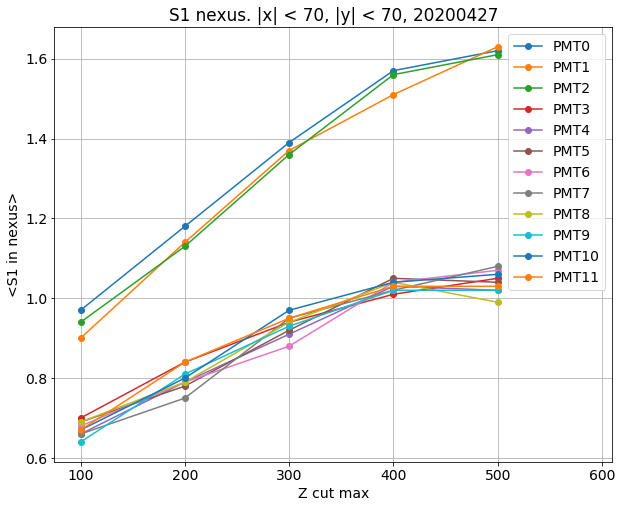

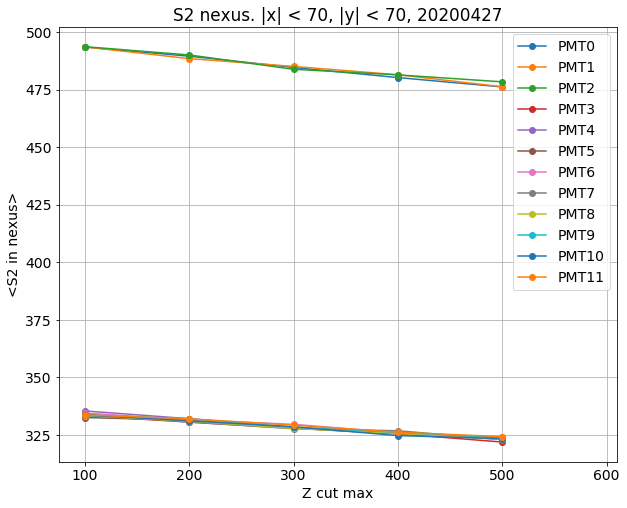

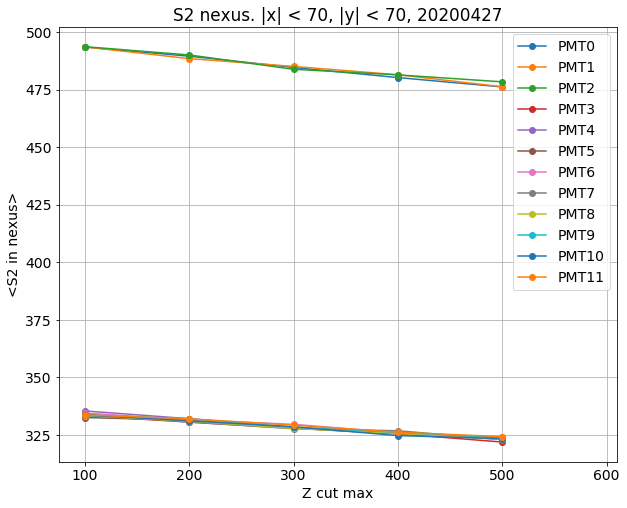

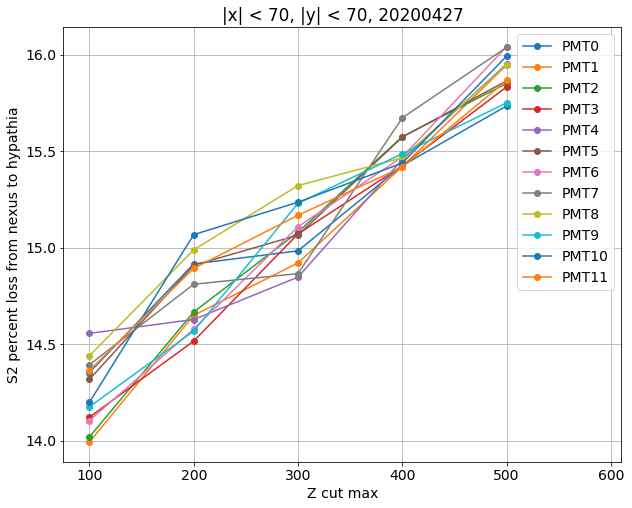

In [27]:
import matplotlib.pyplot as plt

zcuts = [2, 100, 200, 300, 400, 500]
zranges = [[zcuts[i], zcuts[i+1]] for i in range(len(zcuts)-1)]
pmt_ids = [i for i in range(12)]

S1s = [[0.97, 1.18, 1.39, 1.57, 1.62],
 [0.9,  1.14, 1.37, 1.51, 1.63],
 [0.94, 1.13, 1.36, 1.56, 1.61],
 [0.7,  0.84, 0.94, 1.01, 1.05],
 [0.66, 0.79, 0.91, 1.03, 1.02],
 [0.69, 0.78, 0.92, 1.05, 1.04],
 [0.68, 0.79, 0.88, 1.04, 1.07],
 [0.66, 0.75, 0.95, 1.02, 1.08],
 [0.69, 0.79, 0.94, 1.04, 0.99],
 [0.64, 0.81, 0.93, 1.02, 1.02],
 [0.67, 0.8,  0.97, 1.04, 1.06],
 [0.67, 0.84, 0.95, 1.03, 1.03]]

for pid in pmt_ids:
    plt.plot(zcuts[1:], S1s[pid], 'o-', label = 'PMT'+str(pid))
plt.grid()
plt.xlabel('Z cut max')
plt.ylabel('<S1 in nexus>')
plt.xlim(75, 610)
plt.title('S1 nexus. |x| < 70, |y| < 70, 20200427')
plt.legend(loc = 'upper right')
plt.show()

S2s = [[493.49, 489.54, 484.64, 480.24, 476.17],
 [493.56, 488.48, 485.1,  481.47, 476.27],
 [493.67, 490.07, 483.85, 481.42, 478.4 ],
 [333.31, 330.51, 327.82, 325.43, 321.85],
 [335.36, 331.99, 327.94, 325.89, 323.92],
 [332.49, 331.29, 327.92, 325.56, 323.01],
 [334.47, 331.52, 329.54, 325.87, 323.37],
 [333.92, 330.53, 327.63, 326.76, 322.88],
 [333.32, 330.95, 327.75, 325.59, 323.1 ],
 [333.42, 331.96, 328.37, 326.05, 323.69],
 [333.6,  331.07, 328.47, 324.65, 323.34],
 [333.64, 331.93, 329.21, 326.12, 324.19]]

for pid in pmt_ids:
    plt.plot(zcuts[1:], S2s[pid], 'o-', label = 'PMT'+str(pid))
plt.grid()
plt.xlabel('Z cut max')
plt.ylabel('<S2 in nexus>')
plt.xlim(75, 610)
plt.title('S2 nexus. |x| < 70, |y| < 70, 20200427')
plt.legend(loc = 'upper right')
plt.show()

pmap_S2s = [[422.66136035, 416.5247191,  412.02724796, 406.16666667, 401.25067385],
 [424.49927641, 416.92359551, 412.72207084, 407.23056995, 400.32704403],
 [424.46454414, 418.19662921, 410.88555858, 406.44214162, 402.57322552],
 [286.24457308, 282.53483146, 278.41598547, 275.23747841, 270.89398023],
 [286.54703329, 283.42921348, 279.25158946, 275.51986183, 272.25157233],
 [284.88712012, 281.9011236,  278.52134423, 274.86355786, 271.76819407],
 [287.29811867, 283.19213483, 279.75386013, 275.46027634, 271.49955076],
 [285.85962373, 281.57865169, 278.92824705, 275.55008636, 271.09973046],
 [285.19247467, 281.34719101, 277.53587648, 275.23747841, 271.58221024],
 [286.15918958, 283.60224719, 278.36148955, 275.55872193, 272.70979335],
 [286.23589001, 281.18876404, 278.42779292, 274.53195164, 271.63252471],
 [285.72069465, 282.4988764,  279.27883742, 275.84110535, 272.75471698]]

for pid in pmt_ids:
    plt.plot(zcuts[1:], S2s[pid], 'o-', label = 'PMT'+str(pid))
plt.grid()
plt.xlabel('Z cut max')
plt.ylabel('<S2 in nexus>')
plt.xlim(75, 610)
plt.title('S2 nexus. |x| < 70, |y| < 70, 20200427')
plt.legend(loc = 'upper right')
plt.show()

nexus_minus_pmap = 100*((np.array(S2s) - np.array(pmap_S2s)) / np.array(S2s))
for pid in pmt_ids:
    plt.plot(zcuts[1:], nexus_minus_pmap[pid], 'o-', label = 'PMT'+str(pid))
plt.grid()
plt.xlabel('Z cut max')
plt.ylabel('S2 percent loss from nexus to hypathia')
plt.xlim(75, 610)
plt.title('|x| < 70, |y| < 70, 20200427')
plt.legend(loc = 'upper right')
plt.show()

# Data S2
# [[1105.30693069 1107.02439024 1084.58181818 1073.17012448 1058.58181818]
#  [1394.43564356 1396.69105691 1362.60454545 1351.45643154 1336.24      ]
#  [1108.30693069 1108.59756098 1090.12272727 1078.90871369 1065.57454545]
#  [ 726.31188119  724.65447154  712.90909091  704.48547718  694.53454545]
#  [1160.12871287 1161.22357724 1141.88636364 1131.26556017 1120.99636364]
#  [ 958.04950495  958.7195122   938.28181818  931.42738589  916.65090909]
#  [ 852.47029703  857.45528455  840.09090909  830.3153527   823.90181818]
#  [ 851.64851485  853.12601626  834.21818182  831.72614108  819.93454545]
#  [ 998.73267327 1003.22357724  985.16363636  971.48962656  960.50181818]
#  [ 863.56930693  861.49186992  843.50454545  837.84232365  826.68727273]
#  [1001.83168317 1003.90650407  980.77272727  973.76763485  959.04      ]
#  [ 828.9009901   827.54471545  810.36818182  805.78008299  797.16      ]]
# Data S1
# [[0.35643564 0.42276423 0.48636364 0.67634855 0.62181818]
#  [0.58415842 0.68699187 0.80909091 0.99170124 1.02545455]
#  [0.29207921 0.35772358 0.45       0.6846473  0.65090909]
#  [0.0990099  0.06910569 0.18636364 0.19087137 0.15272727]
#  [0.18316832 0.28455285 0.31818182 0.39834025 0.38545455]
#  [0.14356436 0.24796748 0.38181818 0.36099585 0.43636364]
#  [0.0990099  0.08536585 0.20454545 0.34854772 0.24363636]
#  [0.27722772 0.2398374  0.33181818 0.23236515 0.25454545]
#  [0.33168317 0.32926829 0.45909091 0.31120332 0.43636364]
#  [0.06930693 0.35365854 0.40454545 0.41493776 0.40727273]
#  [0.20792079 0.2601626  0.35       0.33195021 0.41090909]
#  [0.09405941 0.11788618 0.20454545 0.37344398 0.25090909]]
# MC S2
# [[422.66136035 416.5247191  412.02724796 406.16666667 401.25067385]
#  [424.49927641 416.92359551 412.72207084 407.23056995 400.32704403]
#  [424.46454414 418.19662921 410.88555858 406.44214162 402.57322552]
#  [286.24457308 282.53483146 278.41598547 275.23747841 270.89398023]
#  [286.54703329 283.42921348 279.25158946 275.51986183 272.25157233]
#  [284.88712012 281.9011236  278.52134423 274.86355786 271.76819407]
#  [287.29811867 283.19213483 279.75386013 275.46027634 271.49955076]
#  [285.85962373 281.57865169 278.92824705 275.55008636 271.09973046]
#  [285.19247467 281.34719101 277.53587648 275.23747841 271.58221024]
#  [286.15918958 283.60224719 278.36148955 275.55872193 272.70979335]
#  [286.23589001 281.18876404 278.42779292 274.53195164 271.63252471]
#  [285.72069465 282.4988764  279.27883742 275.84110535 272.75471698]]
# MC S1
# [[0.28075253 0.46179775 0.55676658 0.6865285  0.74483378]
#  [0.2301013  0.42359551 0.56948229 0.67962003 0.7214735 ]
#  [0.27785818 0.34606742 0.54405086 0.66753022 0.71877808]
#  [0.11143271 0.1258427  0.22343324 0.2746114  0.27493261]
#  [0.03762663 0.14382022 0.20799273 0.27720207 0.22911051]
#  [0.09261939 0.13033708 0.20254314 0.30051813 0.26774483]
#  [0.06657019 0.08539326 0.16257947 0.30138169 0.2982929 ]
#  [0.0260492  0.1011236  0.24613987 0.24093264 0.26864331]
#  [0.07959479 0.08988764 0.21253406 0.26770294 0.22192273]
#  [0.00723589 0.17977528 0.17166213 0.26338515 0.23450135]
#  [0.04775687 0.16067416 0.21980018 0.27633851 0.30997305]
#  [0.09117221 0.16404494 0.19891008 0.30397237 0.27044025]]



xr = [-210, -70] ; yr = [-210, -70]
calculating data...


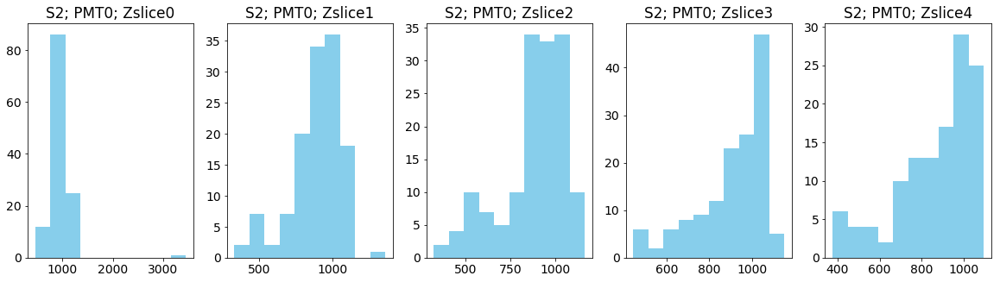

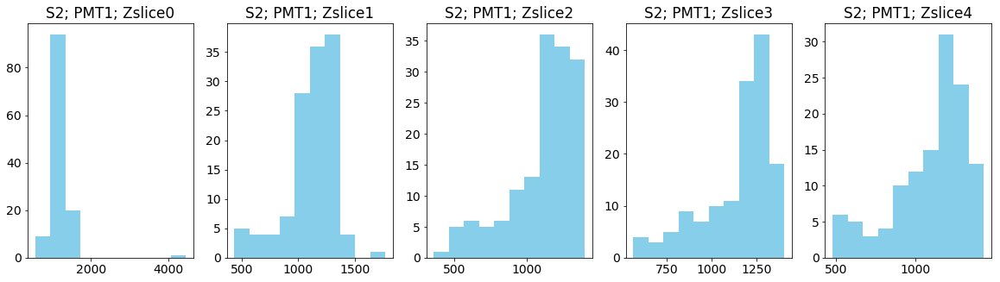

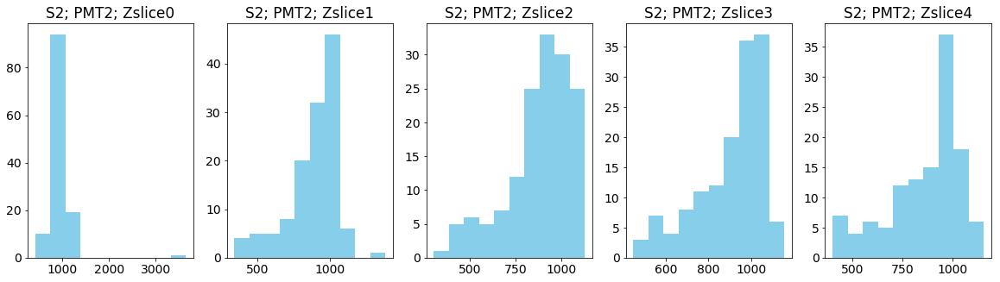

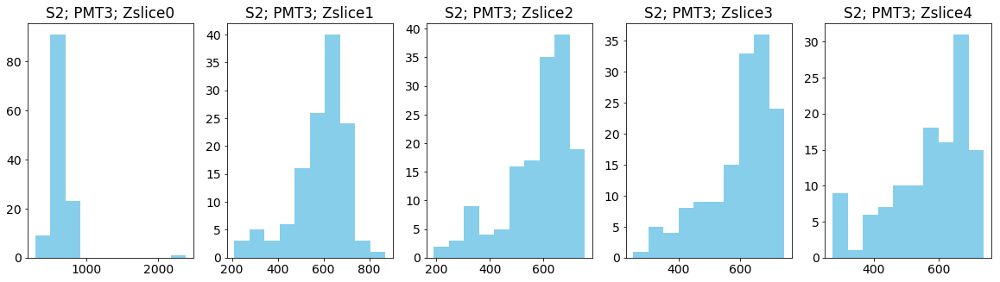

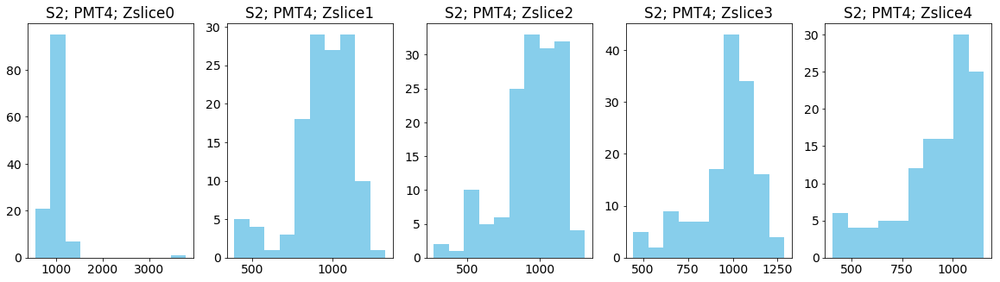

...

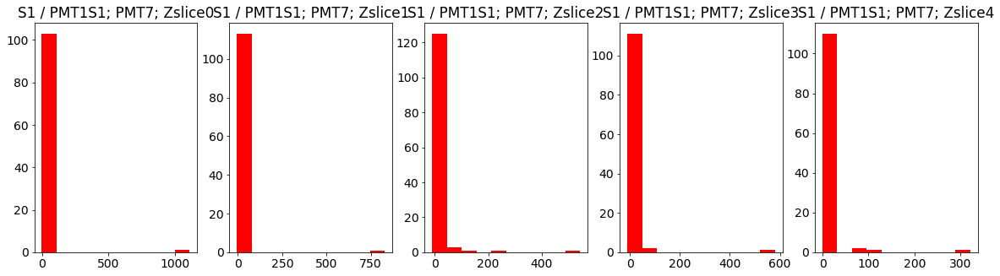

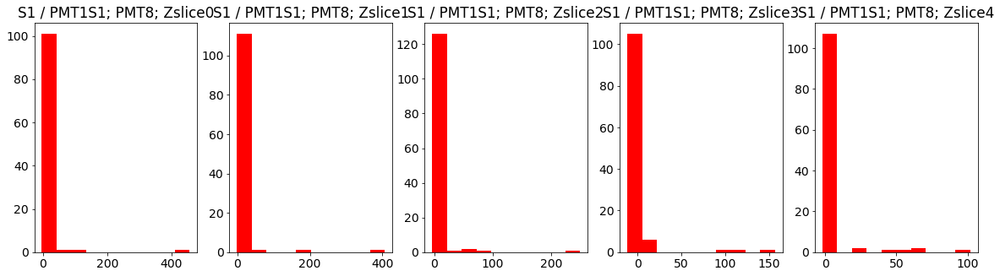

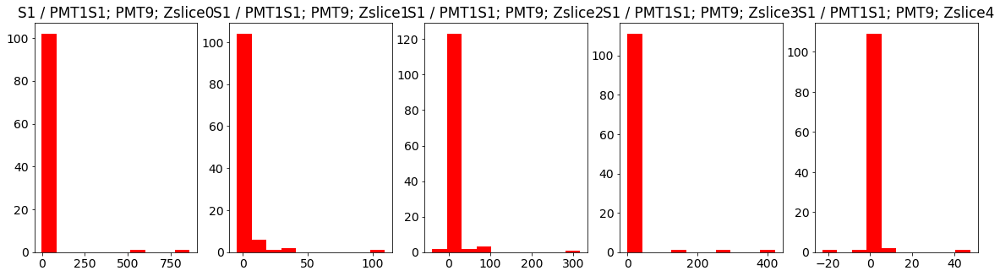

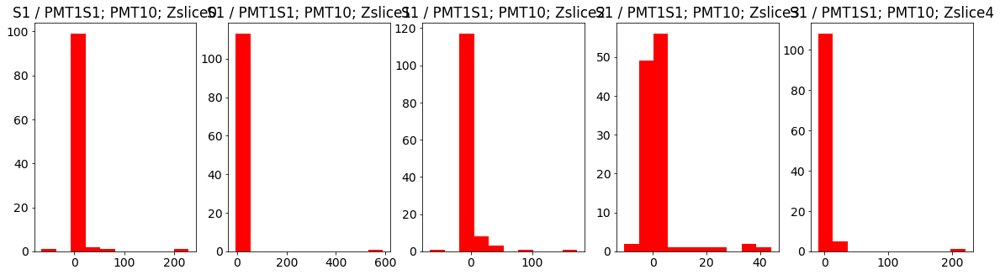

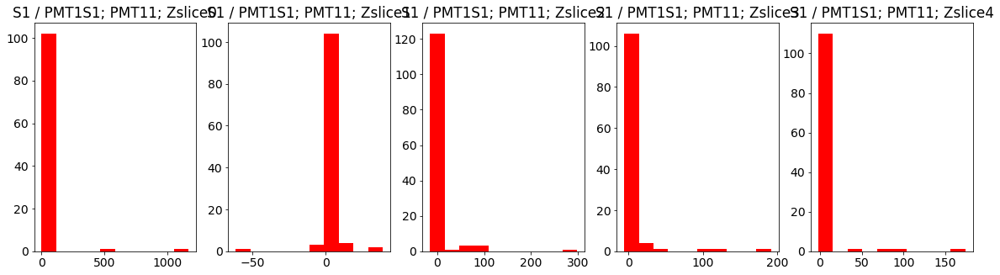

Calculated S2 matrix =
[[0.7953721, 0.79432756, 0.79626554, 0.79416263, 0.7961186], [1.0, 1.0, 1.0, 1.0, 1.0], [0.7967564, 0.79529244, 0.7957811, 0.7936037, 0.7930631], [0.52920276, 0.52452326, 0.52730566, 0.522914, 0.5245474], [0.8440625, 0.8469191, 0.85375667, 0.84290326, 0.8420862], [0.7018679, 0.69609916, 0.69952065, 0.6979804, 0.6990637], [0.63043296, 0.63018167, 0.6298181, 0.63061184, 0.62953526], [0.6248777, 0.6242208, 0.6252883, 0.6205749, 0.62433434], [0.73317254, 0.7260917, 0.7296817, 0.7275038, 0.72458965], [0.6270066, 0.6192615, 0.62882394, 0.62515354, 0.6262691], [0.71896356, 0.71477354, 0.7200799, 0.72135705, 0.71954346], [0.60317373, 0.5973234, 0.59874487, 0.59463173, 0.60001487]]
calculating mc...


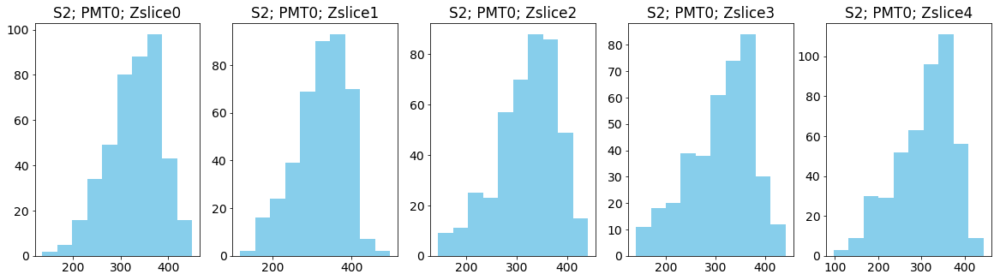

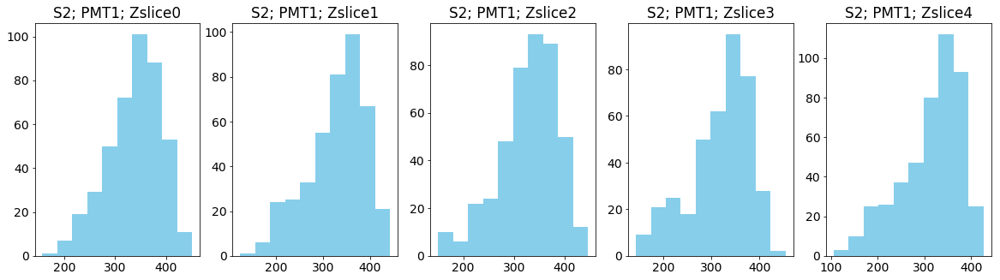

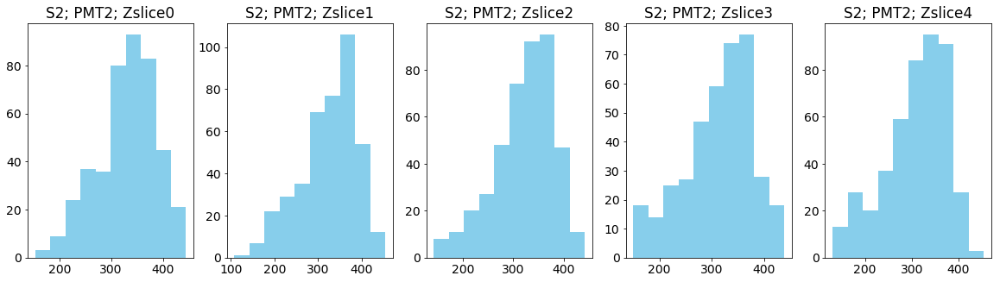

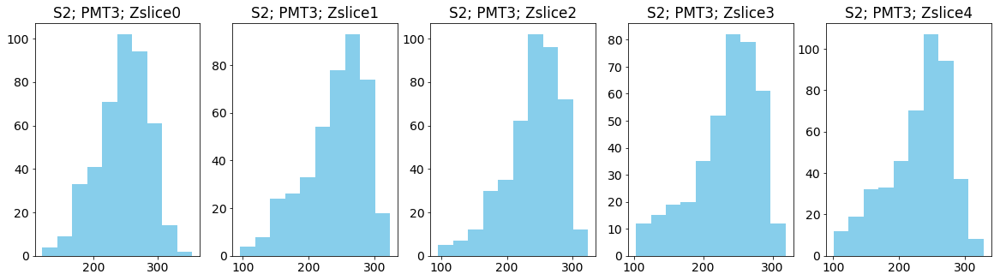

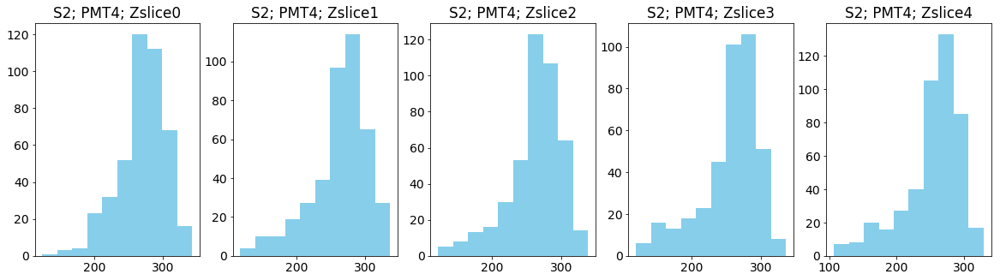

...

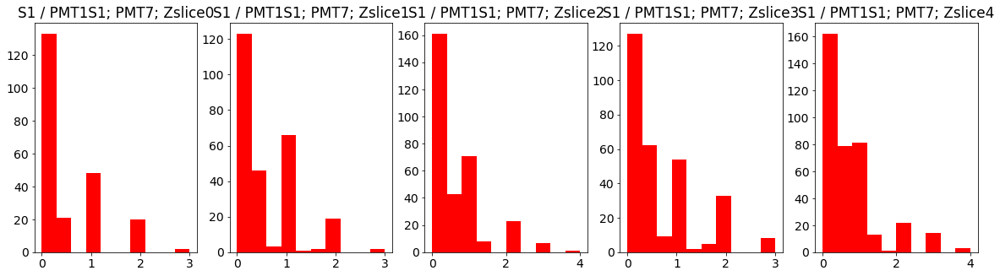

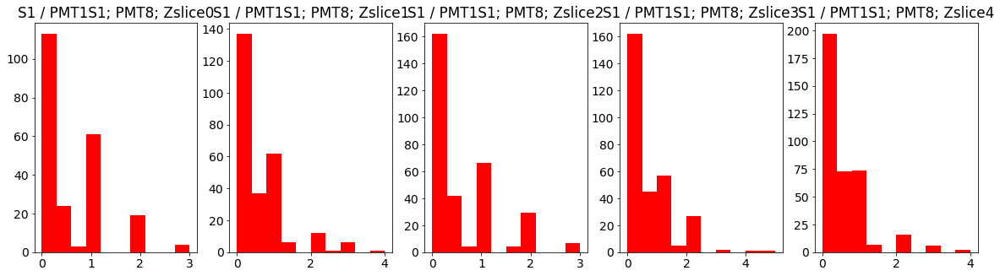

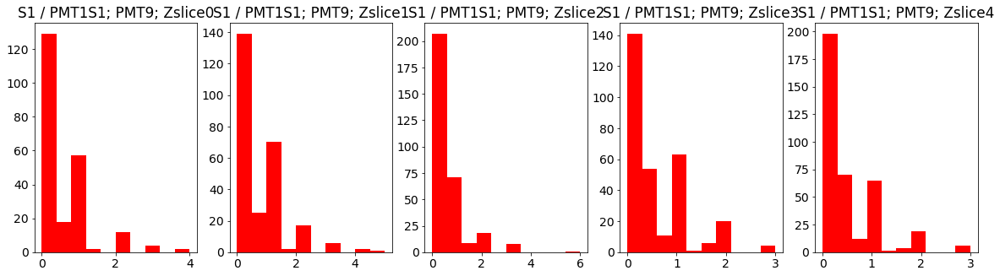

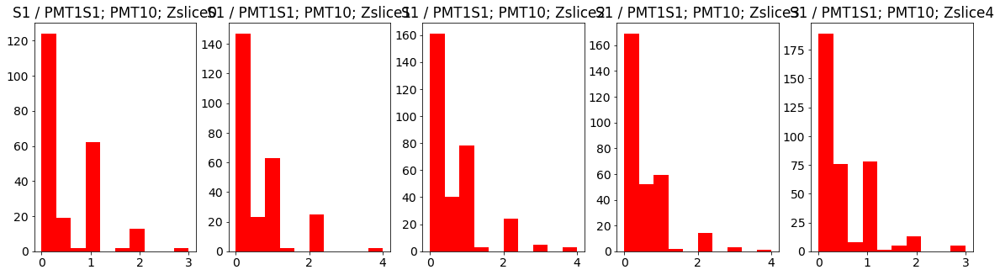

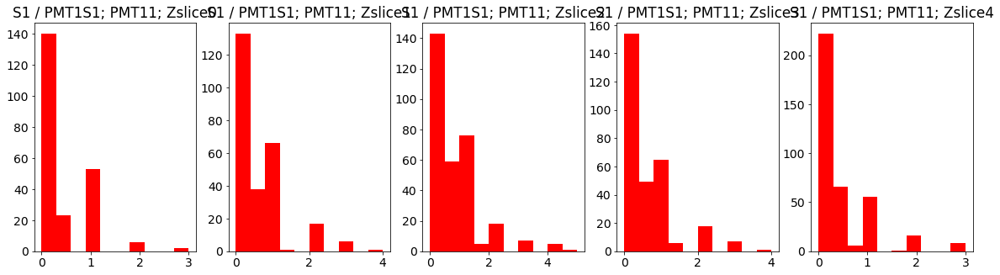

Data S2
[[ 953.82258065  891.8976378   883.09395973  909.17361111  868.16260163]
 [1200.15322581 1124.38582677 1111.74496644 1144.47222222 1091.81300813]
 [ 956.31451613  894.38582677  882.37583893  907.40277778  864.30081301]
 [ 635.17741935  590.03149606  585.18120805  598.36805556  572.17886179]
 [1011.37903226  948.5984252   946.48322148  964.26388889  917.23577236]
 [ 840.82258065  781.19685039  774.9261745   797.77777778  761.80487805]
 [ 755.12096774  707.85826772  698.62416107  719.86111111  685.83739837]
 [ 748.99193548  700.83464567  692.84563758  709.0625      680.63414634]
 [ 878.59677419  816.72440945  809.16107383  831.38194444  790.08943089]
 [ 751.50806452  696.07086614  697.04697987  714.78472222  682.43902439]
 [ 861.21774194  802.98425197  798.36912752  825.55555556  783.81300813]
 [ 722.68548387  671.11023622  664.77852349  680.55555556  654.7804878 ]]
Data S1
[[0.34677419 0.43307087 0.46979866 1.56944444 0.60162602]
 [0.54032258 0.8503937  0.83892617 2.43055556 1.3

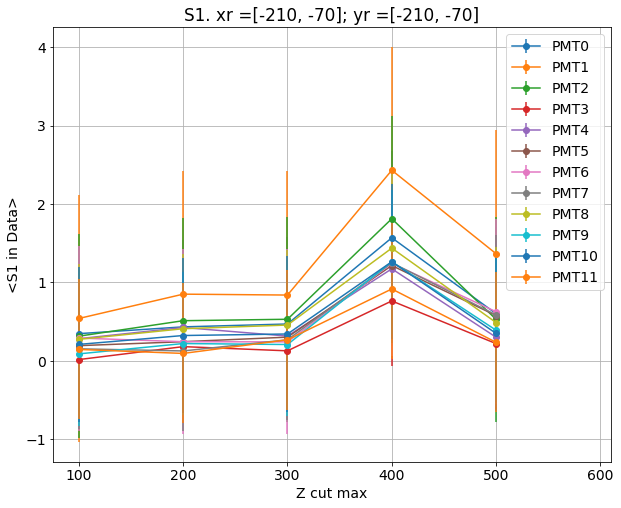

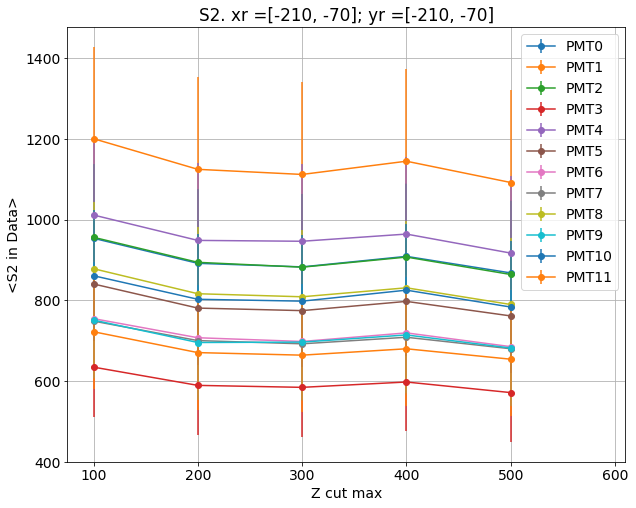

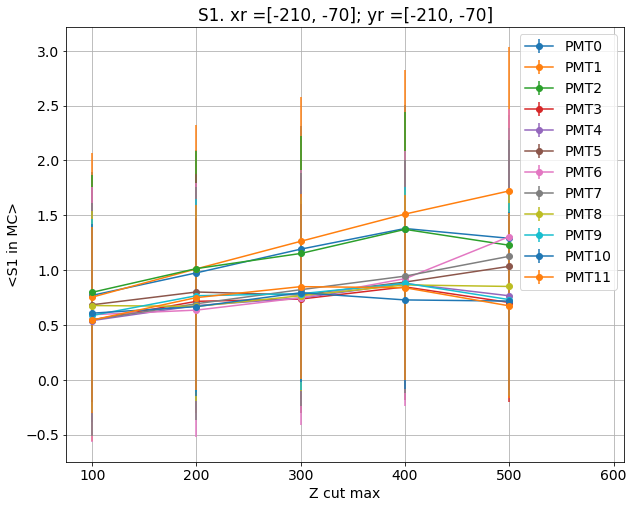

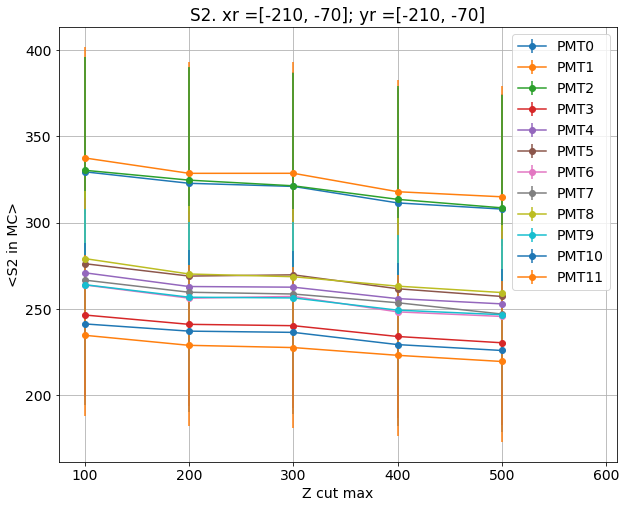

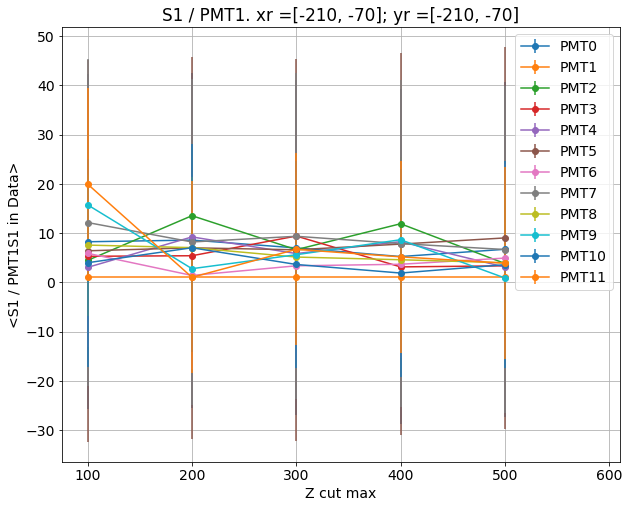

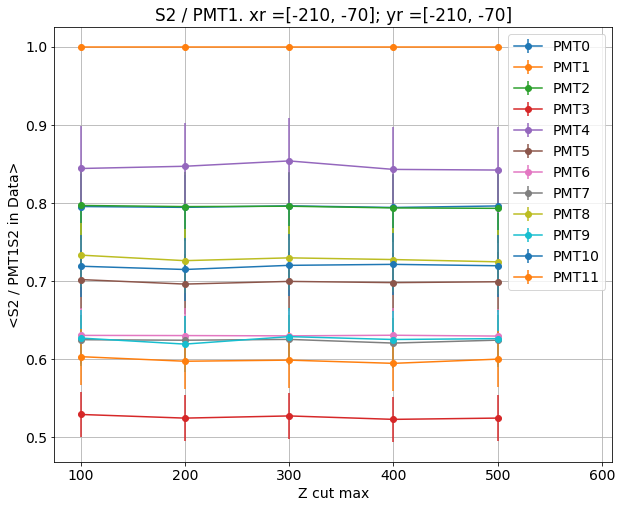

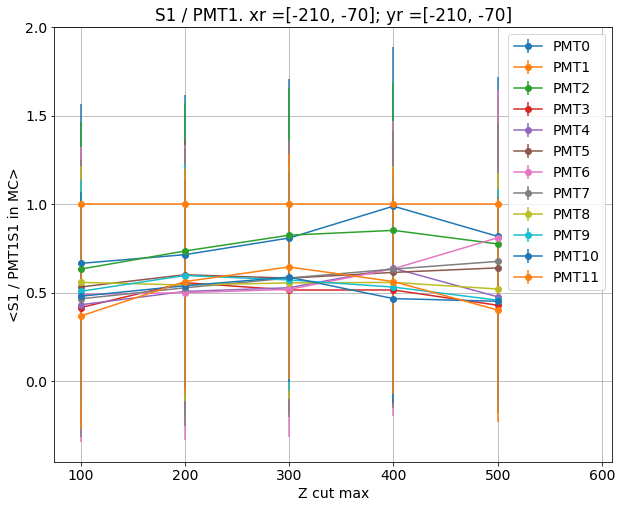

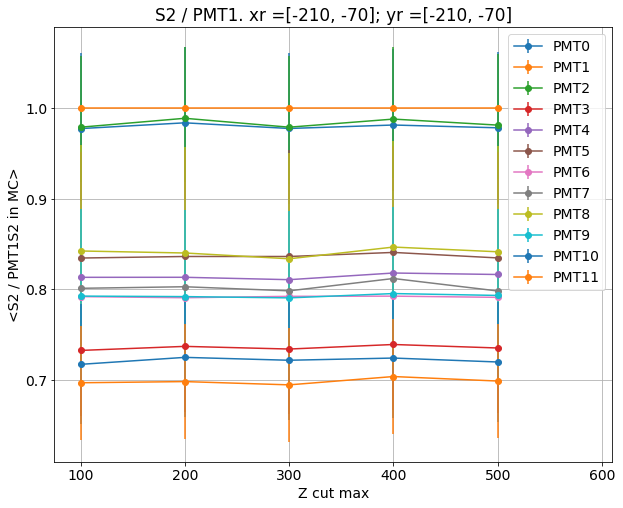

Dividing S2s
Dividing S1s


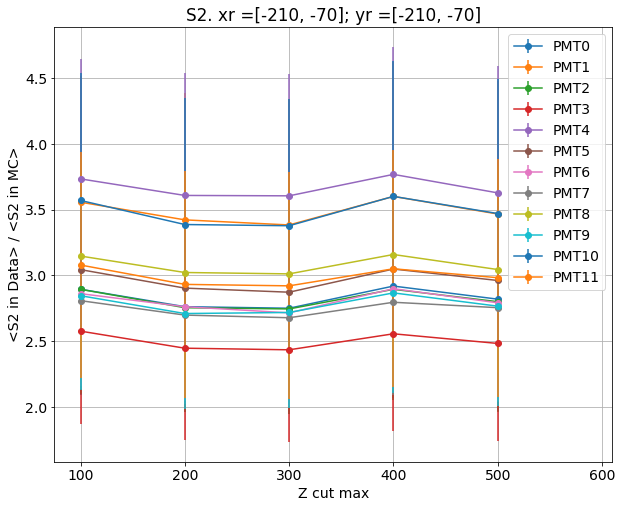

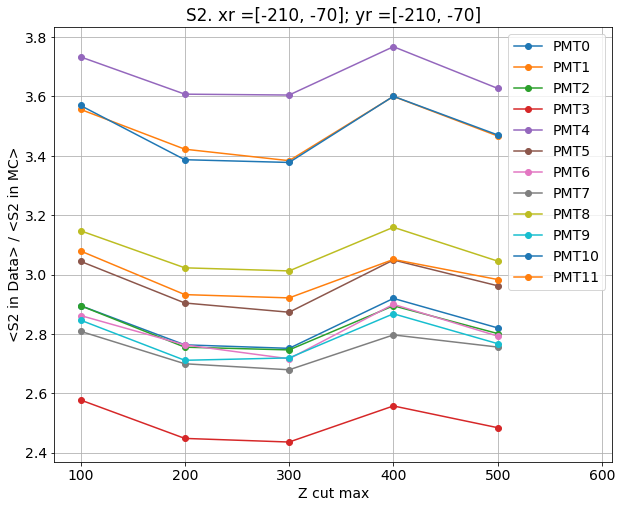

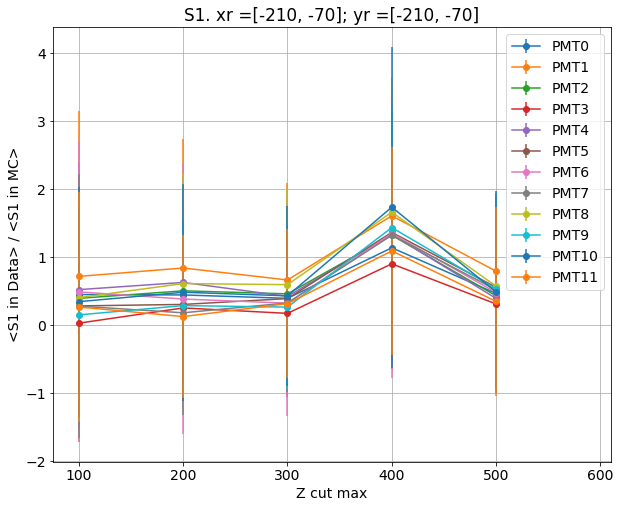

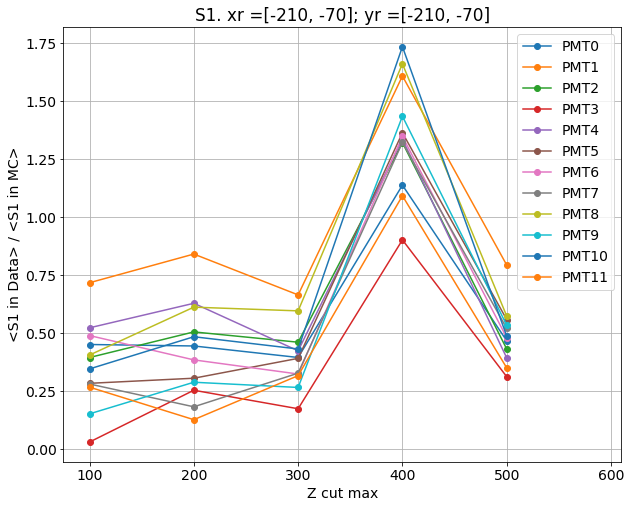

xr = [-210, -70] ; yr = [-70, 70]
calculating data...


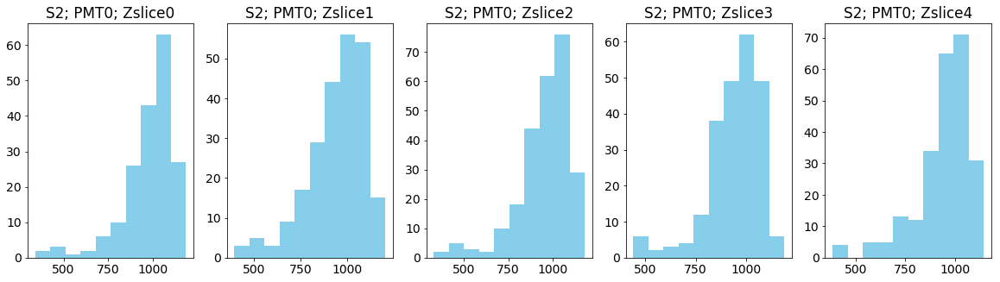

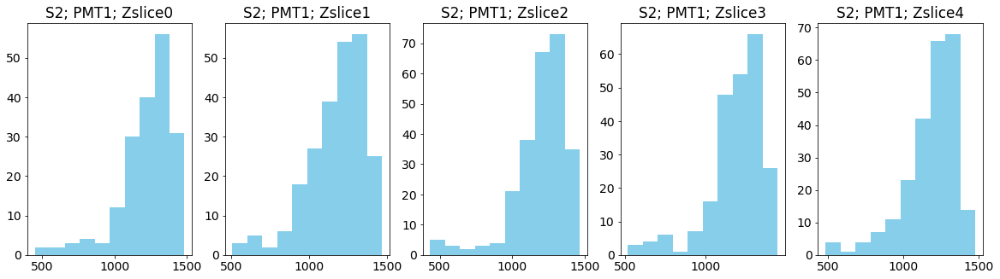

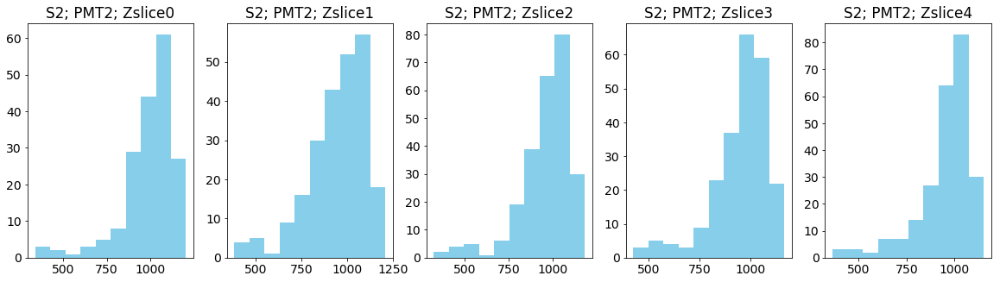

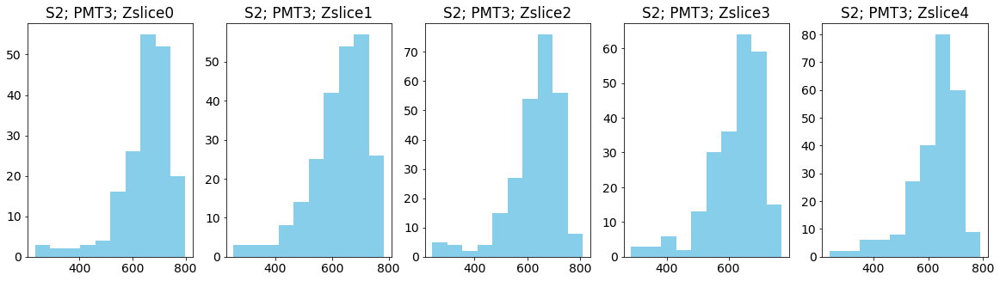

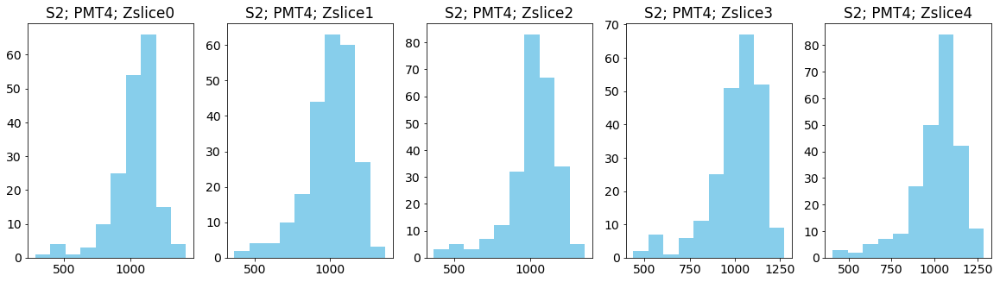

...

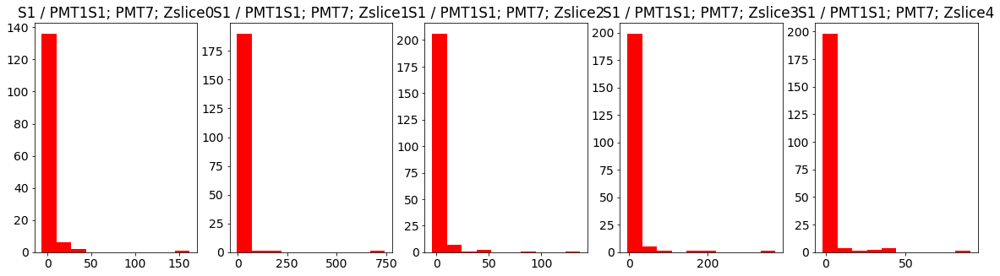

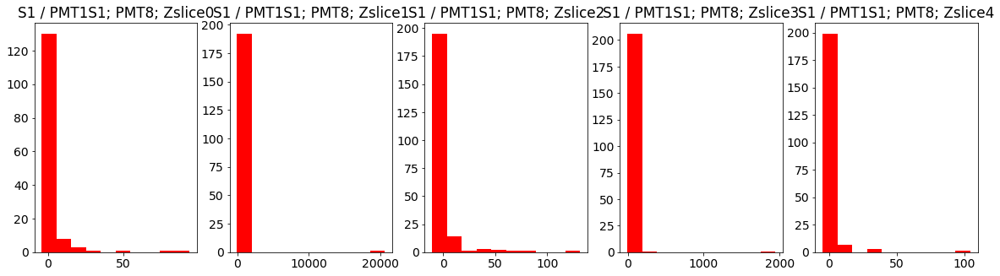

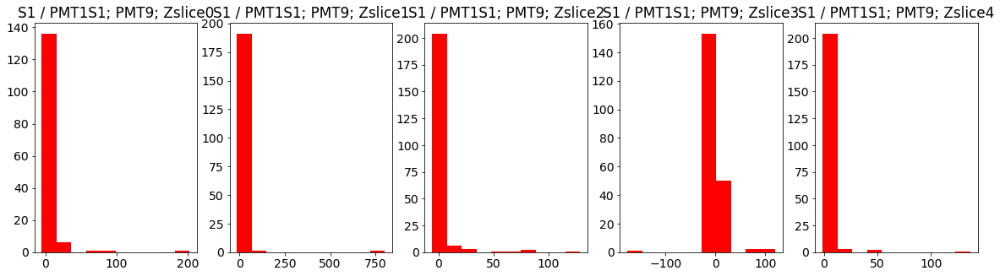

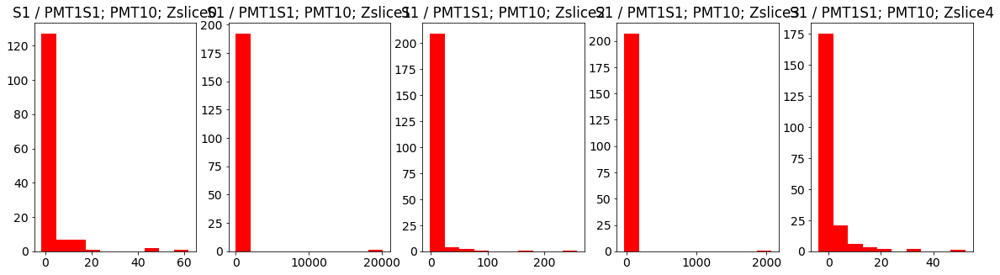

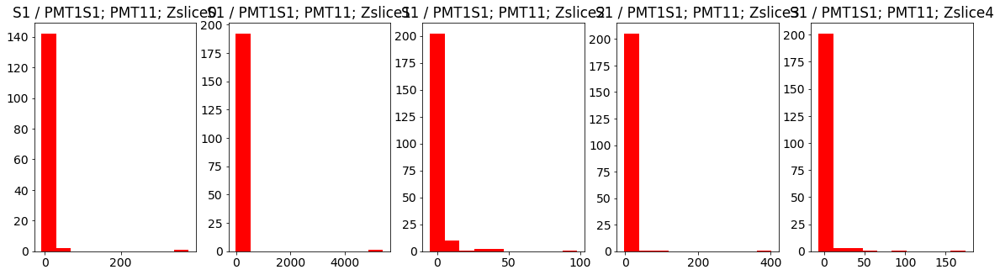

Calculated S2 matrix =
[[0.79650414, 0.8004287, 0.79427636, 0.7928166, 0.79540443], [1.0, 1.0, 1.0, 1.0, 1.0], [0.80808836, 0.80372304, 0.80254865, 0.7997545, 0.80337113], [0.52959746, 0.5322841, 0.52562416, 0.52517253, 0.52771103], [0.8438764, 0.85297644, 0.84826666, 0.84807485, 0.8542555], [0.7021016, 0.7009728, 0.69721556, 0.69628763, 0.6962324], [0.62777877, 0.6253892, 0.6289093, 0.62303555, 0.62708336], [0.62555975, 0.6231057, 0.6184317, 0.6211536, 0.62374634], [0.72676486, 0.7281931, 0.7244984, 0.7219534, 0.72663784], [0.6205973, 0.619814, 0.6188121, 0.61877096, 0.6207395], [0.72236073, 0.7227092, 0.7226282, 0.7216683, 0.7190661], [0.59875107, 0.6042371, 0.6003881, 0.5982822, 0.5985021]]
calculating mc...


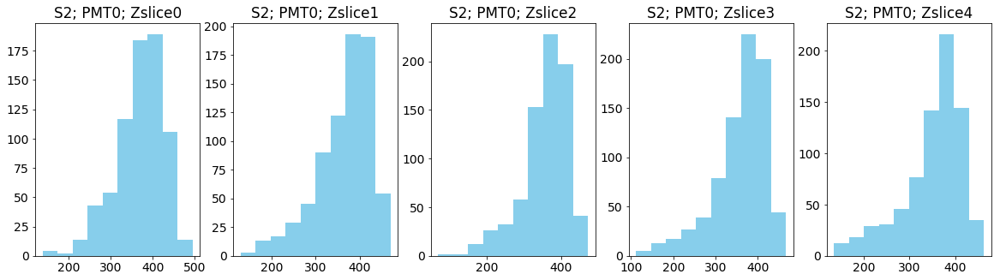

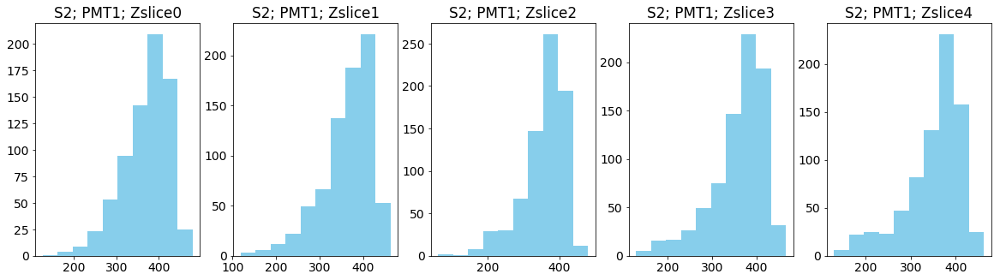

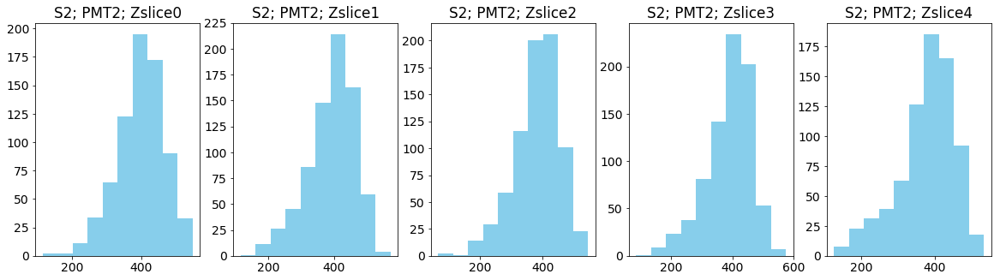

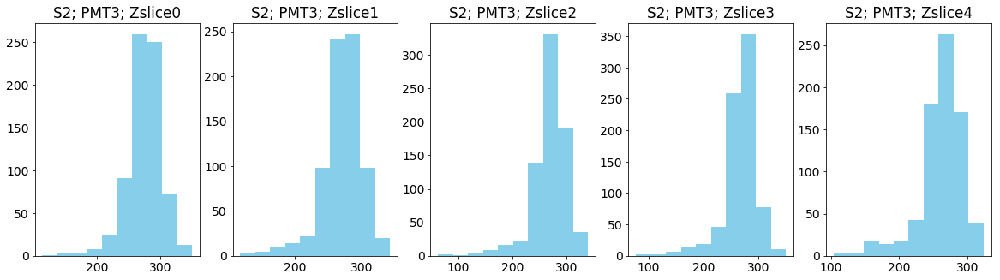

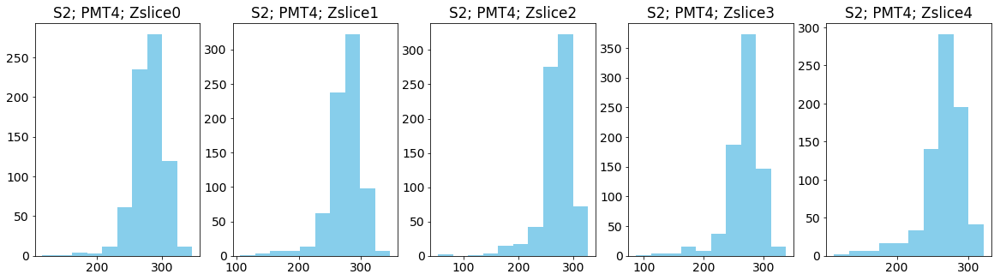

...

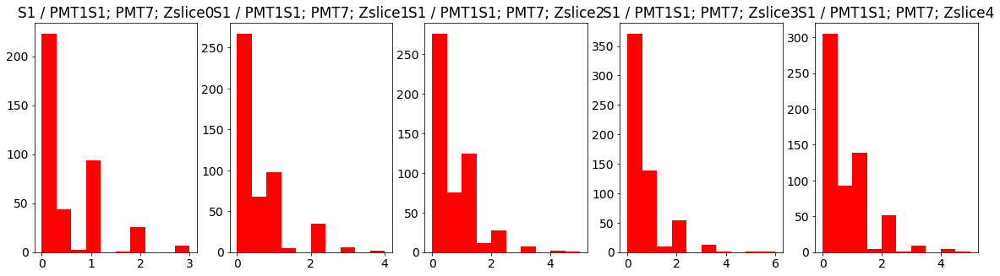

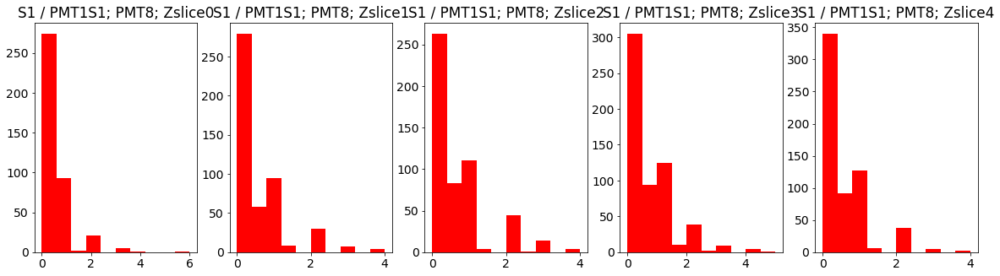

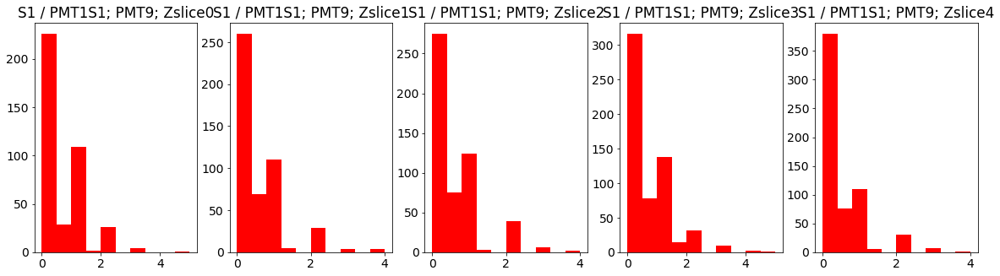

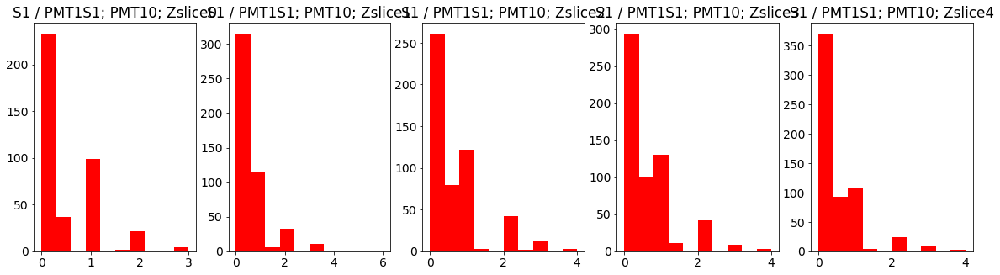

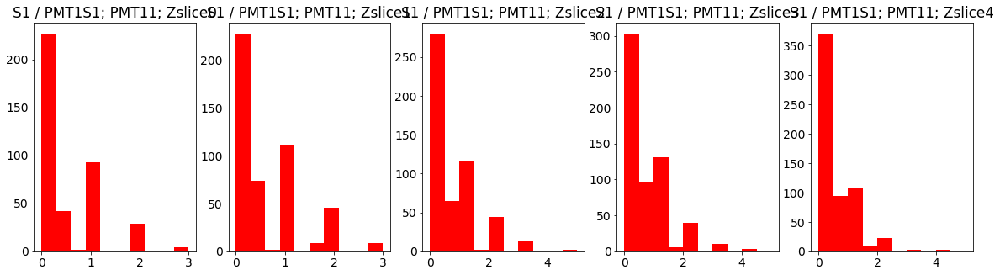

Data S2
[[ 974.32240437  941.28510638  951.60159363  942.10822511  942.2125    ]
 [1223.6010929  1175.89361702 1199.6812749  1190.26406926 1185.7875    ]
 [ 988.89617486  945.8         961.75697211  951.11255411  951.63333333]
 [ 647.54644809  625.05106383  629.38247012  623.71428571  625.19166667]
 [1032.89617486 1001.47234043 1015.22310757 1007.31601732 1010.12083333]
 [ 857.30054645  823.64255319  835.0876494   826.12987013  824.2875    ]
 [ 767.10382514  734.02978723  752.52191235  740.004329    741.70416667]
 [ 764.48087432  732.86382979  740.53386454  737.55411255  738.025     ]
 [ 890.12568306  855.64680851  867.66932271  858.16883117  861.17916667]
 [ 759.58469945  728.93617021  741.812749    735.44588745  735.67916667]
 [ 883.63934426  850.68510638  866.09163347  857.70995671  852.425     ]
 [ 732.36612022  710.47659574  719.20717131  710.95238095  709.29583333]]
Data S1
[[0.23497268 0.4212766  0.5498008  0.72727273 0.725     ]
 [0.46448087 0.59148936 0.84860558 0.95238095 1.1

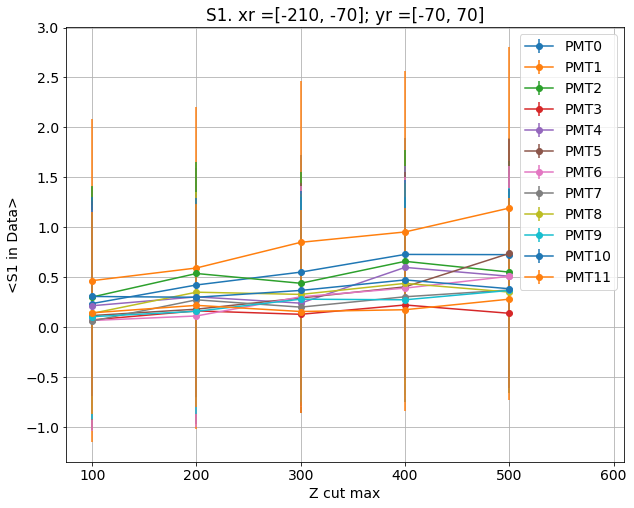

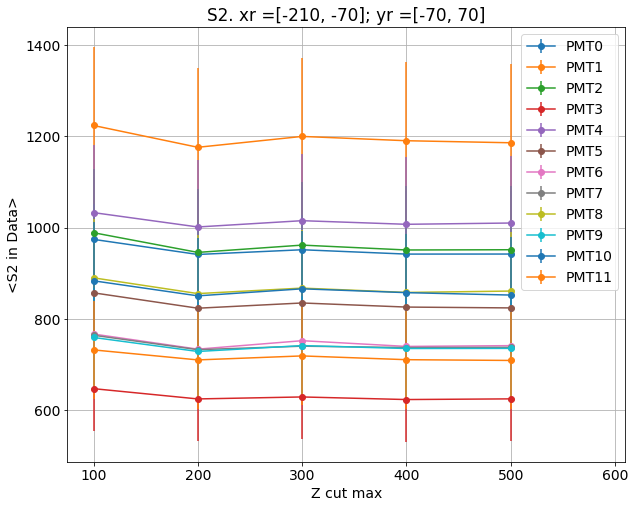

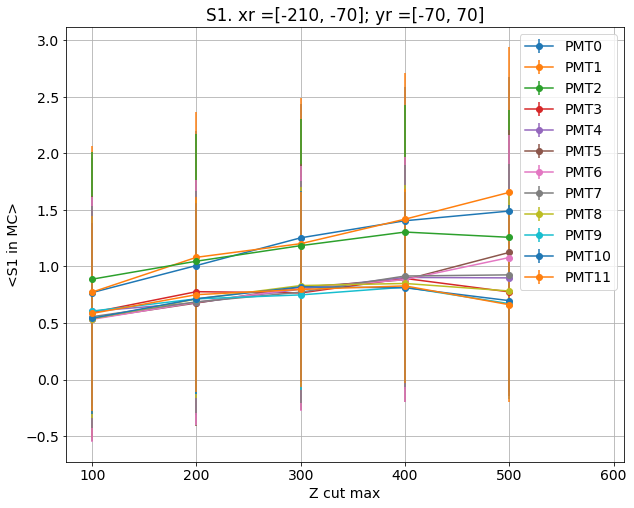

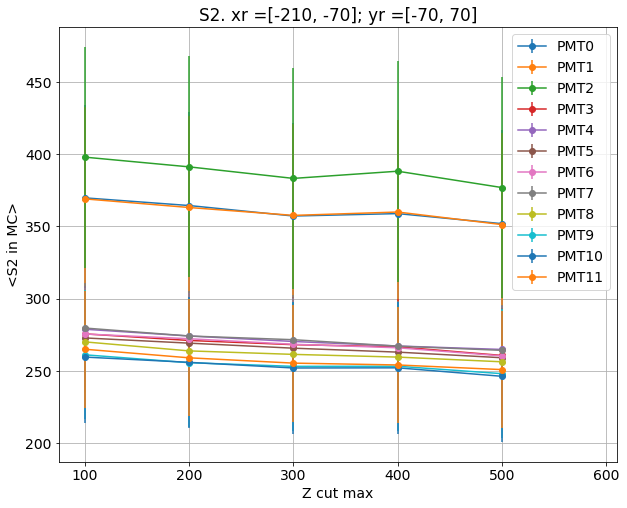

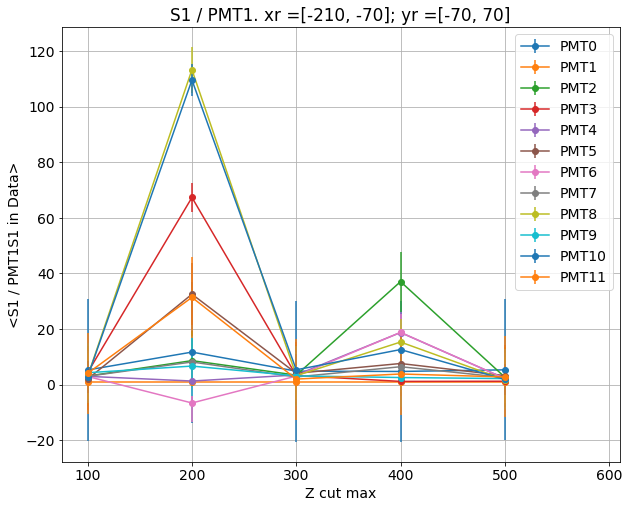

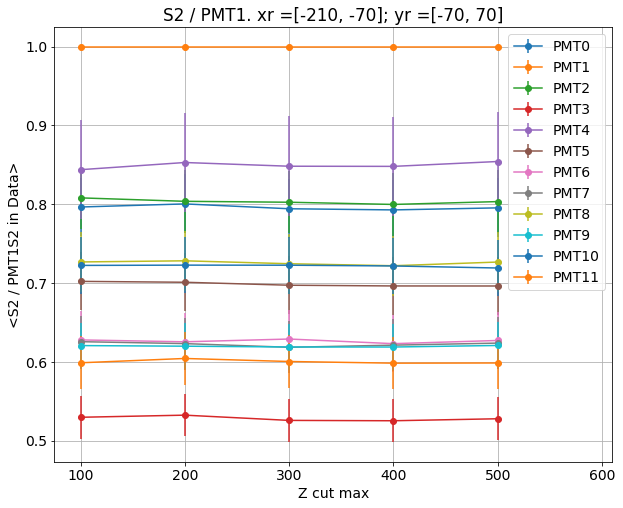

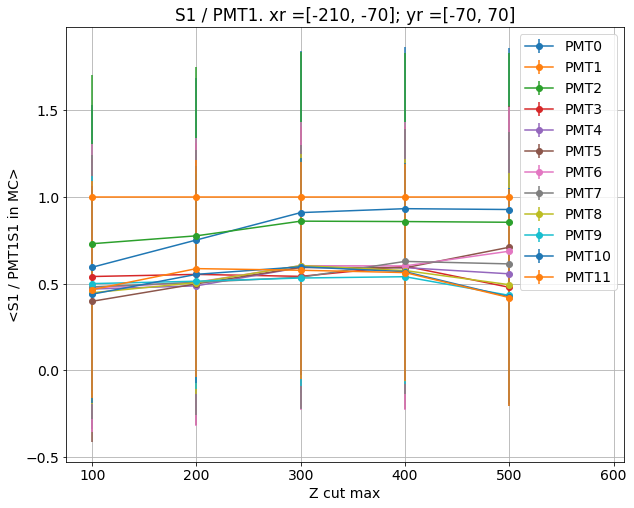

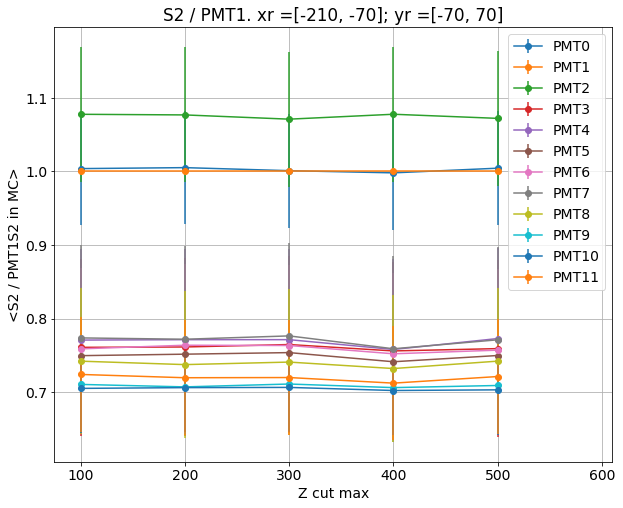

Dividing S2s
Dividing S1s


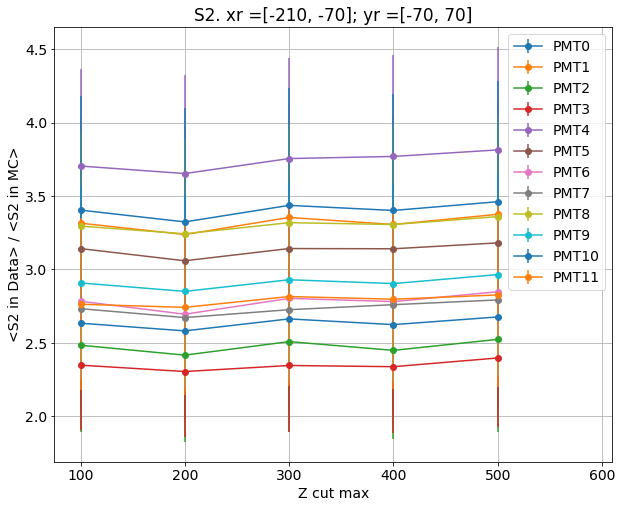

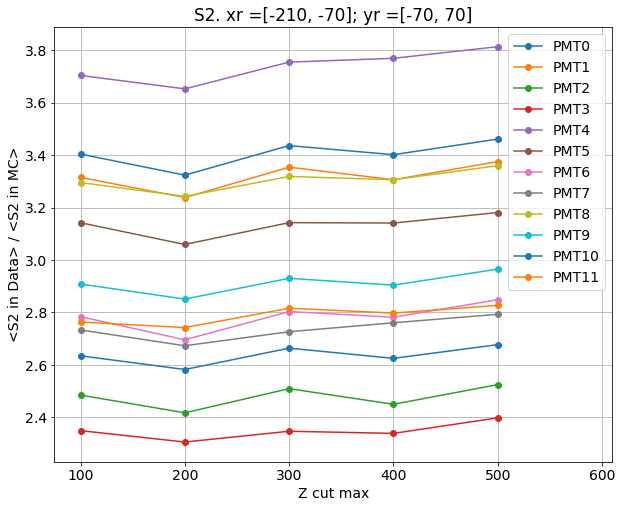

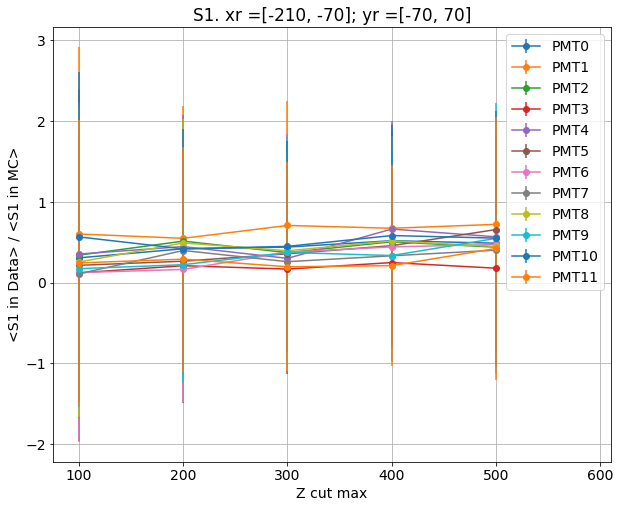

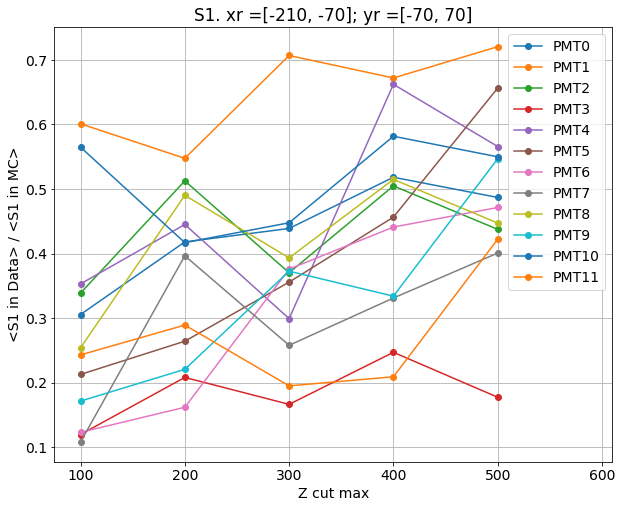

xr = [-210, -70] ; yr = [70, 210]
calculating data...


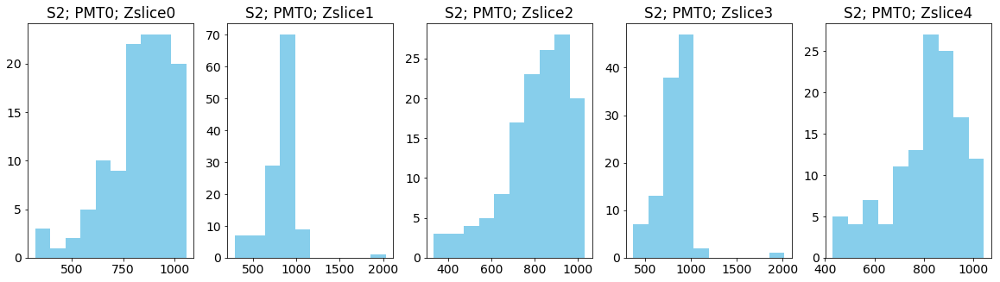

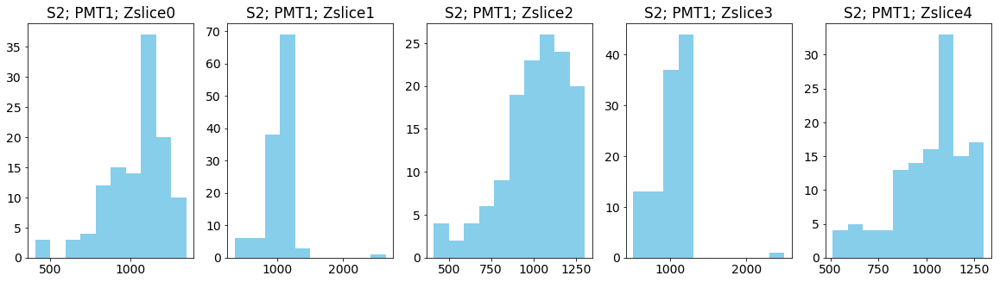

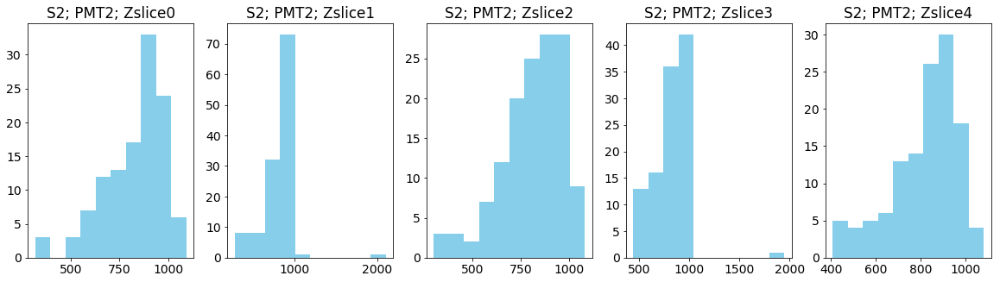

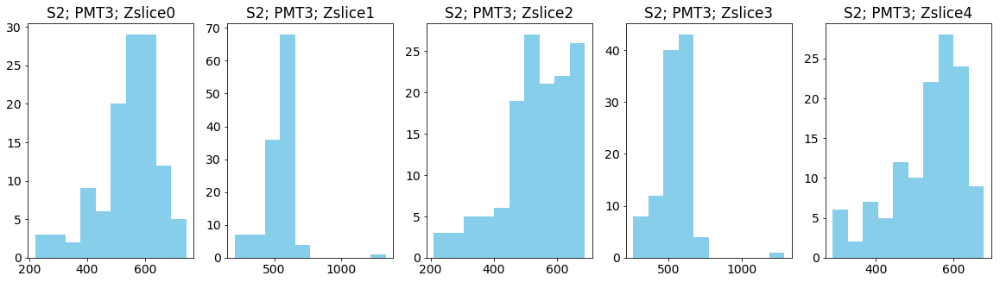

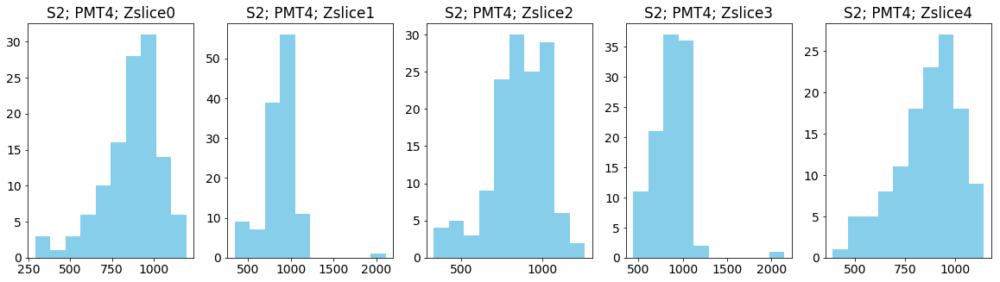

...

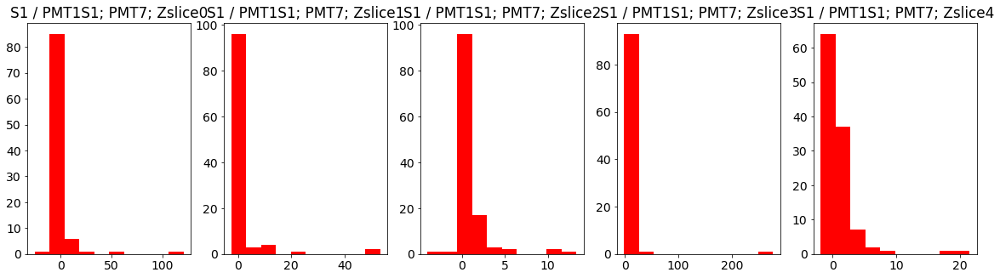

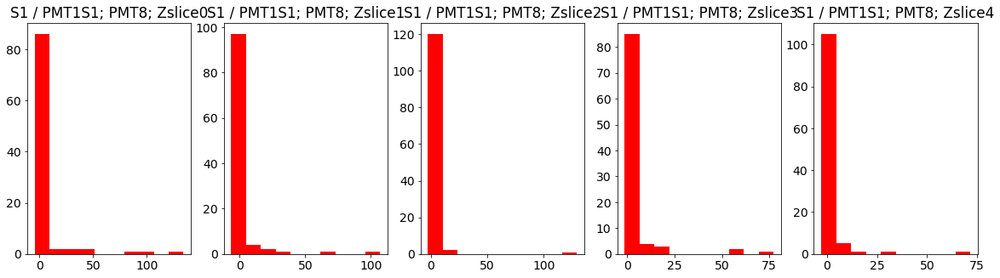

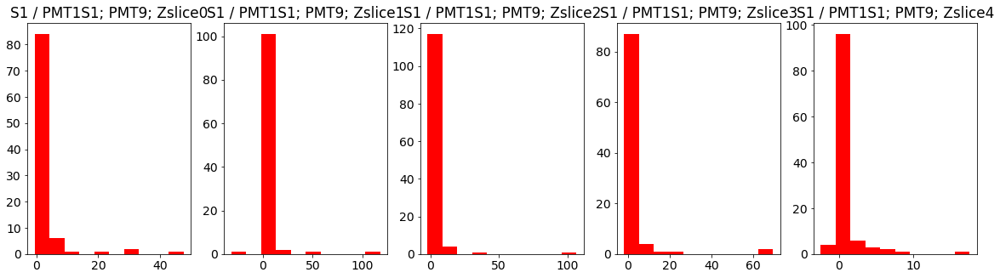

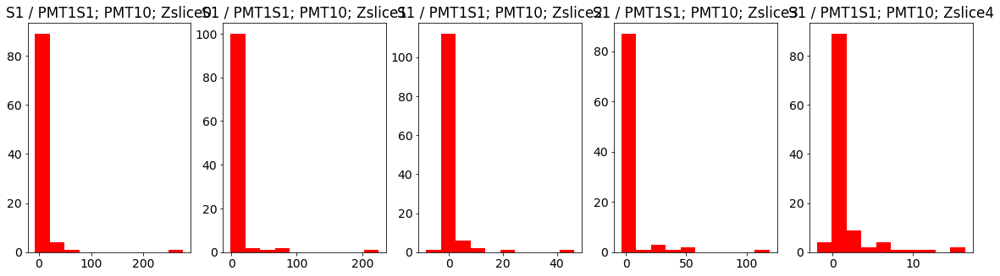

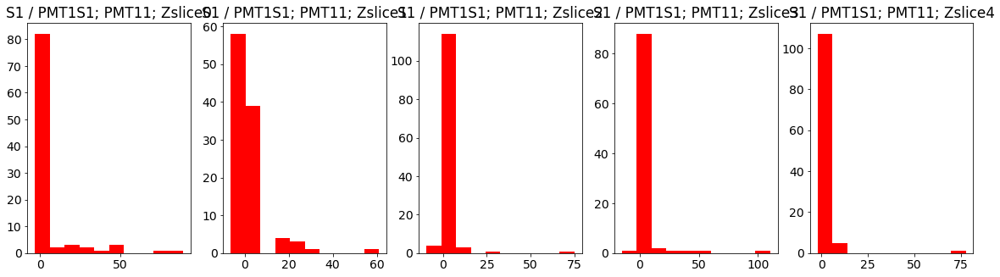

Calculated S2 matrix =
[[0.79980236, 0.8097101, 0.802258, 0.79970324, 0.7982334], [1.0, 1.0, 1.0, 1.0, 1.0], [0.7956057, 0.8051706, 0.8010148, 0.8019077, 0.80281544], [0.5255191, 0.53122646, 0.528979, 0.52872044, 0.5263892], [0.836385, 0.8547985, 0.8445781, 0.85285735, 0.84857726], [0.7020399, 0.705276, 0.70548457, 0.7007519, 0.7026555], [0.6243829, 0.62985224, 0.6260758, 0.63085085, 0.62531674], [0.6127649, 0.621099, 0.6154246, 0.6168704, 0.6188068], [0.7236678, 0.72808284, 0.7191633, 0.7212831, 0.72411925], [0.6173976, 0.62351495, 0.6202836, 0.6225475, 0.62524617], [0.7192491, 0.7303864, 0.727525, 0.7304784, 0.72779715], [0.6047463, 0.61216176, 0.6033099, 0.6120156, 0.60276425]]
calculating mc...


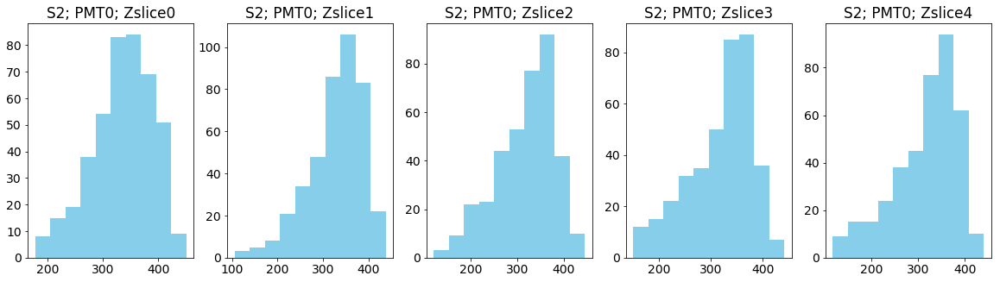

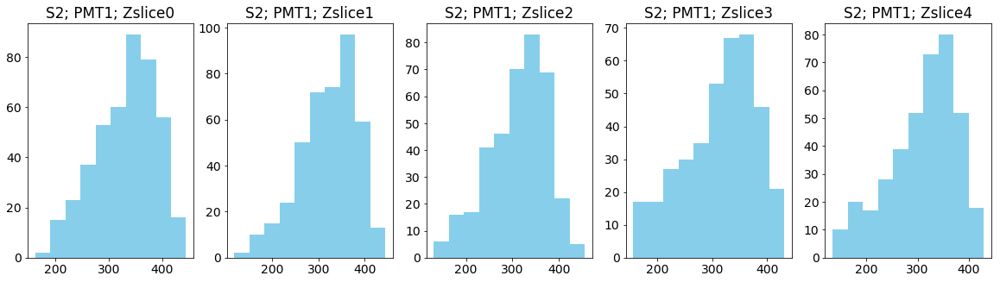

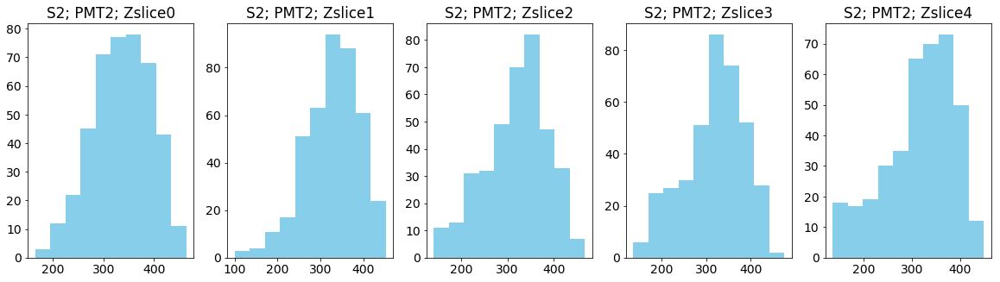

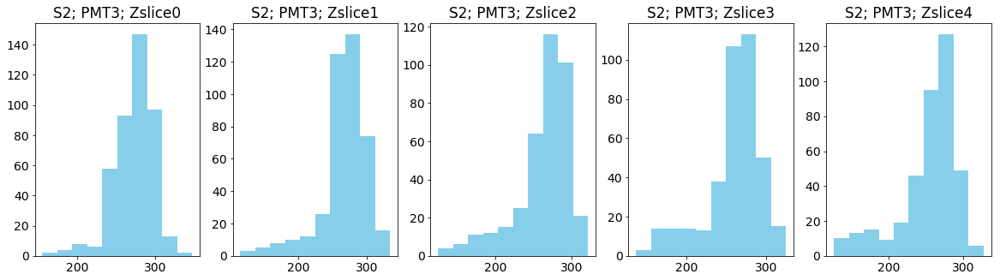

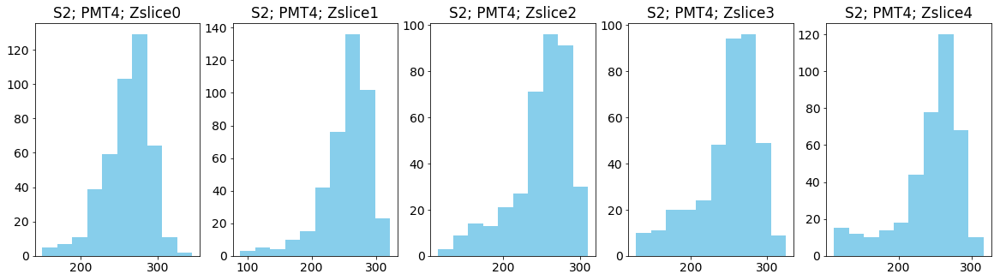

...

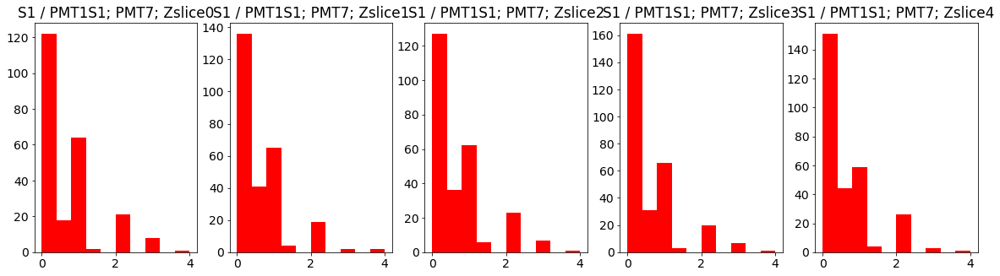

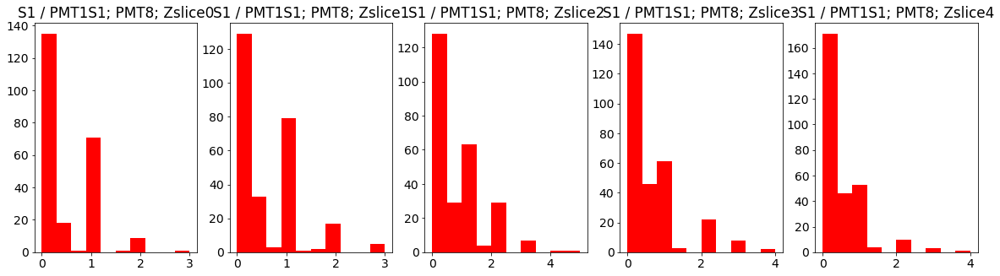

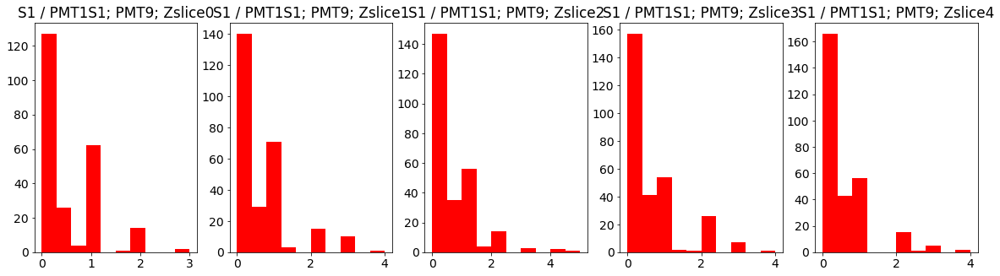

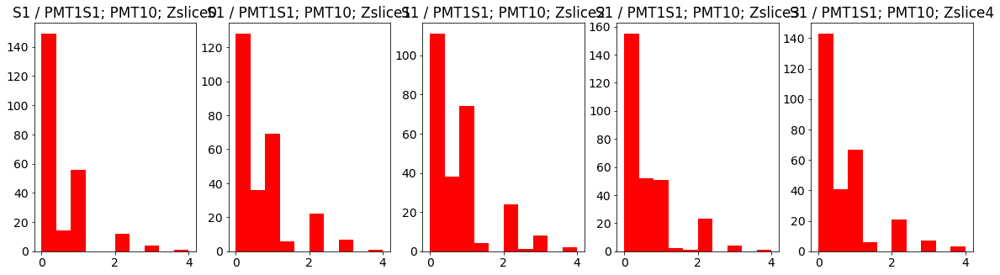

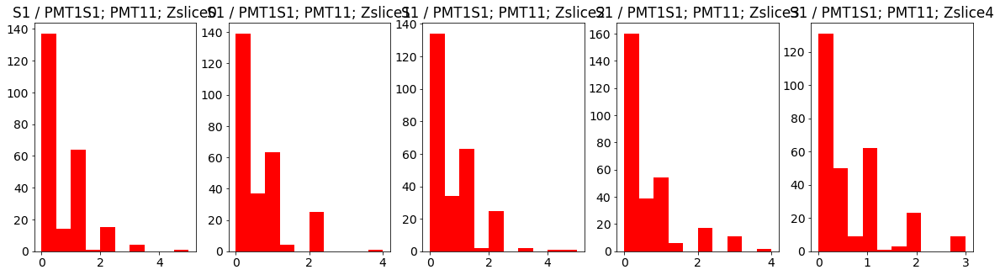

Data S2
[[ 830.29661017  827.46341463  810.68613139  825.23148148  811.448     ]
 [1037.61016949 1022.73170732 1012.23357664 1033.18518519 1018.6       ]
 [ 825.27966102  823.77235772  810.97810219  826.30555556  817.024     ]
 [ 545.24576271  542.26829268  534.80291971  545.4537037   534.096     ]
 [ 868.92372881  873.02439024  855.13138686  879.98148148  863.096     ]
 [ 728.38983051  719.72357724  711.86861314  722.67592593  714.408     ]
 [ 646.42372881  643.00813008  633.20437956  649.85185185  634.68      ]
 [ 635.53389831  634.91869919  622.79562044  636.2962963   629.24      ]
 [ 749.83898305  744.82926829  727.95620438  743.37037037  736.528     ]
 [ 640.24576271  637.58536585  626.67153285  642.40740741  635.952     ]
 [ 745.54237288  746.91056911  734.37956204  752.82407407  738.952     ]
 [ 626.08474576  625.02439024  608.37226277  631.57407407  611.216     ]]
Data S1
[[0.21186441 0.44715447 0.54014599 0.67592593 0.736     ]
 [0.38983051 0.59349593 1.06569343 1.02777778 0.9

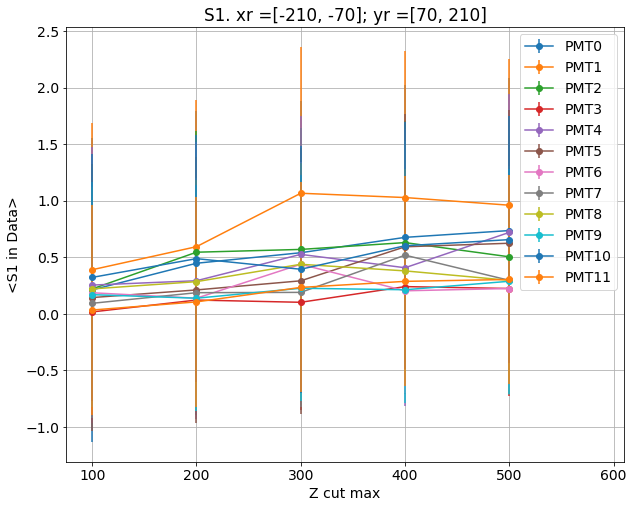

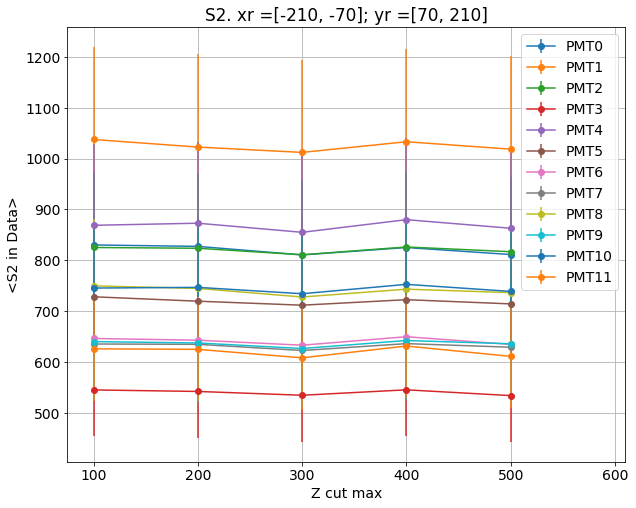

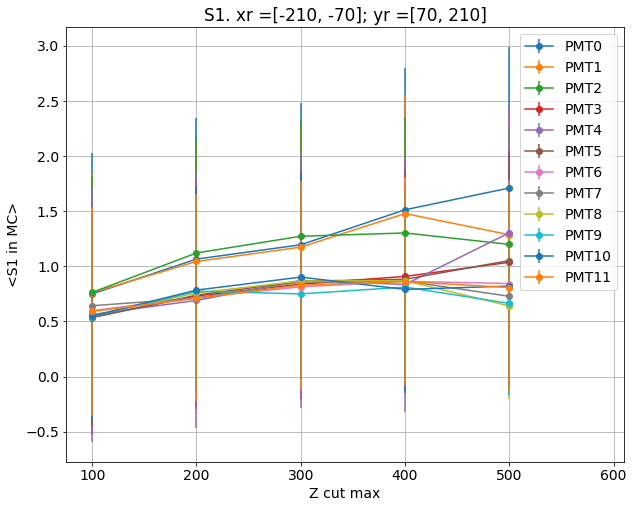

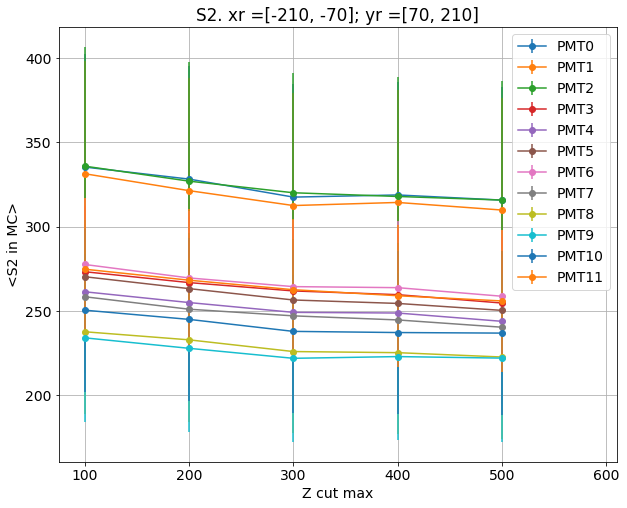

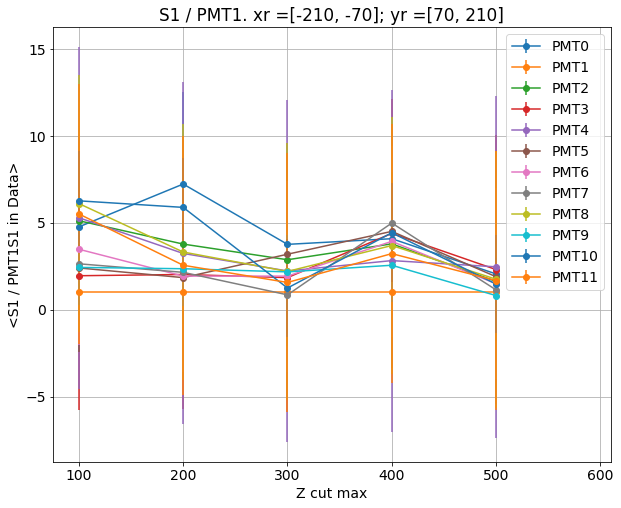

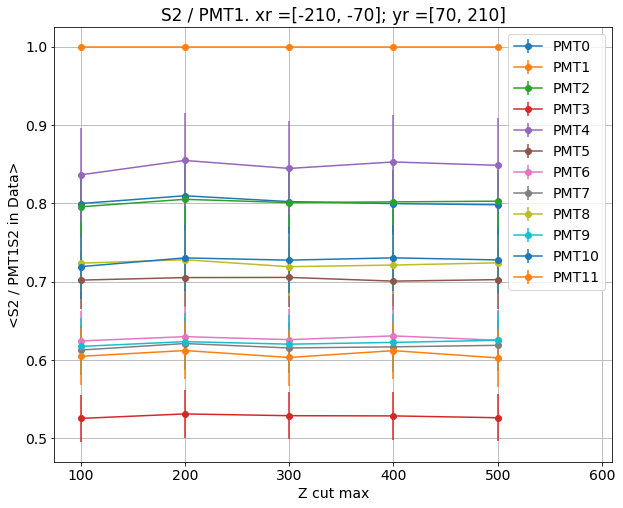

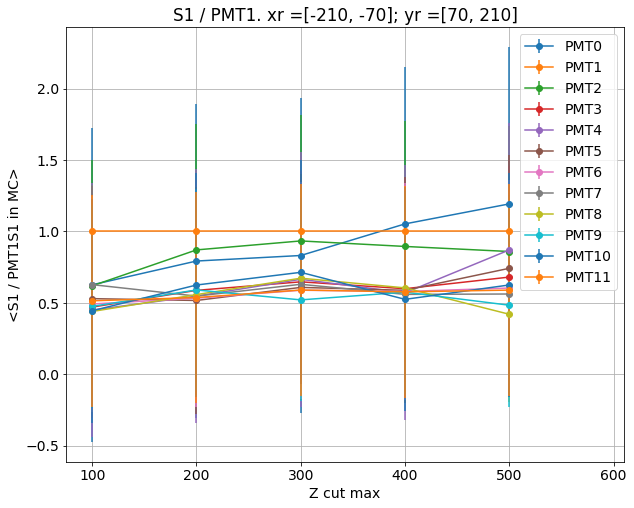

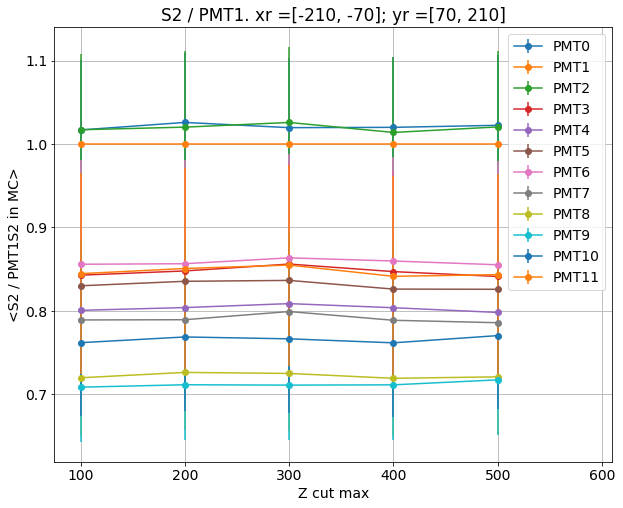

Dividing S2s
Dividing S1s


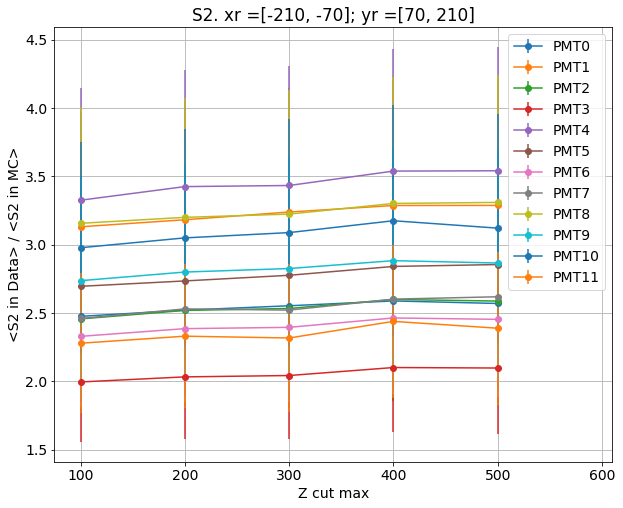

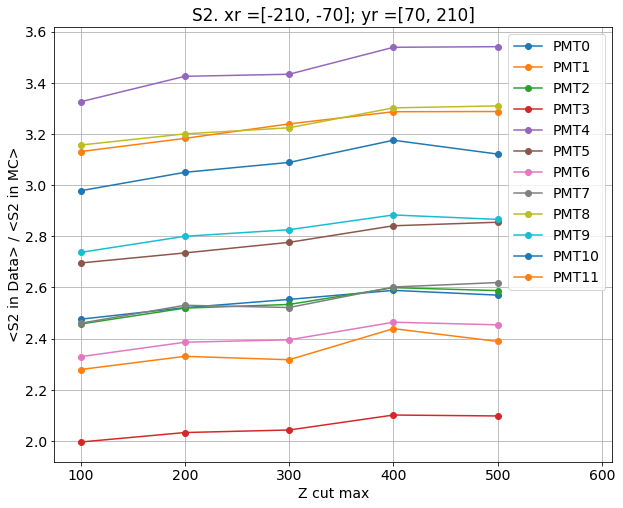

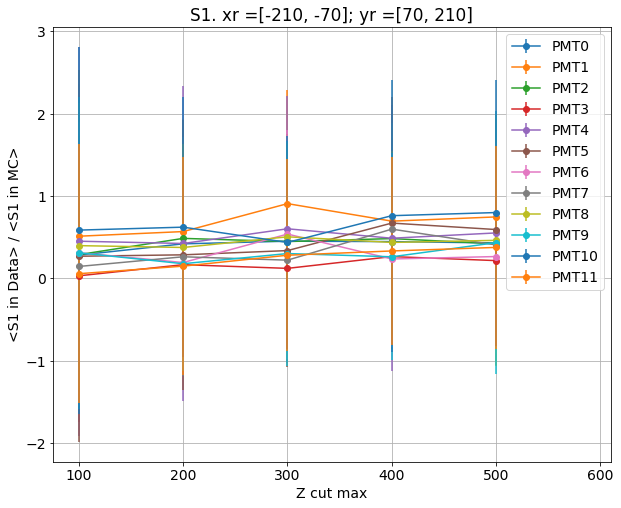

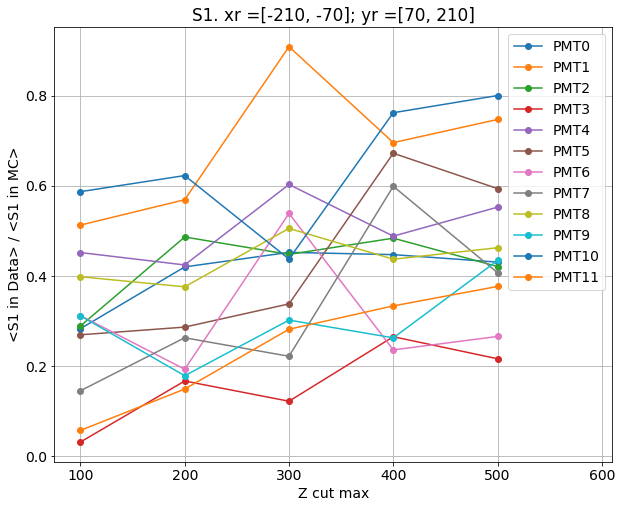

xr = [-70, 70] ; yr = [-210, -70]
calculating data...


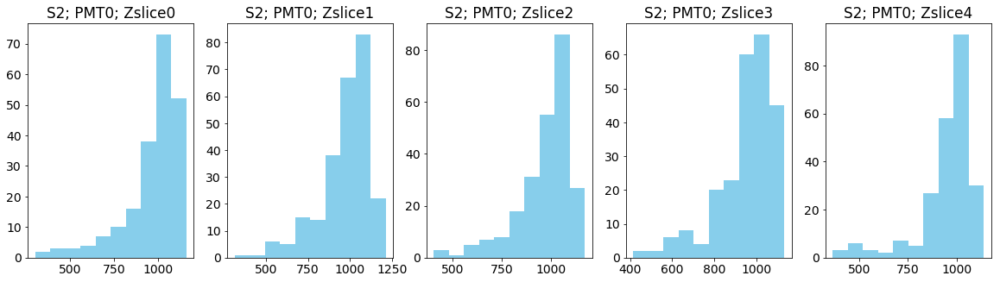

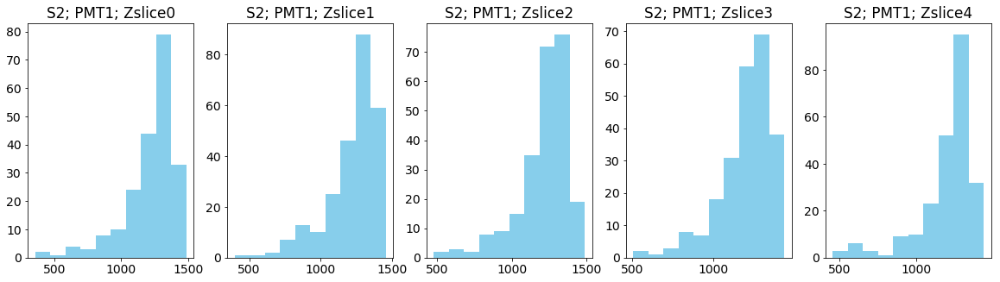

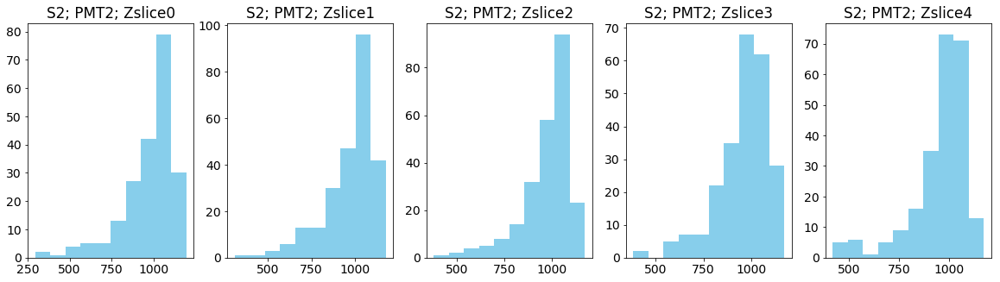

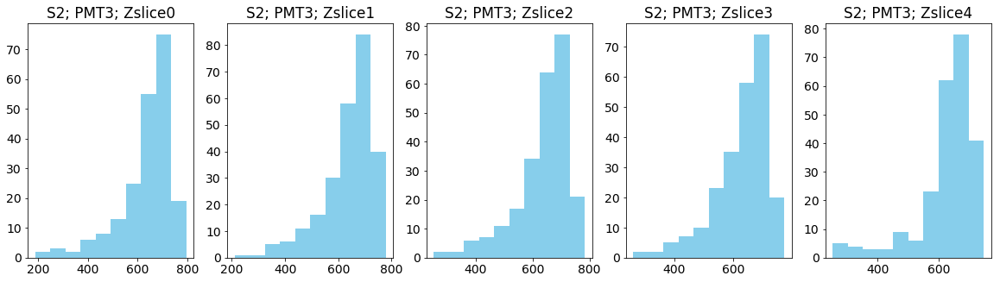

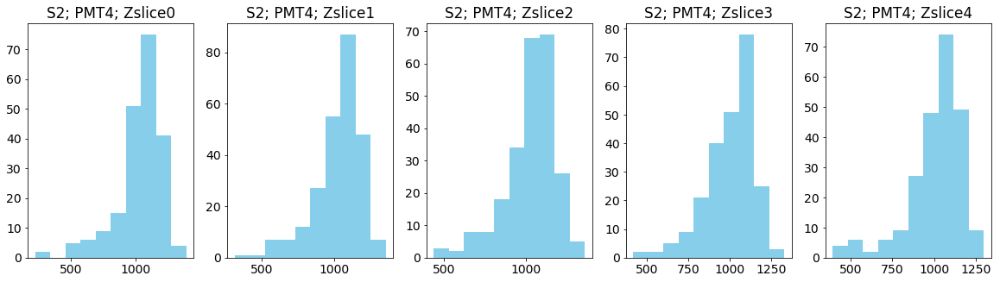

...

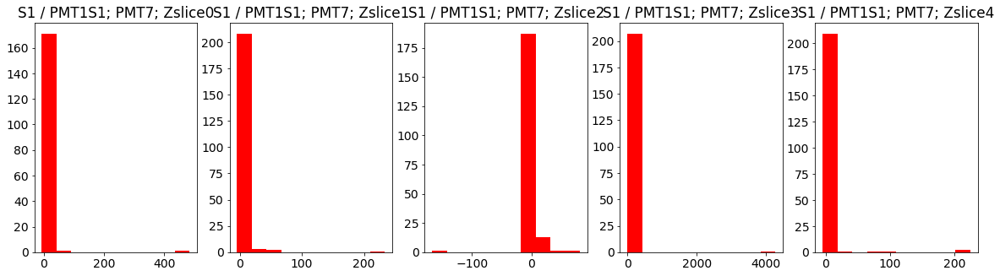

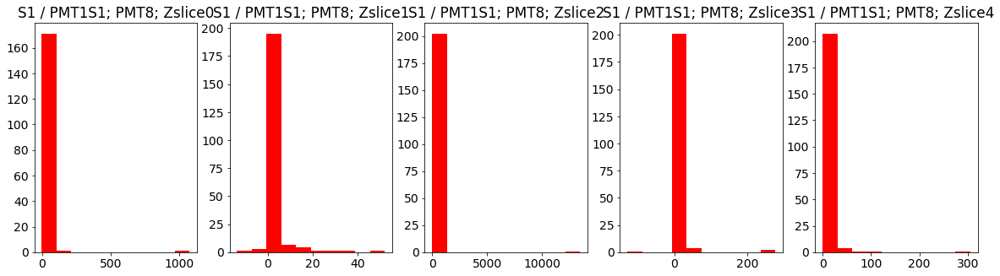

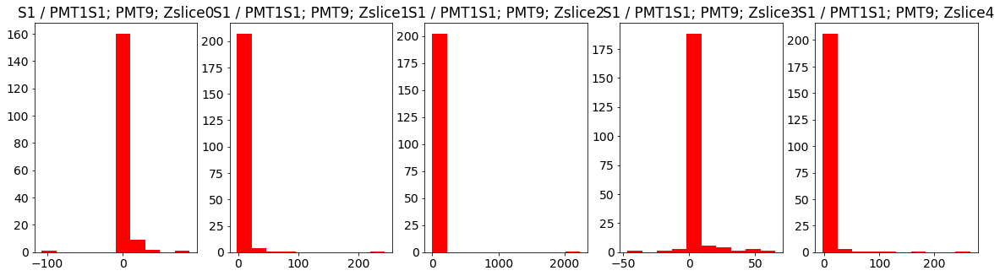

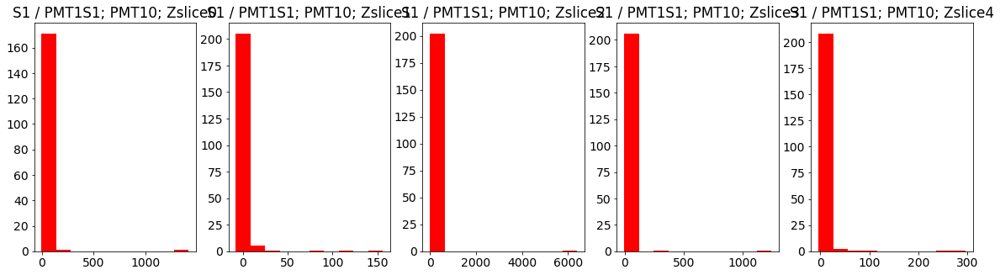

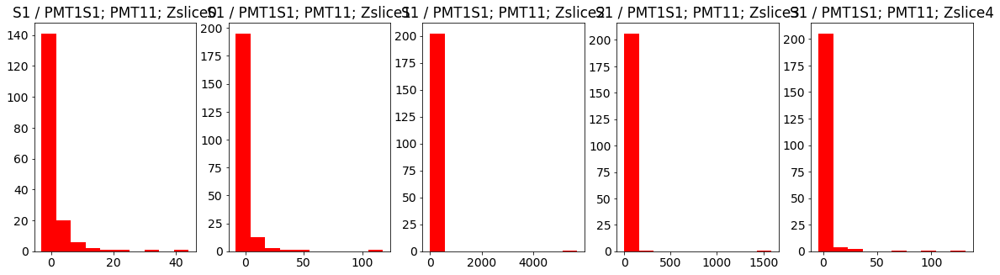

Calculated S2 matrix =
[[0.7944354, 0.7984422, 0.796583, 0.7939798, 0.7891453], [1.0, 1.0, 1.0, 1.0, 1.0], [0.8001244, 0.7962568, 0.7989165, 0.79763424, 0.79460835], [0.5211907, 0.52291197, 0.5229702, 0.52182096, 0.52107775], [0.84160054, 0.8419646, 0.8484165, 0.8367582, 0.8367529], [0.6945094, 0.6944646, 0.69316095, 0.69337153, 0.68721676], [0.6215038, 0.6273432, 0.62058926, 0.62076336, 0.62018853], [0.62182456, 0.6235712, 0.6182647, 0.61881, 0.6190438], [0.72742534, 0.7247596, 0.7287804, 0.7256334, 0.72373104], [0.62693477, 0.6308163, 0.6280485, 0.62256753, 0.6244043], [0.7224877, 0.7304573, 0.7243099, 0.7226862, 0.72380877], [0.60015625, 0.5999264, 0.59898895, 0.5997819, 0.5965225]]
calculating mc...


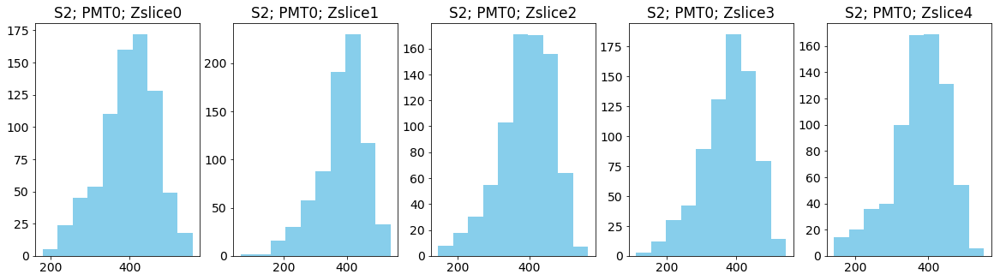

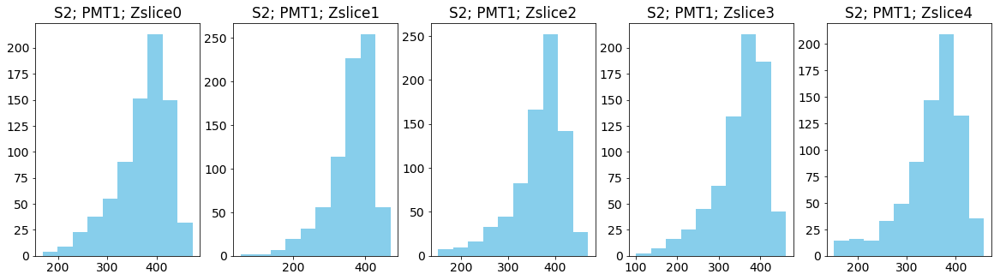

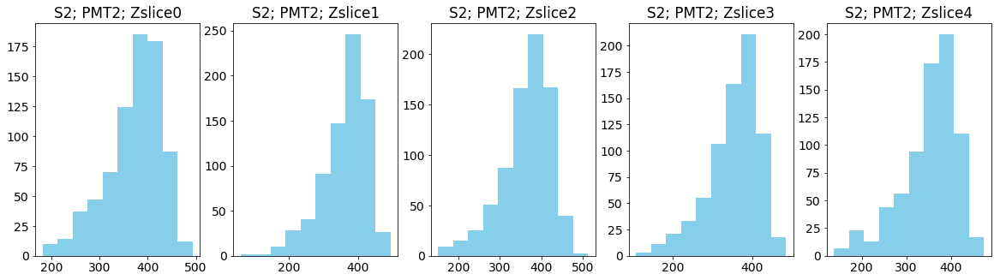

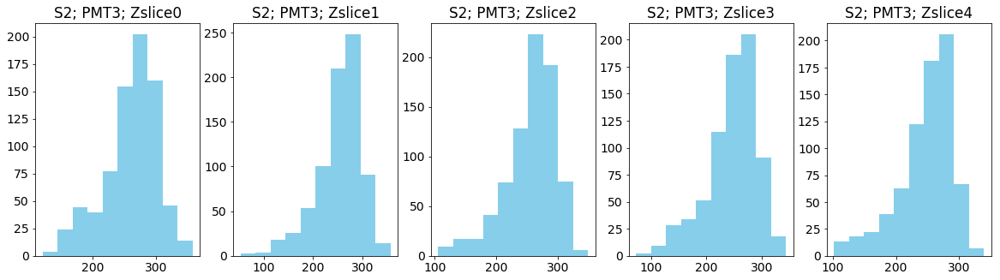

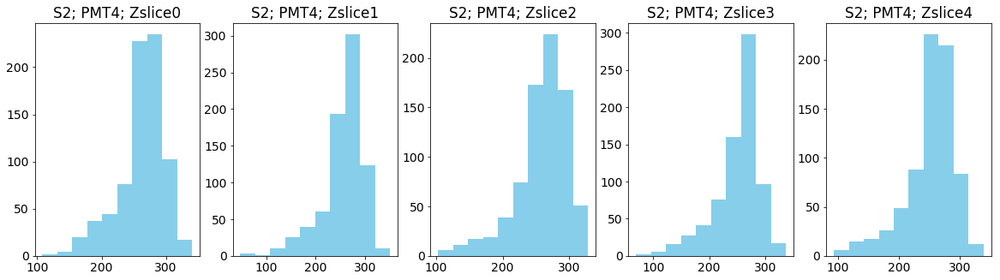

...

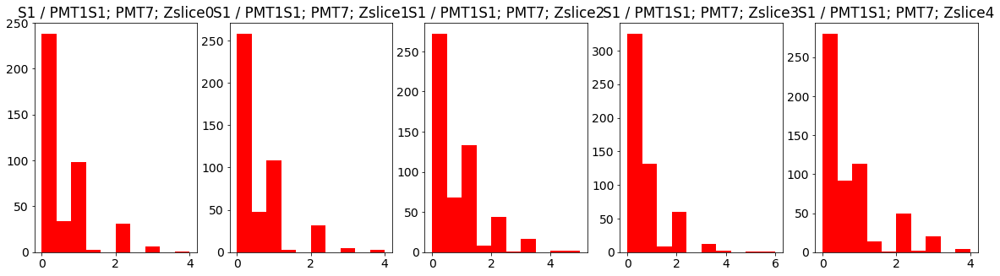

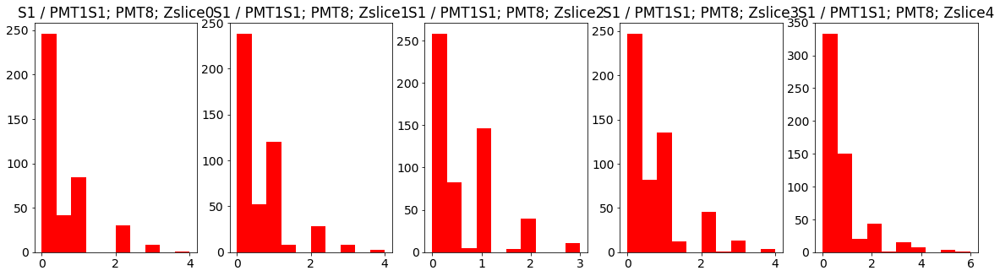

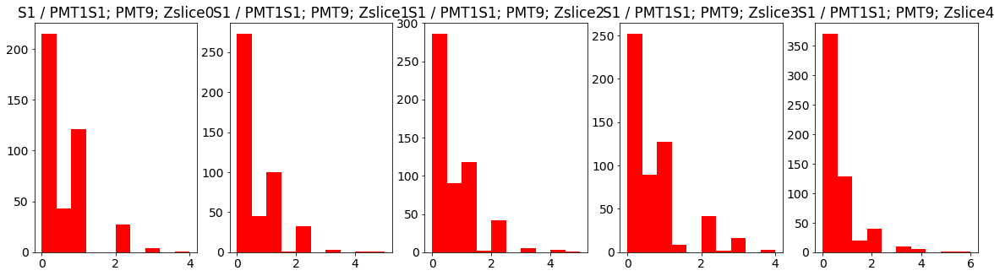

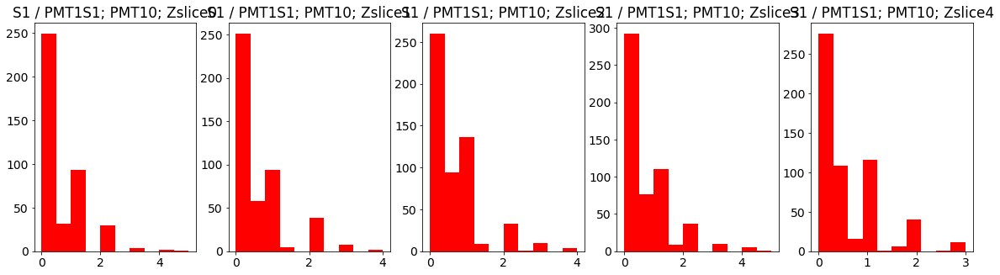

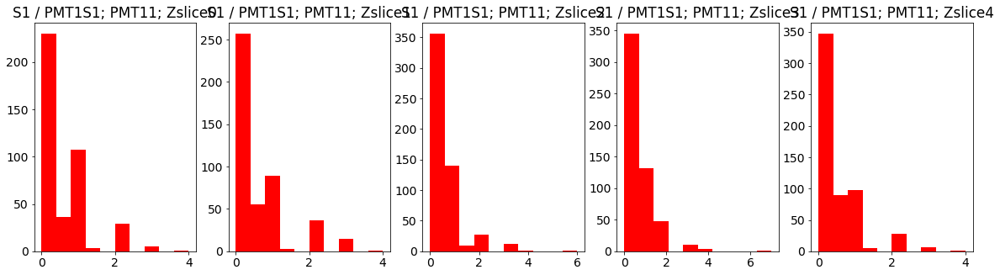

Data S2
[[ 967.23076923  972.76190476  969.78008299  954.22457627  947.12393162]
 [1217.40865385 1218.25396825 1218.54356846 1201.99576271 1202.        ]
 [ 973.06730769  969.03968254  971.55186722  958.04661017  953.27777778]
 [ 634.41346154  636.53571429  637.02904564  626.91101695  625.49145299]
 [1026.21634615 1024.99603175 1032.87551867 1005.08050847 1004.52136752]
 [ 844.78365385  845.          843.5560166   833.11440678  824.32051282]
 [ 755.63461538  762.51587302  754.70124481  745.16949153  743.03418803]
 [ 757.10576923  757.86507937  752.48962656  742.82627119  741.93162393]
 [ 885.35576923  881.26190476  885.84232365  871.18644068  868.41025641]
 [ 762.18269231  766.69047619  763.4813278   747.05508475  748.48717949]
 [ 879.05769231  888.82539683  881.43983402  868.06779661  868.28205128]
 [ 730.13942308  730.38095238  728.94190871  720.46186441  715.62393162]]
Data S1
[[0.33173077 0.36507937 0.53941909 0.63559322 0.61111111]
 [0.58173077 0.76190476 0.76763485 0.91101695 1.2

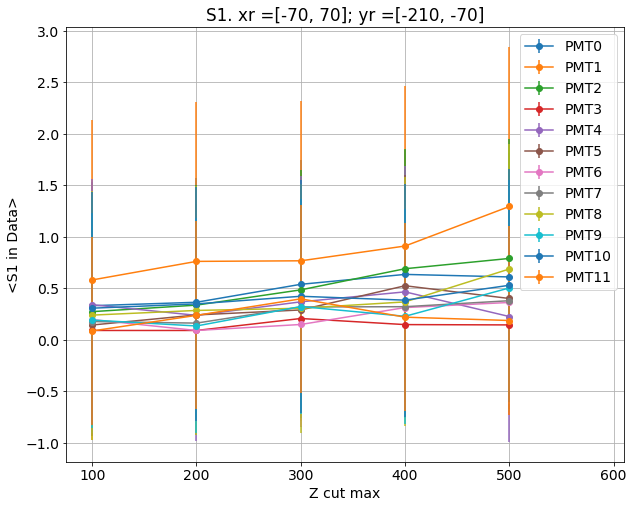

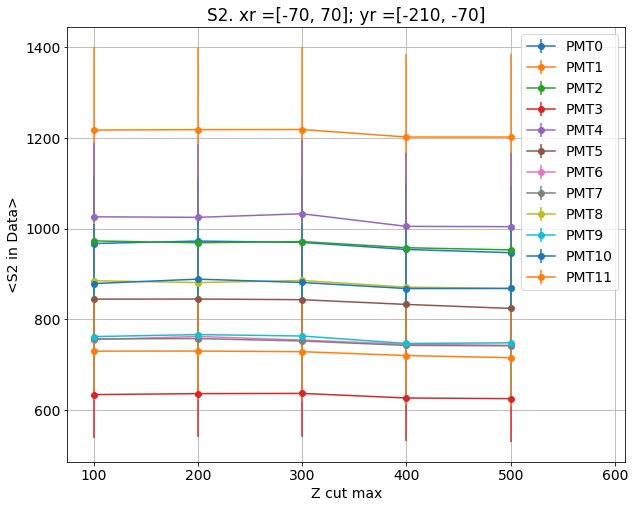

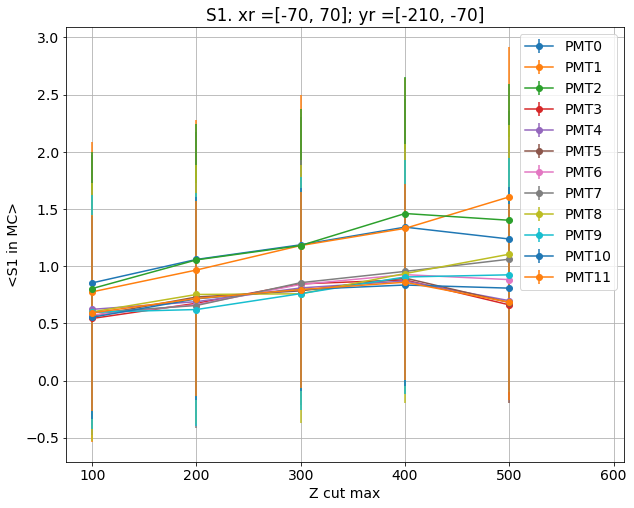

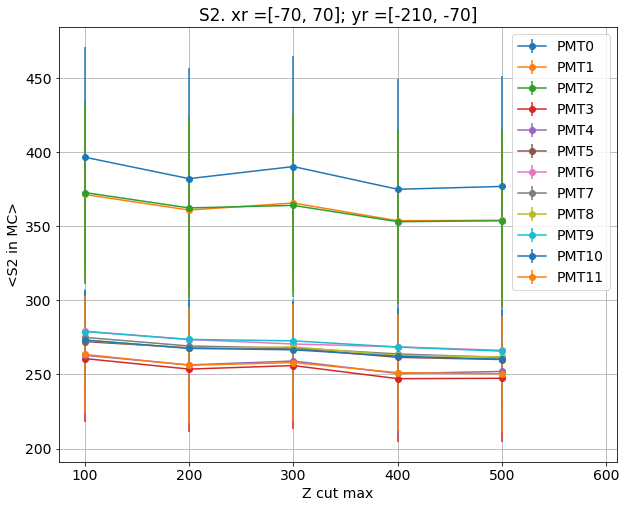

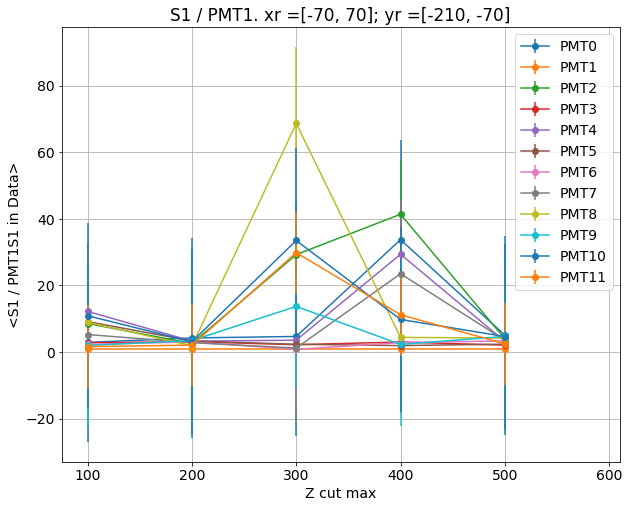

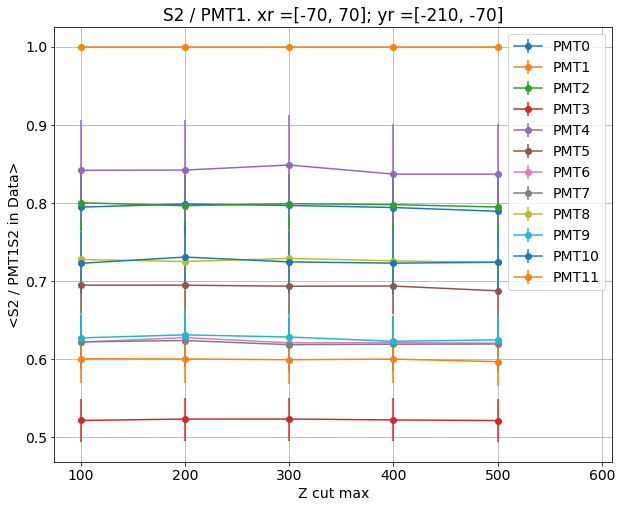

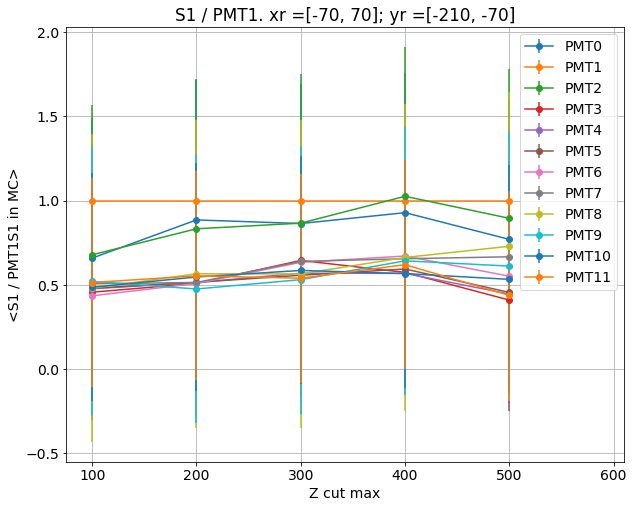

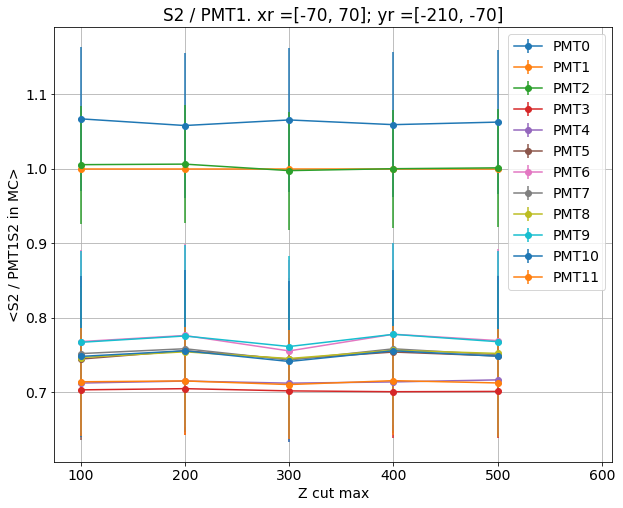

Dividing S2s
Dividing S1s


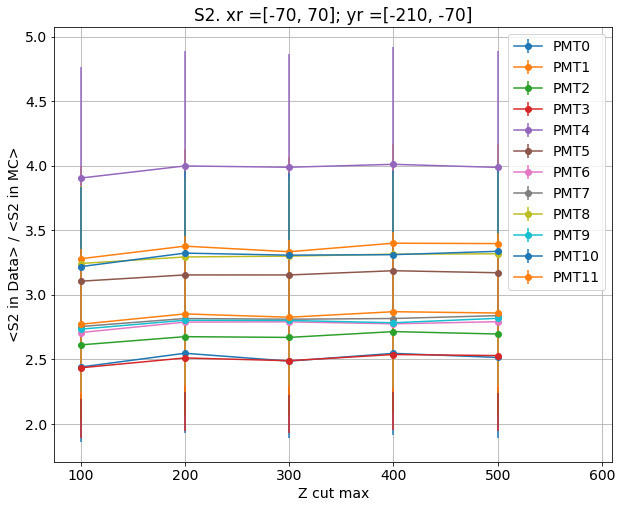

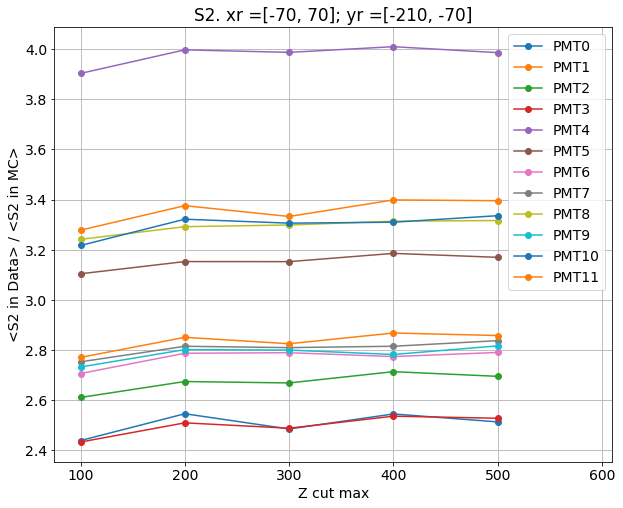

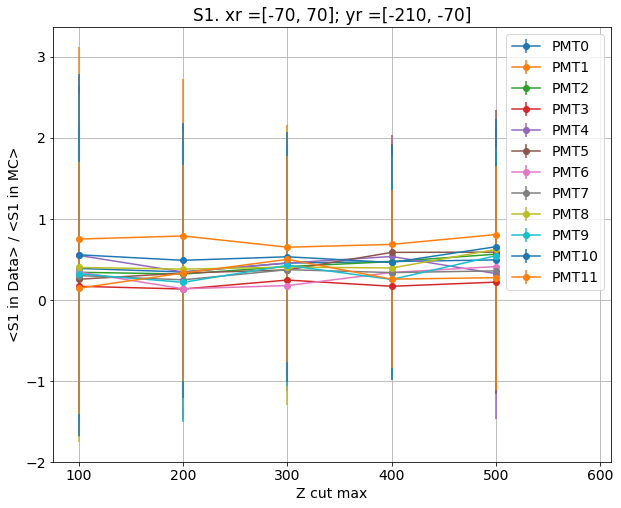

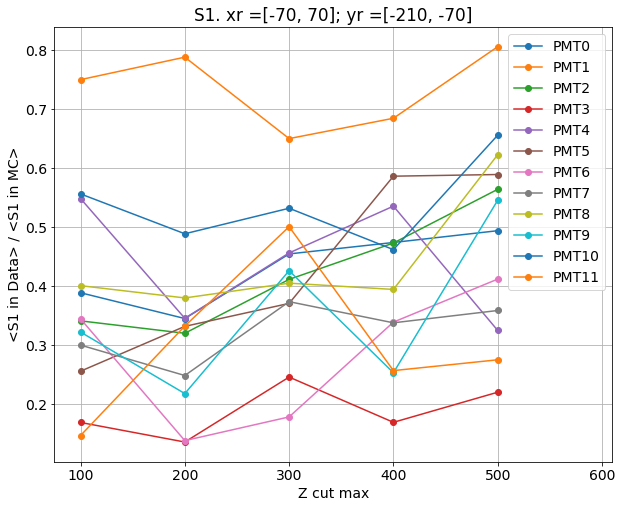

xr = [-70, 70] ; yr = [-70, 70]
calculating data...


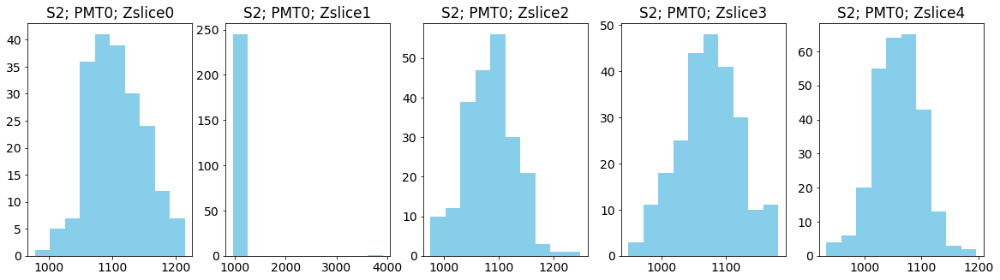

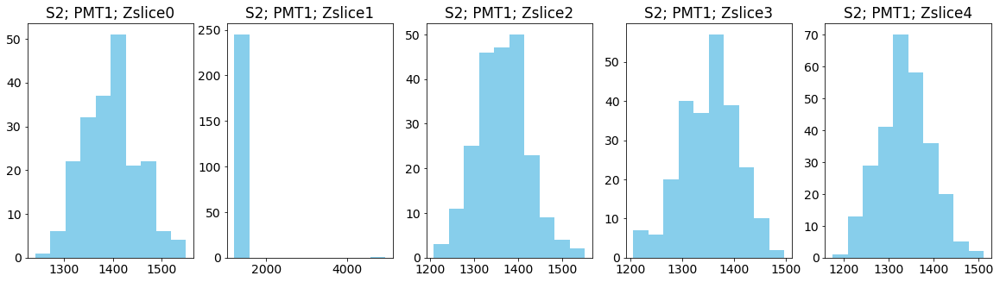

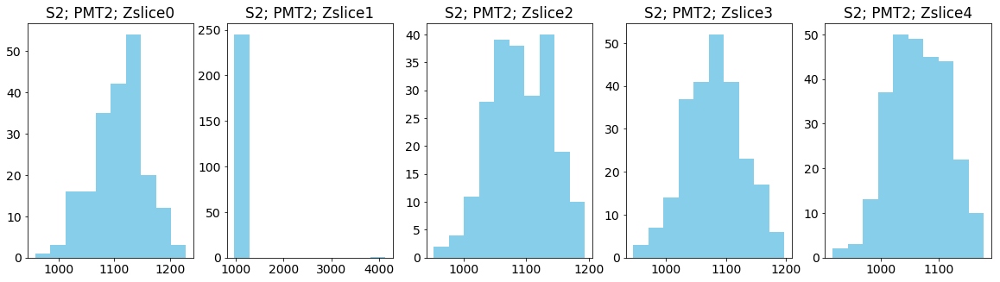

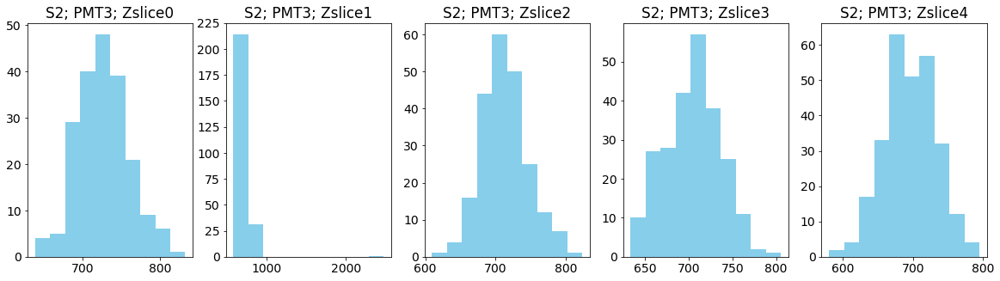

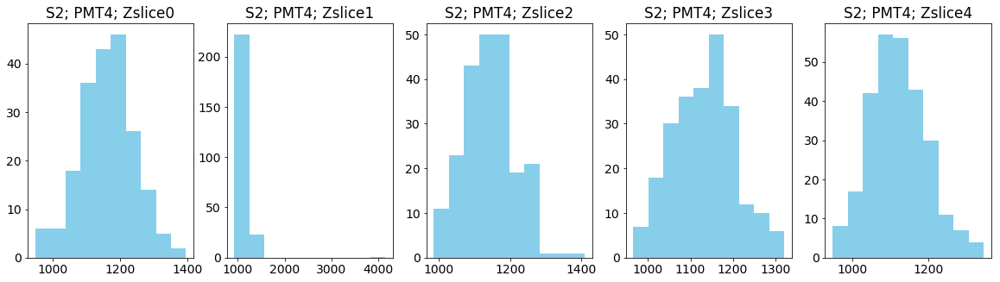

...

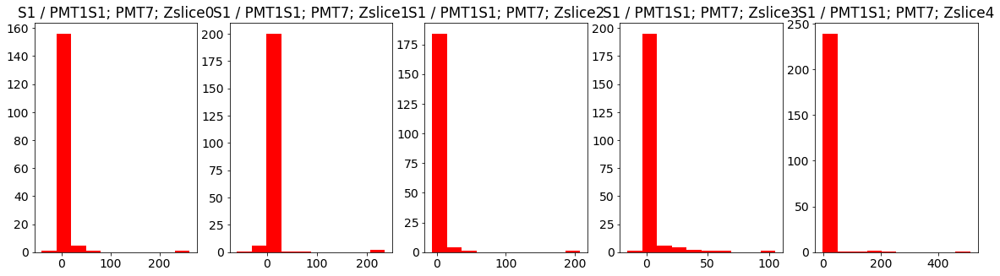

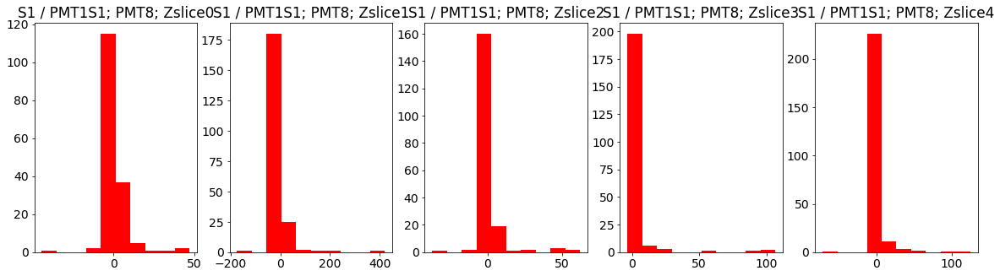

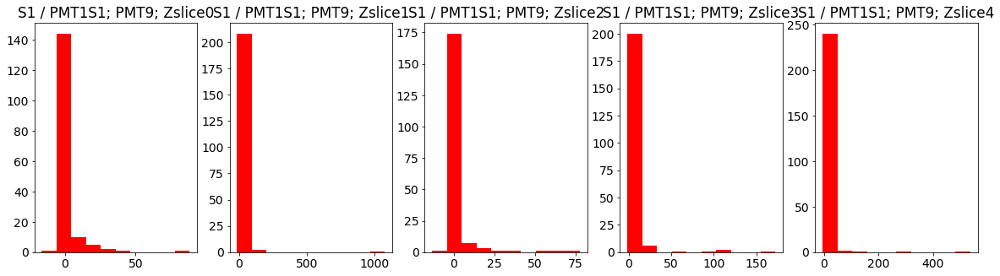

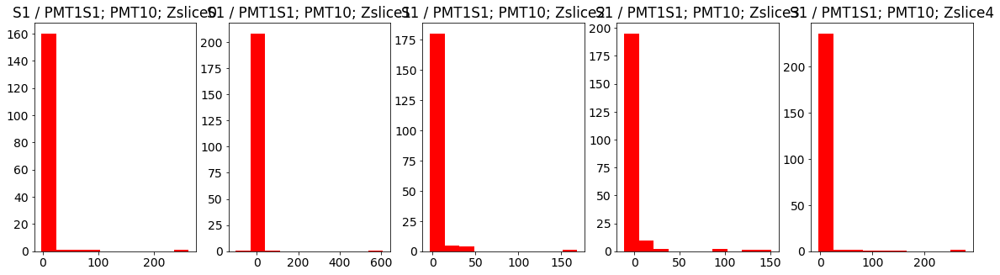

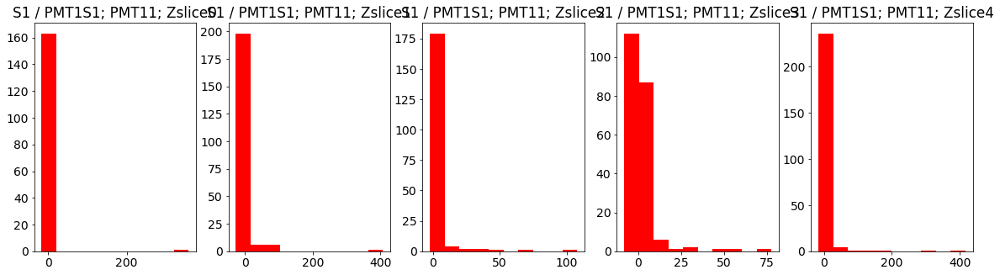

Calculated S2 matrix =
[[0.793454, 0.79341835, 0.796826, 0.7947092, 0.7931524], [1.0, 1.0, 1.0, 1.0, 1.0], [0.79563767, 0.793981, 0.8008964, 0.79909843, 0.7982179], [0.5215093, 0.51958734, 0.5238723, 0.5219213, 0.52045035], [0.83255506, 0.83217055, 0.83886355, 0.83774924, 0.83990425], [0.68757904, 0.68720657, 0.6894215, 0.6897858, 0.68689245], [0.611965, 0.61466366, 0.6173661, 0.6149731, 0.6173584], [0.6113618, 0.61157846, 0.61295897, 0.61598986, 0.6143792], [0.71689487, 0.7193091, 0.72387874, 0.71964794, 0.719697], [0.6199174, 0.61761314, 0.61978775, 0.62055343, 0.61940795], [0.7191485, 0.7197555, 0.7205722, 0.7213137, 0.7186428], [0.59506565, 0.5933417, 0.5956428, 0.59685045, 0.5973996]]
calculating mc...


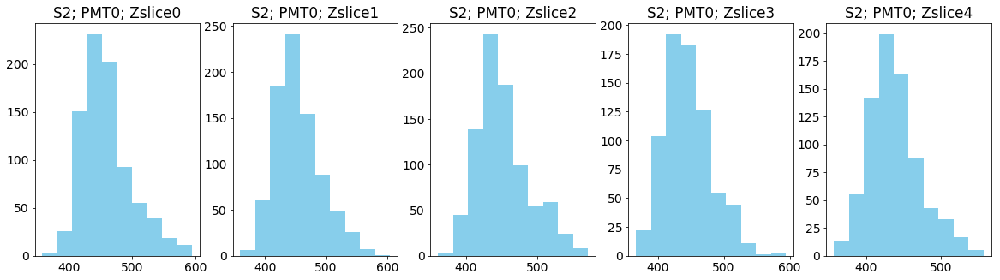

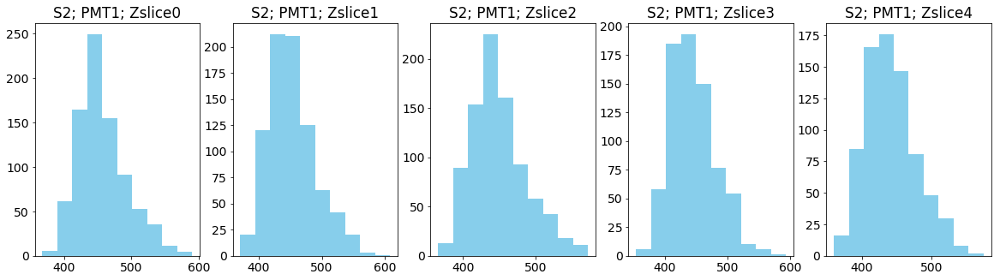

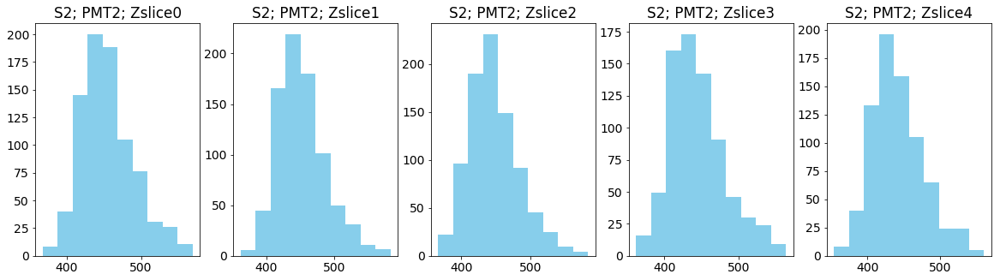

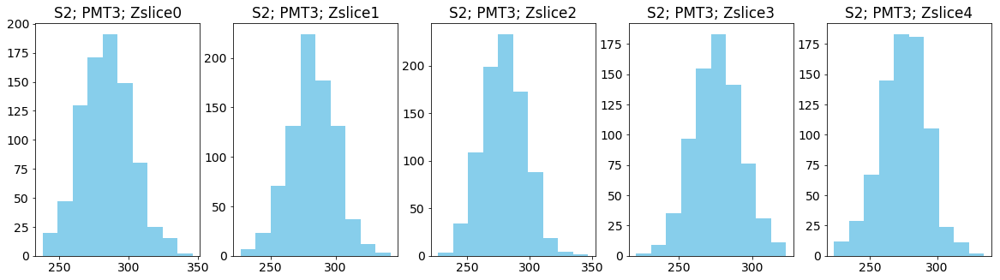

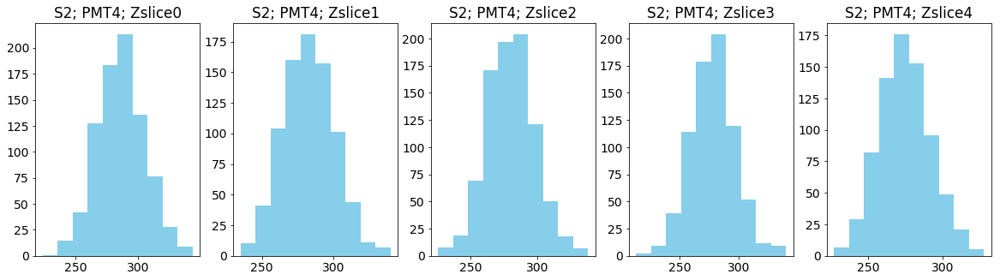

...

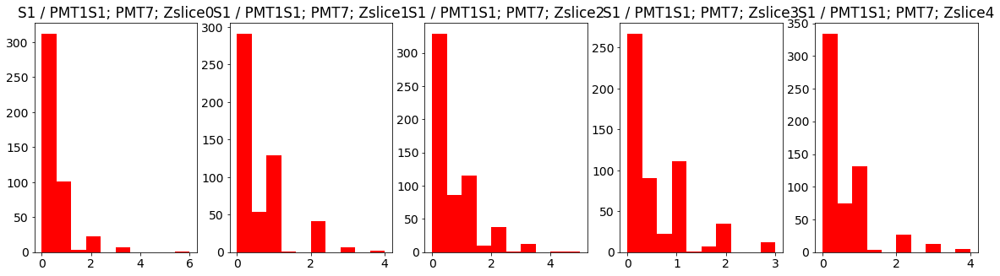

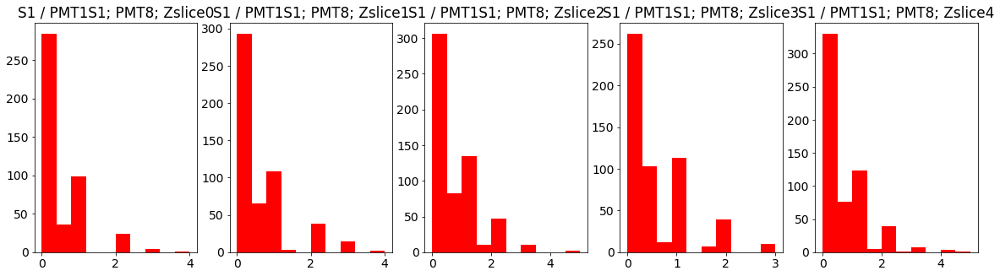

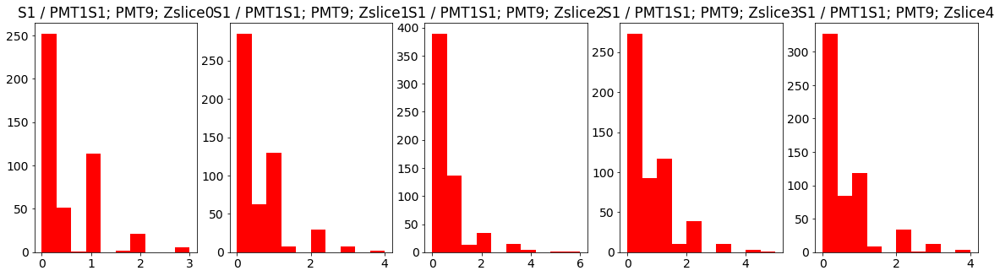

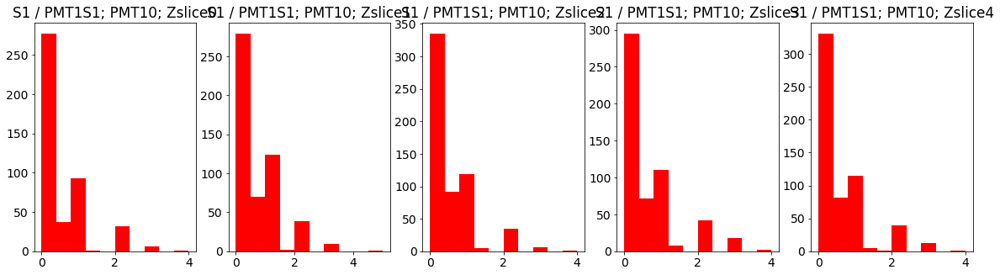

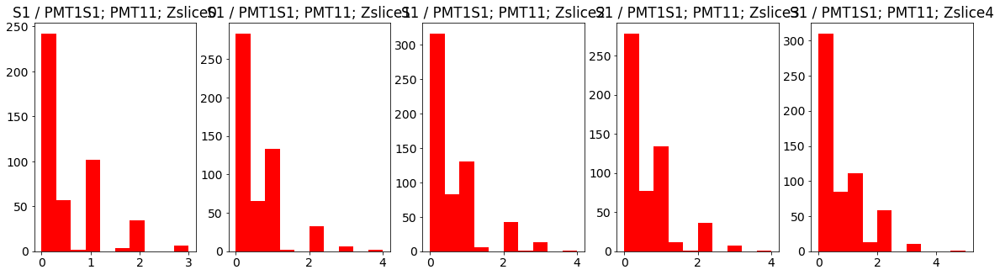

Data S2
[[1105.30693069 1107.02439024 1084.58181818 1073.17012448 1058.58181818]
 [1394.43564356 1396.69105691 1362.60454545 1351.45643154 1336.24      ]
 [1108.30693069 1108.59756098 1090.12272727 1078.90871369 1065.57454545]
 [ 726.31188119  724.65447154  712.90909091  704.48547718  694.53454545]
 [1160.12871287 1161.22357724 1141.88636364 1131.26556017 1120.99636364]
 [ 958.04950495  958.7195122   938.28181818  931.42738589  916.65090909]
 [ 852.47029703  857.45528455  840.09090909  830.3153527   823.90181818]
 [ 851.64851485  853.12601626  834.21818182  831.72614108  819.93454545]
 [ 998.73267327 1003.22357724  985.16363636  971.48962656  960.50181818]
 [ 863.56930693  861.49186992  843.50454545  837.84232365  826.68727273]
 [1001.83168317 1003.90650407  980.77272727  973.76763485  959.04      ]
 [ 828.9009901   827.54471545  810.36818182  805.78008299  797.16      ]]
Data S1
[[0.35643564 0.42276423 0.48636364 0.67634855 0.62181818]
 [0.58415842 0.68699187 0.80909091 0.99170124 1.0

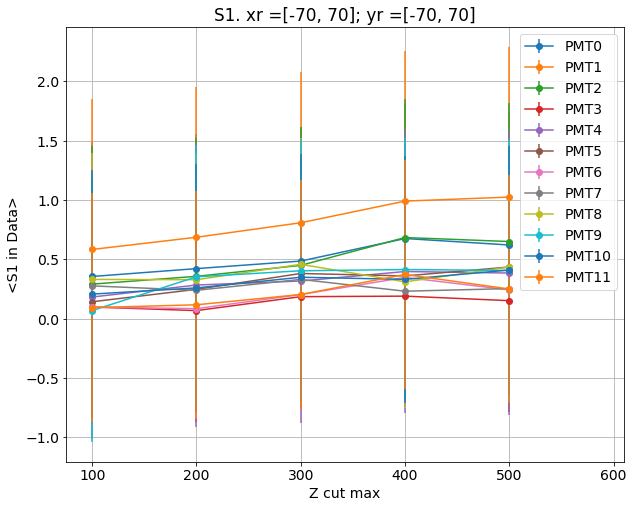

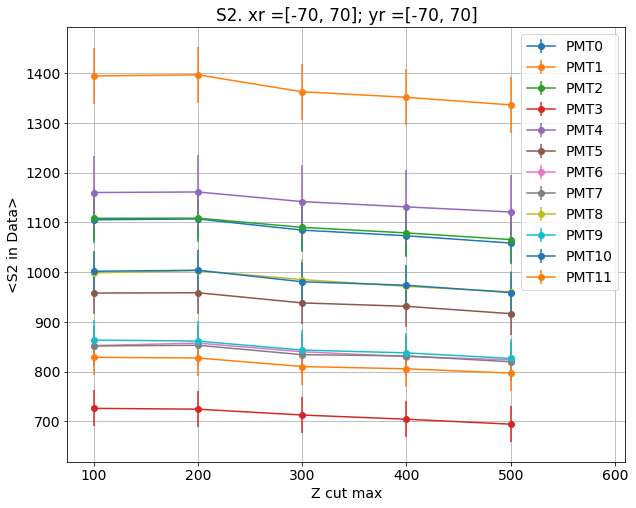

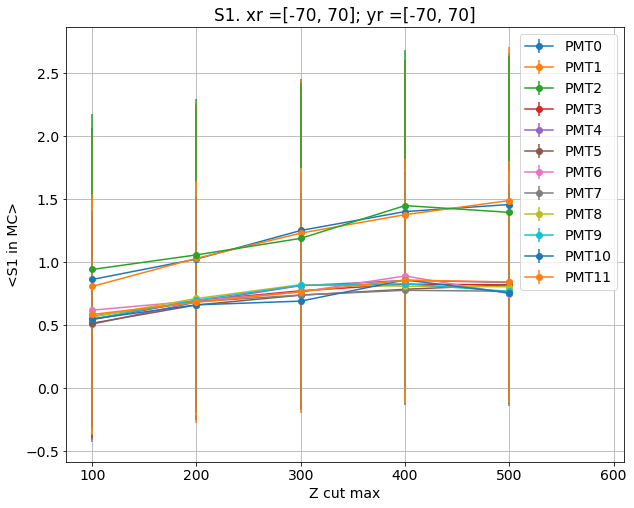

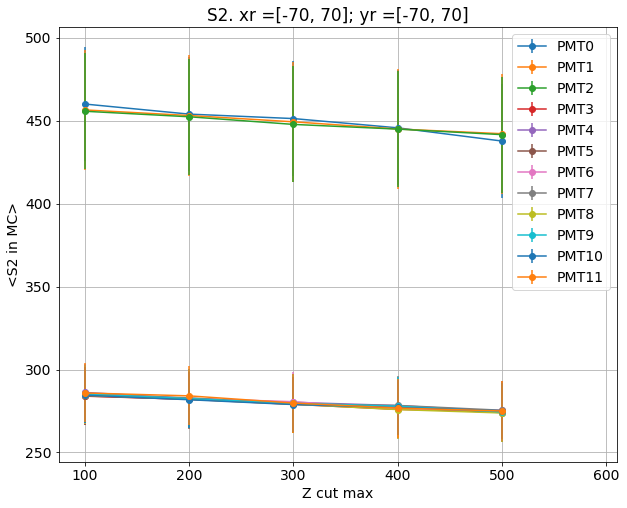

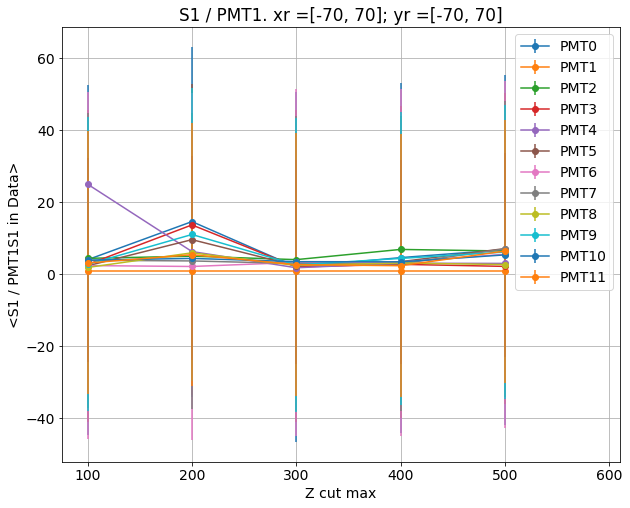

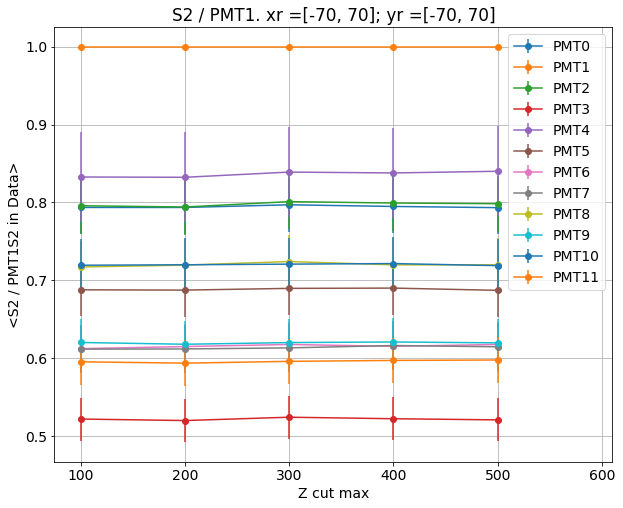

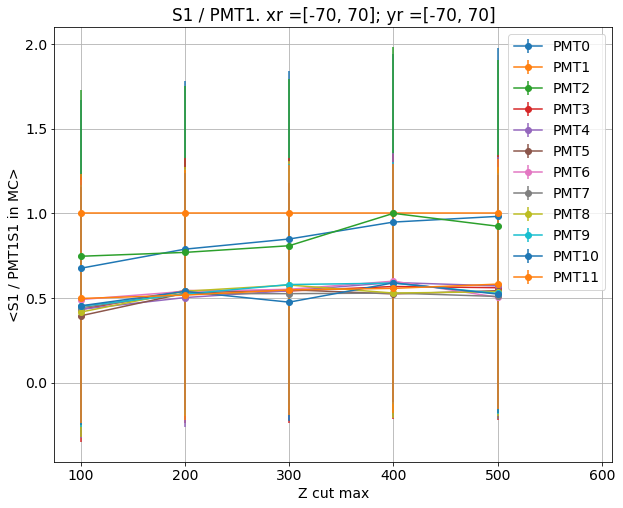

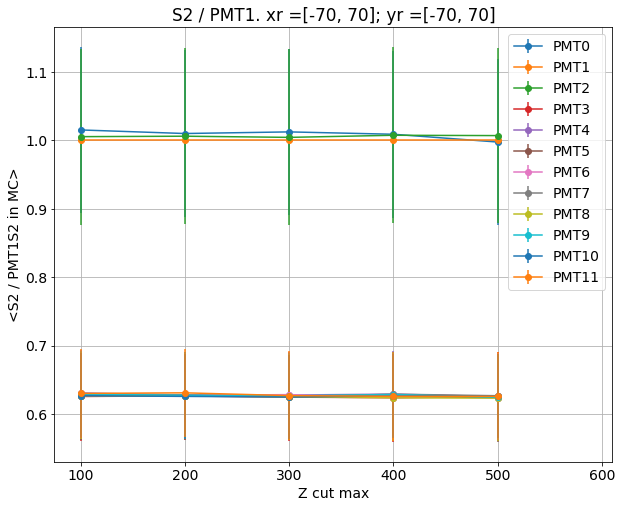

Dividing S2s
Dividing S1s


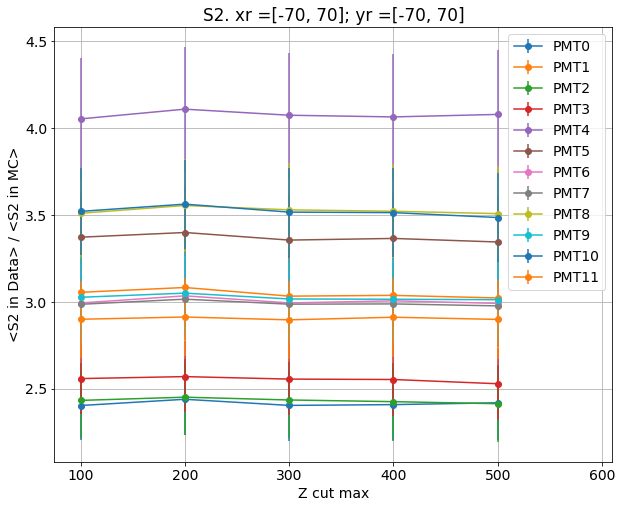

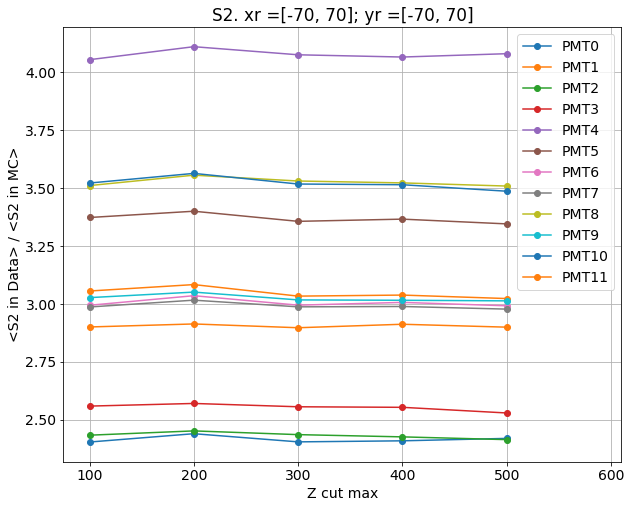

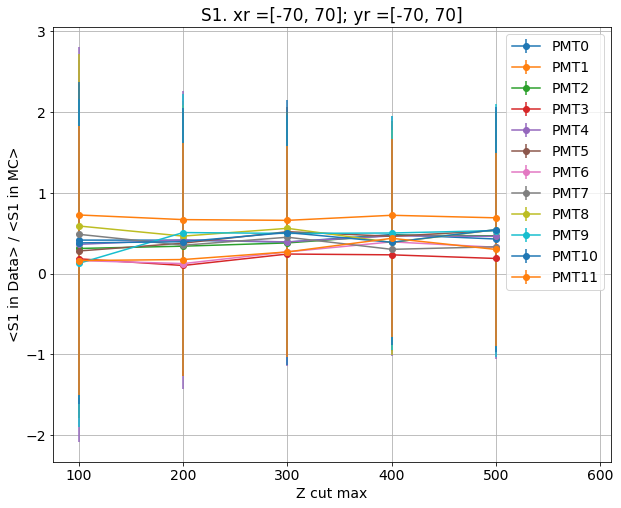

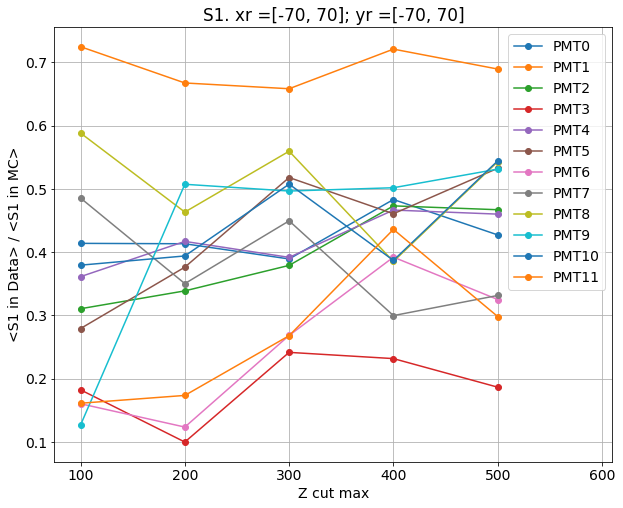

xr = [-70, 70] ; yr = [70, 210]
calculating data...


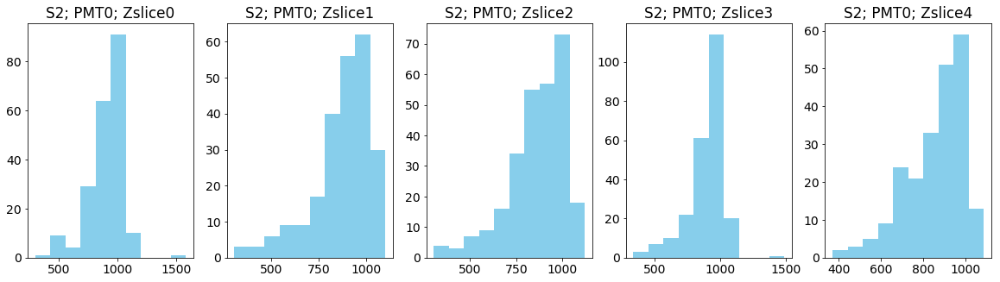

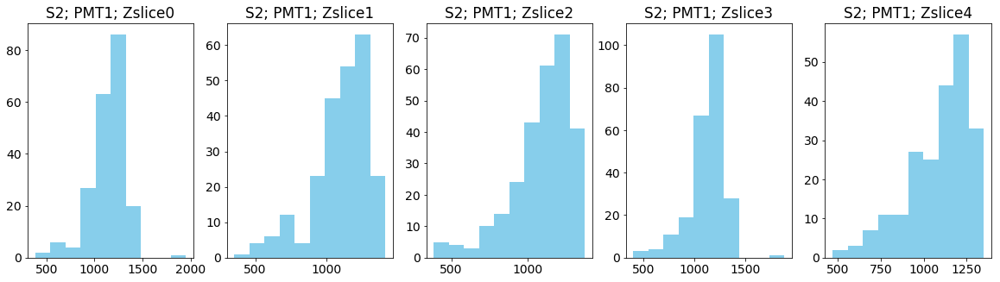

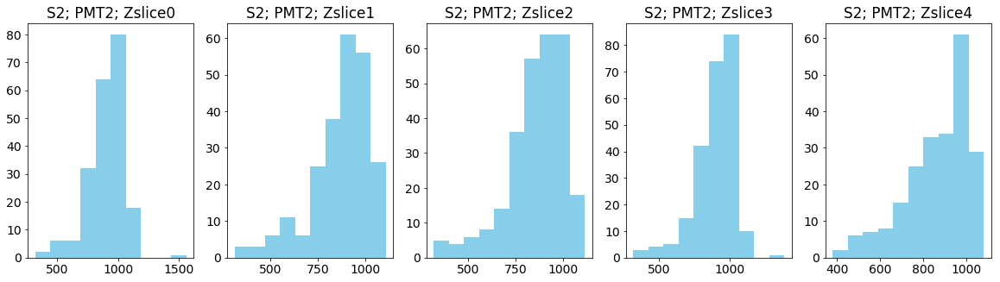

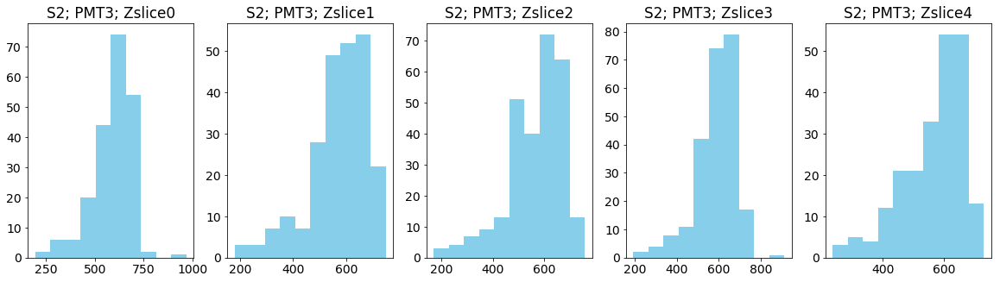

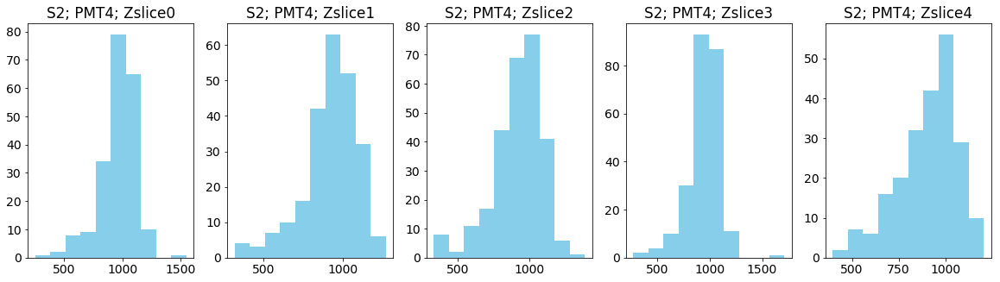

...

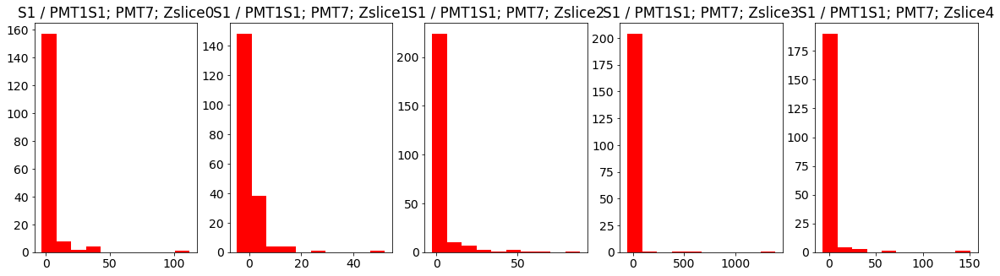

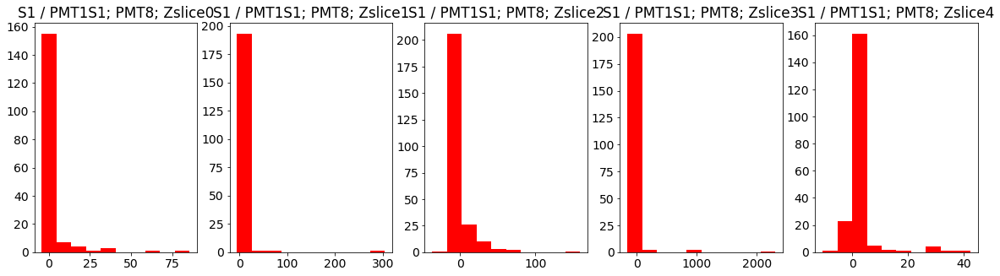

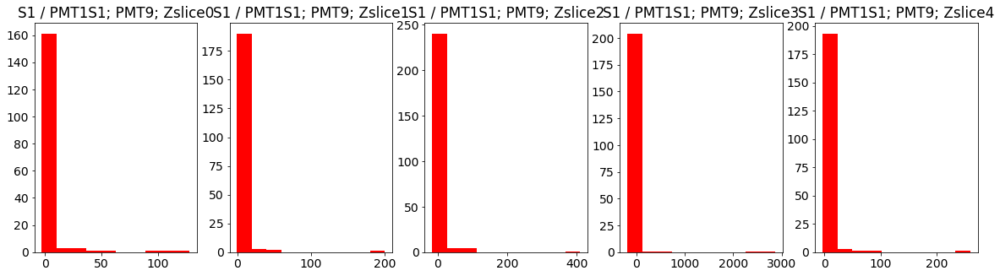

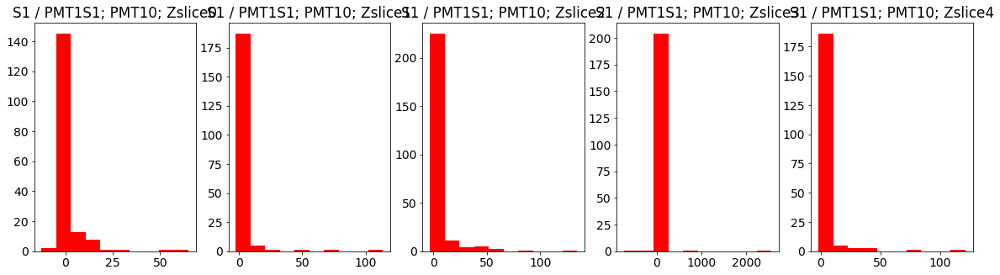

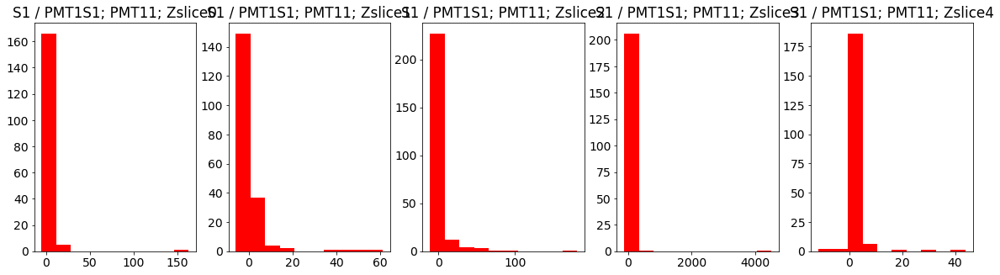

Calculated S2 matrix =
[[0.7920272, 0.79357105, 0.792568, 0.7927991, 0.7888196], [1.0, 1.0, 1.0, 1.0, 1.0], [0.7955823, 0.7913895, 0.78952223, 0.7930889, 0.7915733], [0.5163369, 0.5185073, 0.5196864, 0.5201258, 0.51819736], [0.8443329, 0.83614, 0.84466475, 0.8375663, 0.83530885], [0.68692476, 0.69004816, 0.6880687, 0.69053197, 0.6857932], [0.6146389, 0.6173108, 0.6141348, 0.61444694, 0.61619735], [0.6112421, 0.6130016, 0.61075497, 0.6091648, 0.6079738], [0.7180646, 0.71974975, 0.71523863, 0.7203104, 0.7184813], [0.61896825, 0.61791307, 0.6182622, 0.61680716, 0.6184588], [0.7223692, 0.722336, 0.7232047, 0.7229601, 0.7195439], [0.6002901, 0.60154074, 0.6005399, 0.59839636, 0.5990677]]
calculating mc...


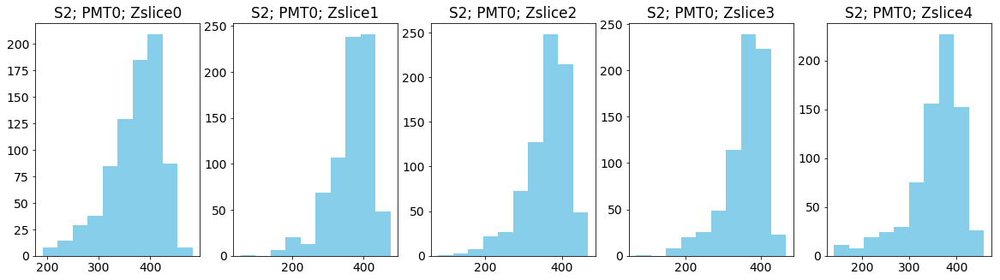

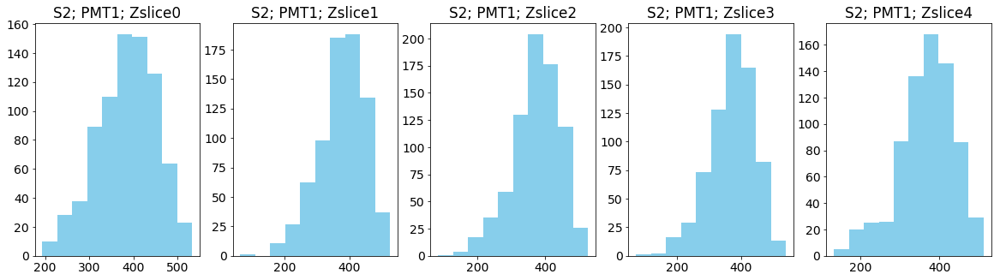

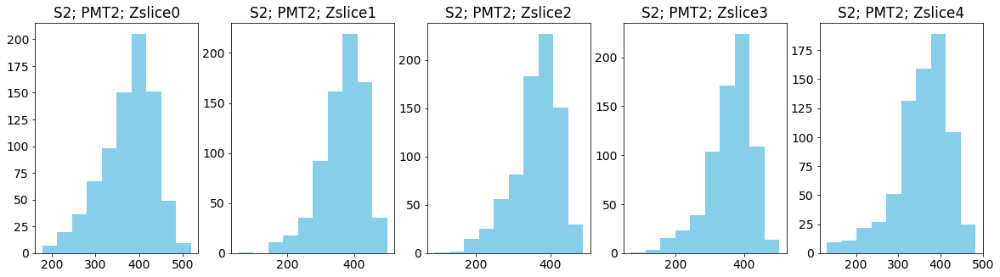

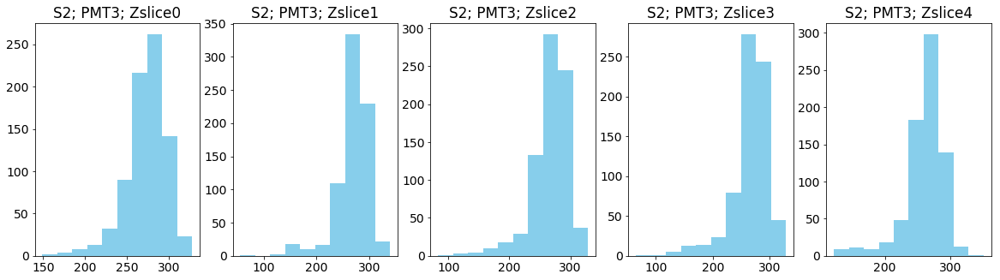

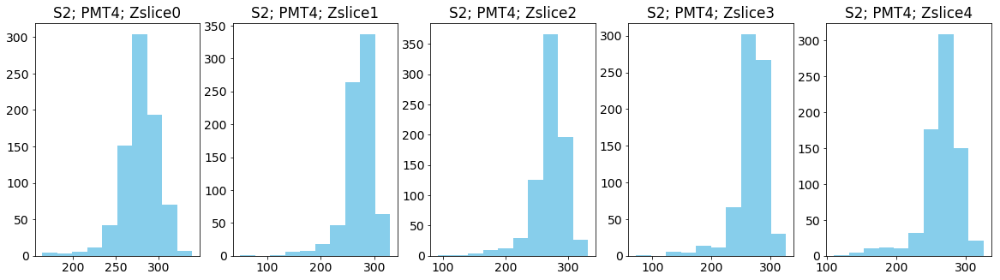

...

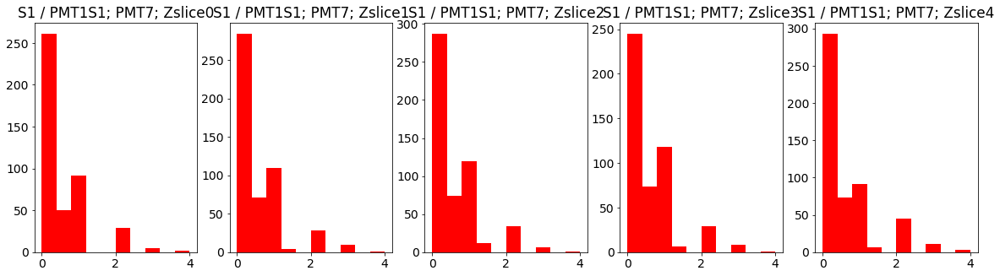

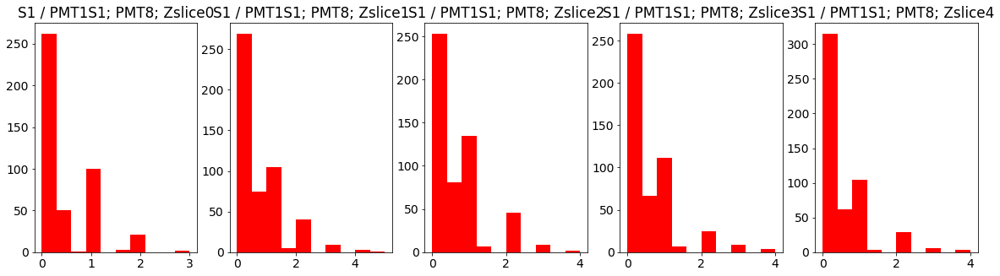

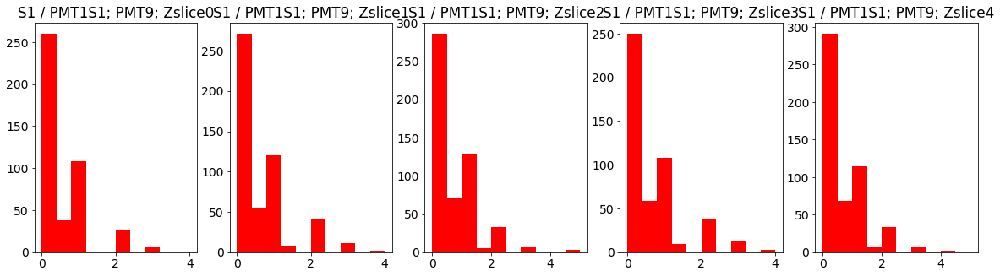

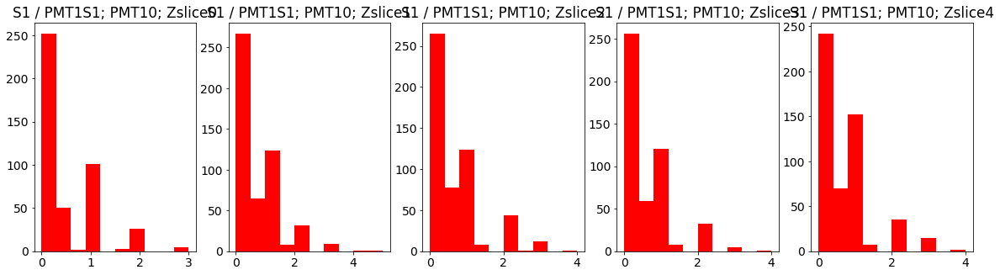

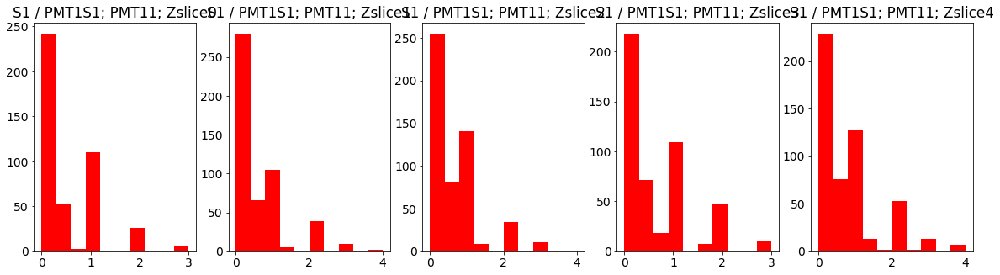

Data S2
[[ 903.78947368  872.34468085  865.79347826  896.0210084   858.05909091]
 [1142.26315789 1100.03829787 1094.23188406 1131.97478992 1089.81363636]
 [ 907.36363636  869.69361702  862.92028986  896.67647059  862.48181818]
 [ 590.09090909  570.77446809  568.72101449  588.38655462  564.55      ]
 [ 962.31100478  918.38723404  923.14855072  946.60504202  909.06363636]
 [ 783.0430622   756.55319149  751.37318841  780.30672269  746.68636364]
 [ 701.33014354  677.87659574  671.32608696  694.64285714  670.60909091]
 [ 697.94736842  673.75744681  667.18478261  687.93277311  662.07727273]
 [ 819.66028708  790.97446809  782.05797101  813.90756303  782.32727273]
 [ 706.40669856  678.60425532  675.92753623  696.61344538  673.45909091]
 [ 824.15789474  793.45106383  790.19565217  817.07142857  783.17272727]
 [ 684.5645933   660.66382979  655.66666667  675.90756303  651.39090909]]
Data S1
[[0.33971292 0.47659574 0.4673913  0.6512605  0.92727273]
 [0.50717703 0.72765957 0.87318841 0.83193277 1.1

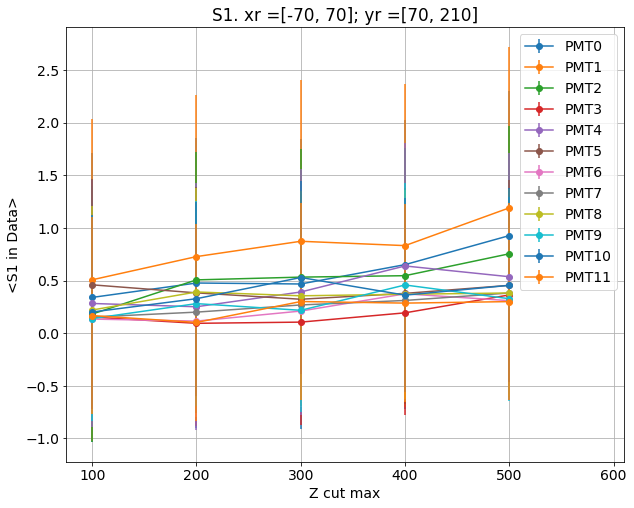

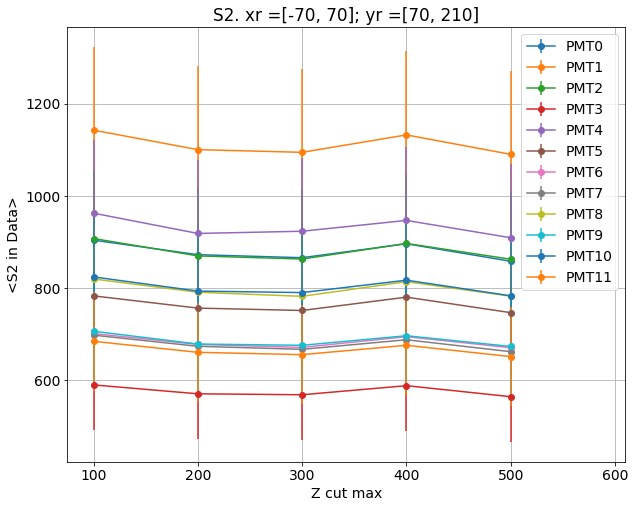

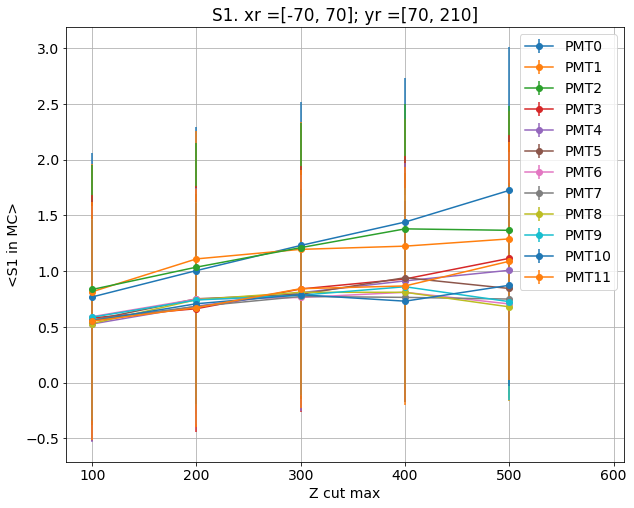

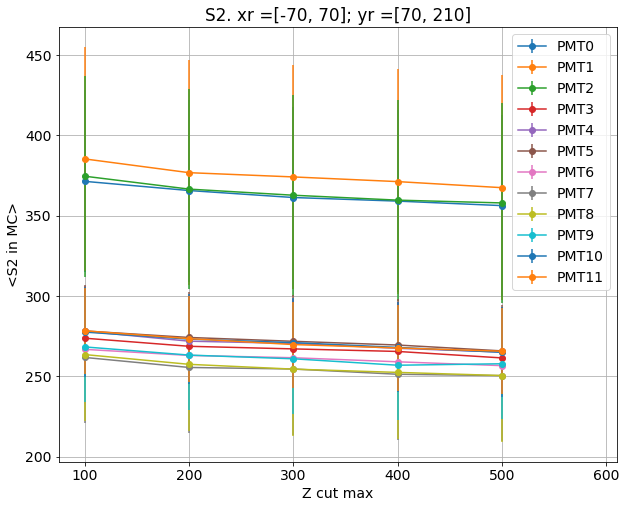

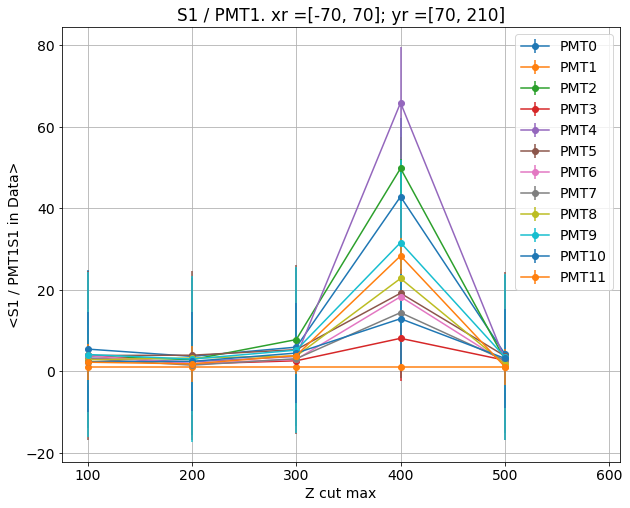

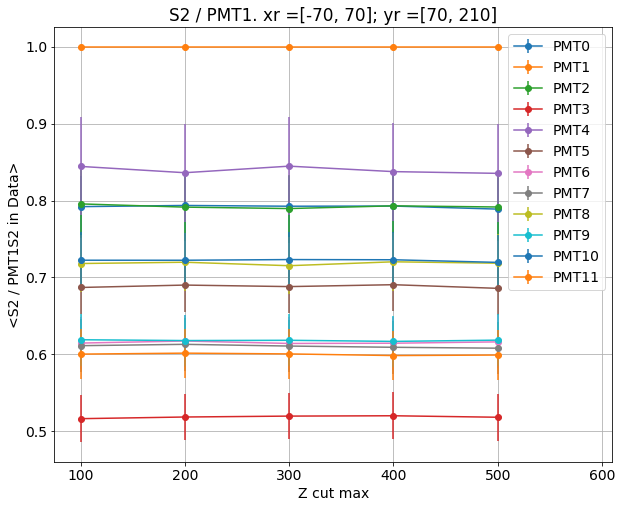

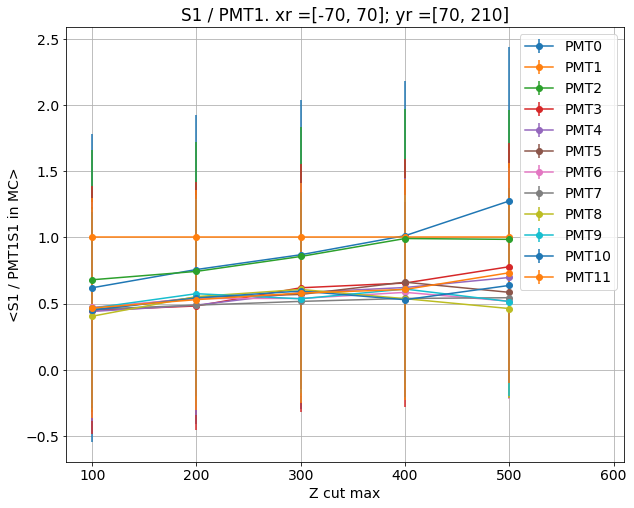

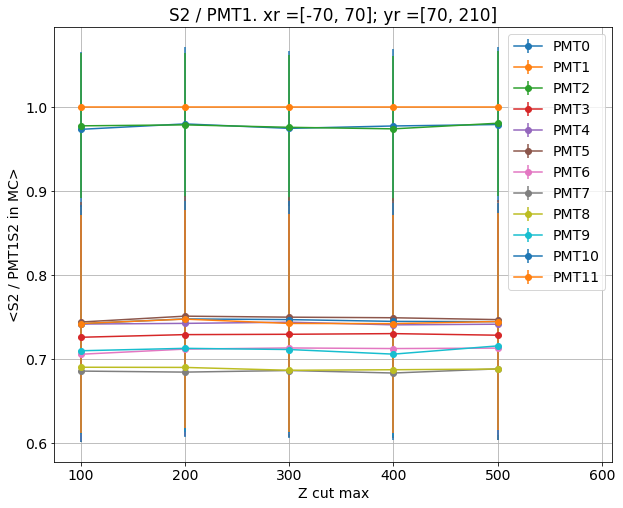

Dividing S2s
Dividing S1s


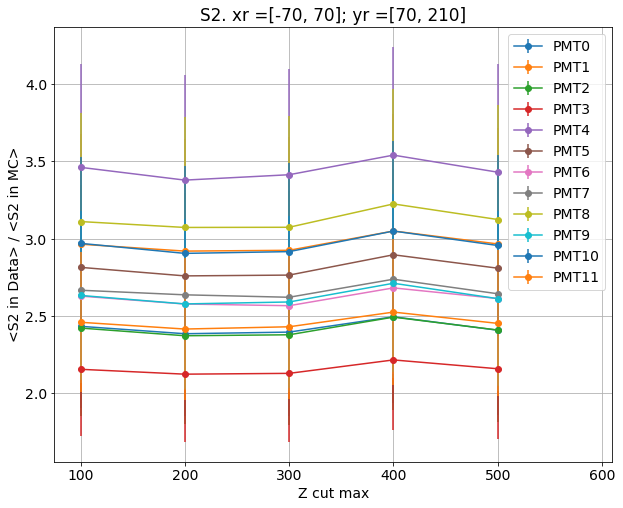

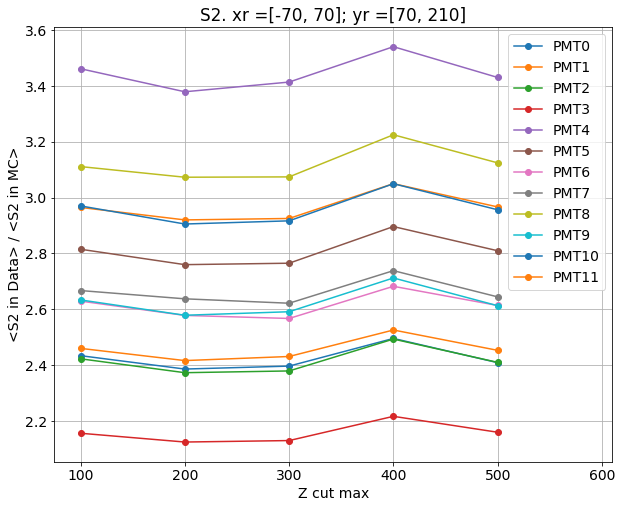

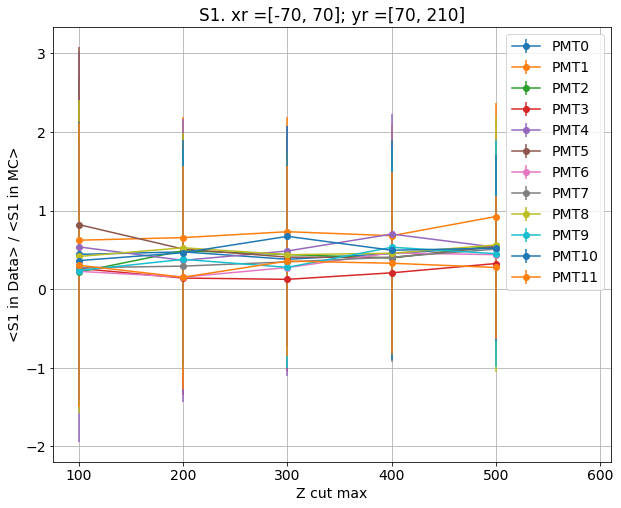

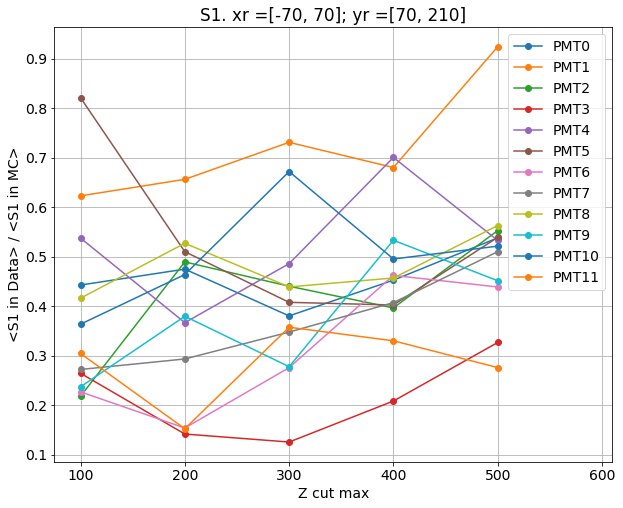

xr = [70, 210] ; yr = [-210, -70]
calculating data...


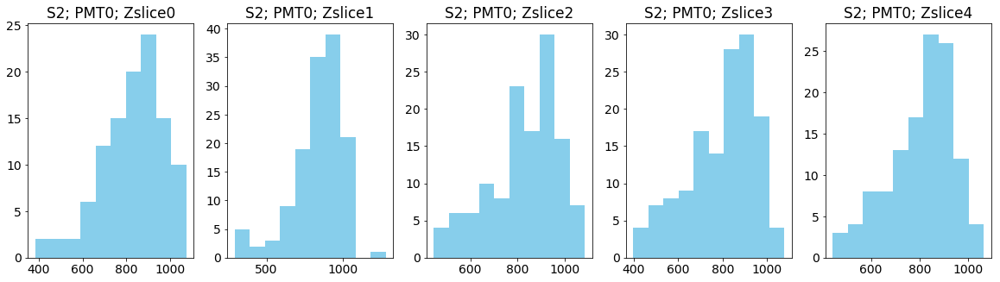

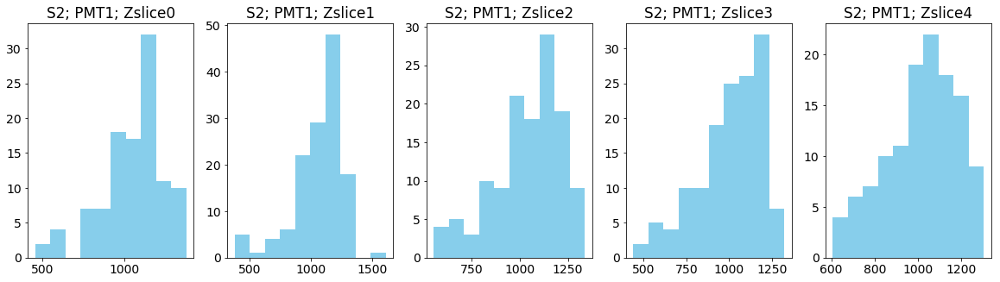

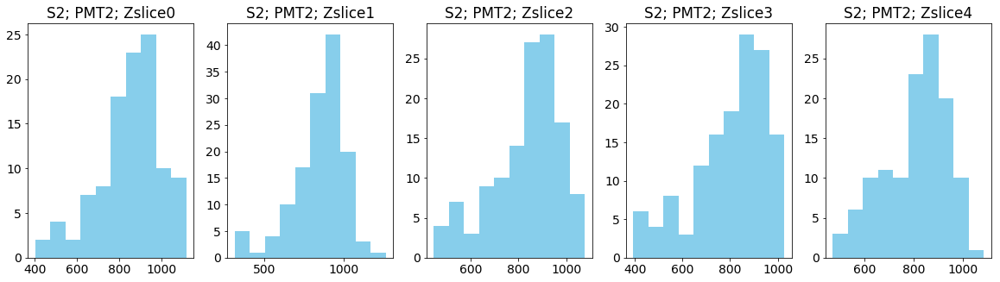

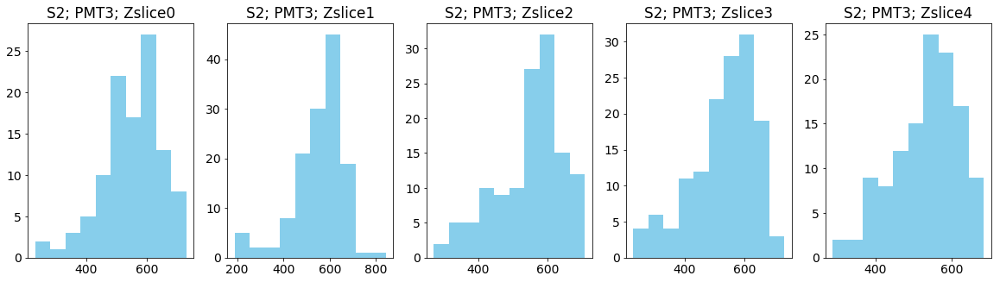

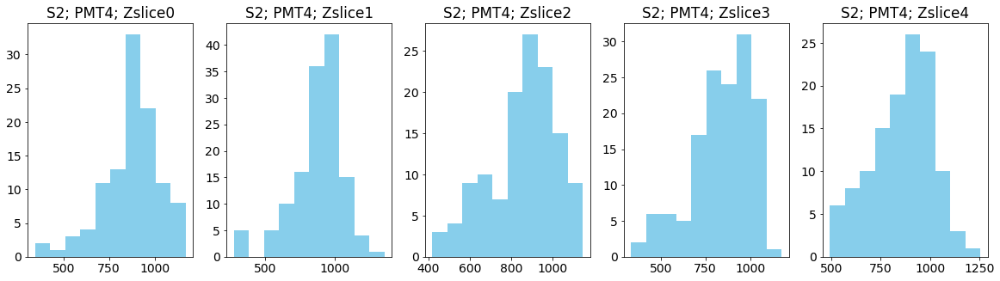

...

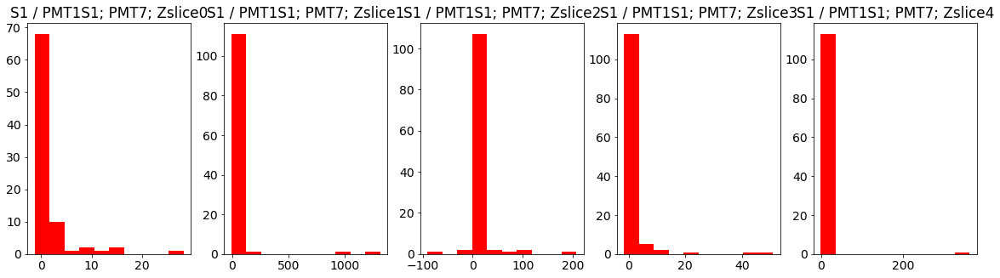

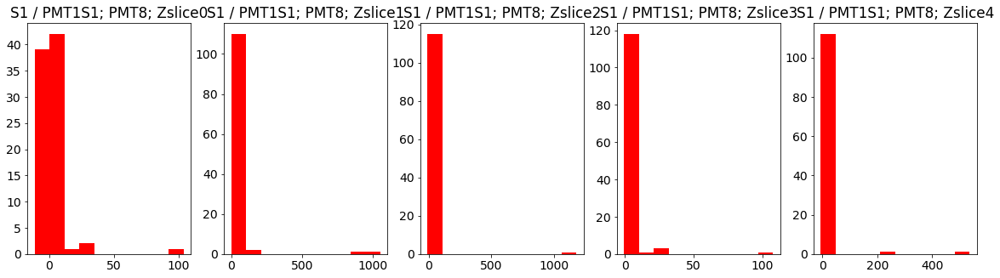

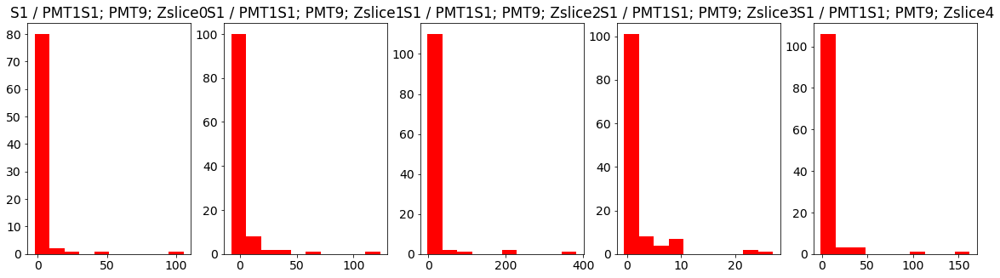

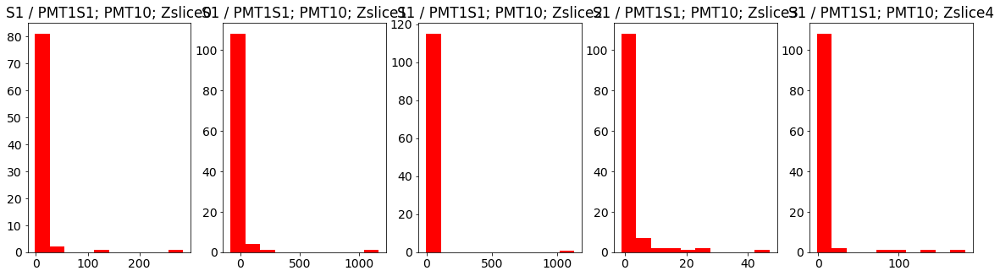

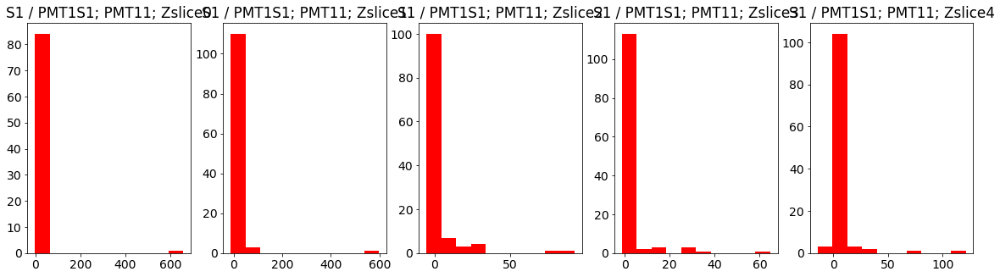

Calculated S2 matrix =
[[0.79164267, 0.78916657, 0.7949548, 0.7941618, 0.795672], [1.0, 1.0, 1.0, 1.0, 1.0], [0.807956, 0.7997078, 0.79907143, 0.79777, 0.7965035], [0.5286701, 0.52480555, 0.526996, 0.5222285, 0.52635413], [0.8300415, 0.82839394, 0.8225095, 0.8403301, 0.8445616], [0.6865677, 0.6861283, 0.6878042, 0.6864962, 0.69190395], [0.62624997, 0.6178762, 0.6208475, 0.61979985, 0.61835337], [0.61530346, 0.6227783, 0.6237668, 0.6179794, 0.6215135], [0.7327651, 0.7290838, 0.7257977, 0.7307835, 0.72895783], [0.63619906, 0.6284035, 0.6325289, 0.6370572, 0.6359072], [0.73654366, 0.72872573, 0.73178977, 0.73152965, 0.7326378], [0.60364723, 0.60384285, 0.60099036, 0.5999891, 0.6023697]]
calculating mc...


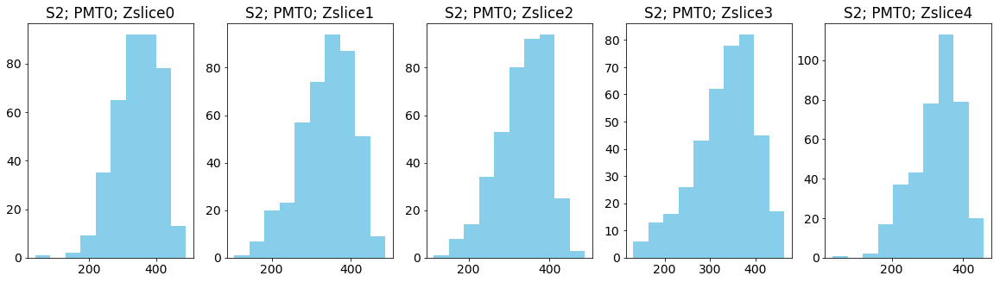

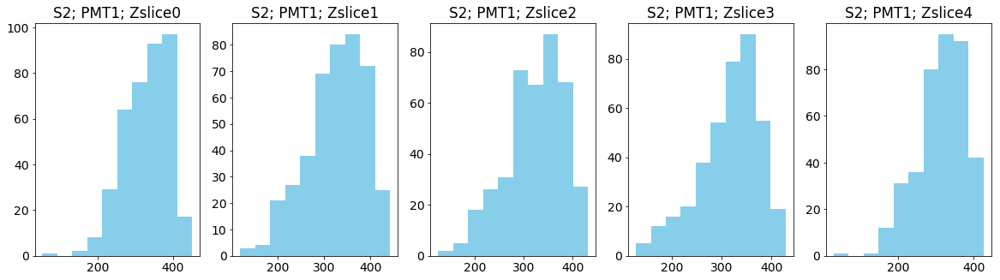

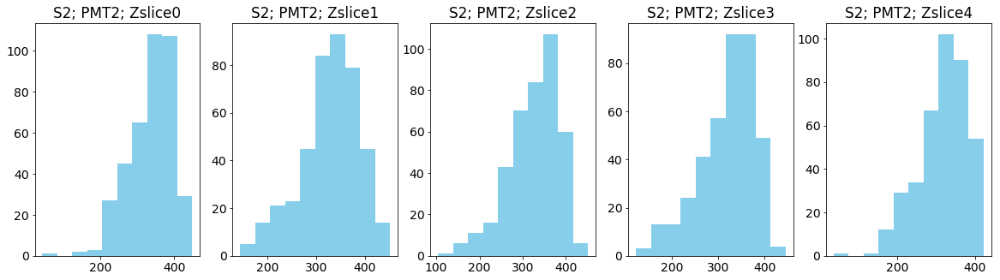

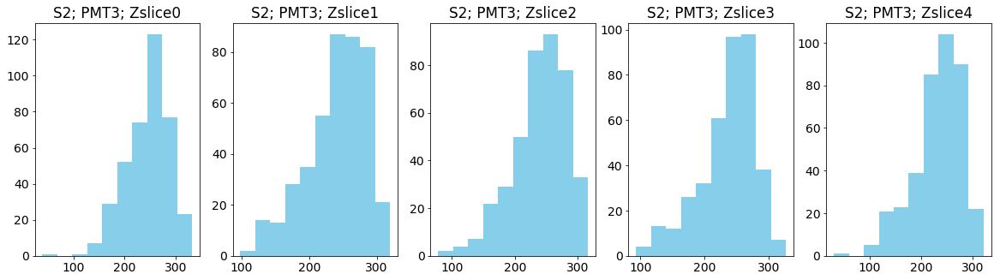

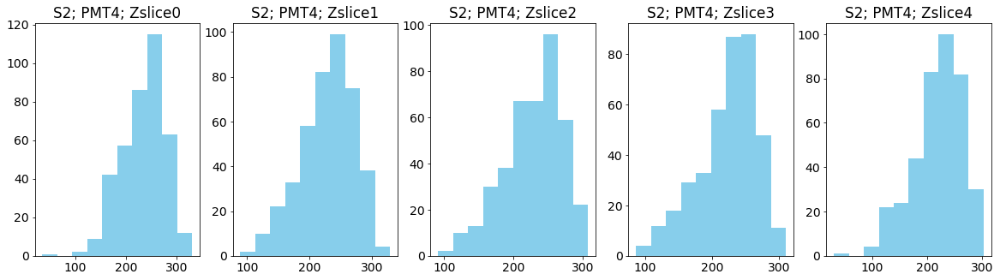

...

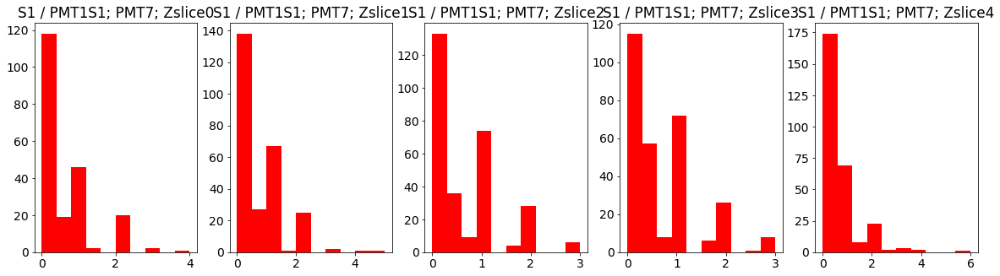

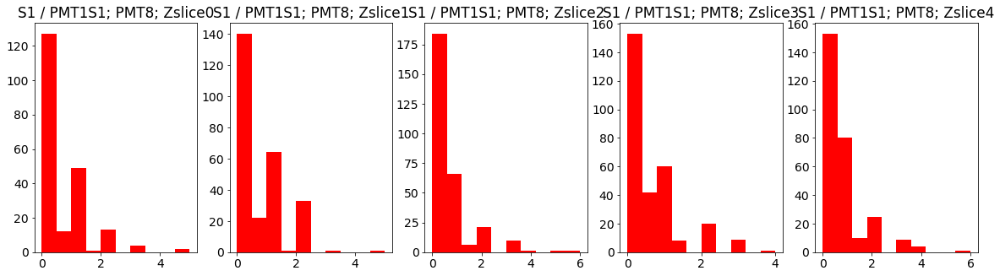

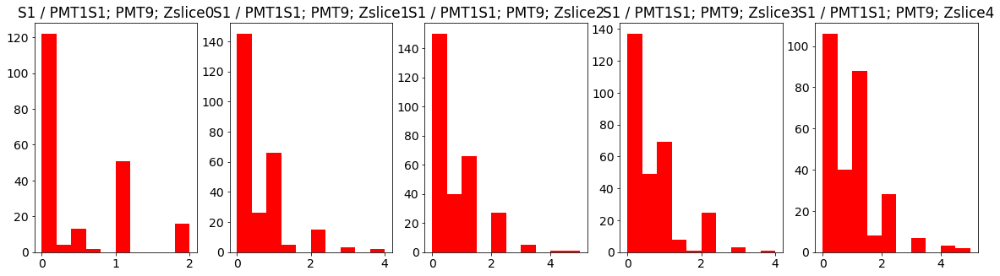

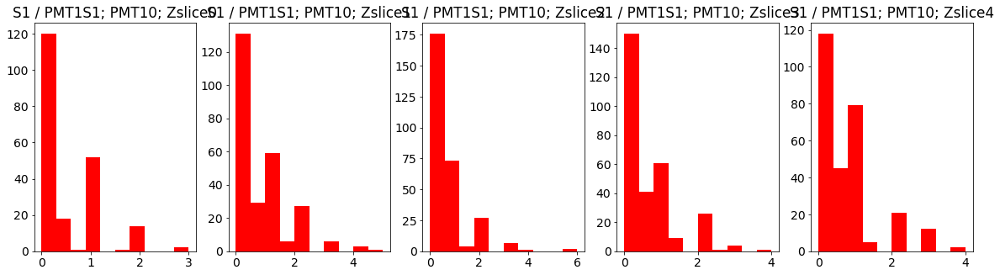

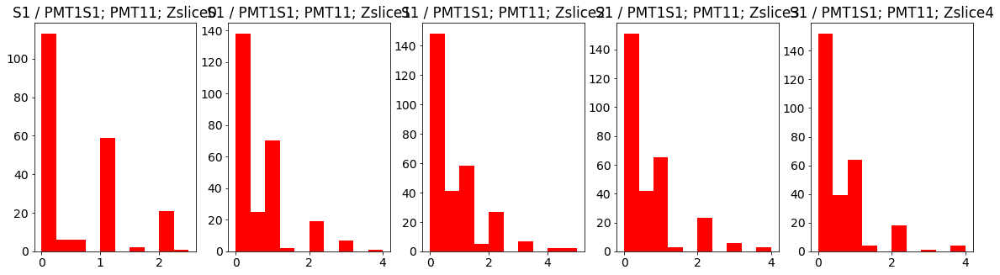

Data S2
[[ 831.40740741  837.02985075  828.22047244  798.89285714  806.64754098]
 [1051.98148148 1060.09701493 1042.52755906 1006.73571429 1014.98360656]
 [ 848.64814815  847.35074627  832.35433071  802.92142857  806.72131148]
 [ 555.25        555.23880597  548.82677165  526.89285714  532.89344262]
 [ 872.38888889  878.81343284  857.92125984  846.42857143  856.53278689]
 [ 722.00925926  726.70895522  715.98425197  690.92142857  701.64754098]
 [ 658.7962963   654.13432836  646.32283465  623.21428571  626.63114754]
 [ 646.62962963  658.57462687  649.2992126   621.64285714  630.09836066]
 [ 770.00925926  771.65671642  755.11811024  735.40714286  738.86065574]
 [ 667.25        664.03731343  657.74015748  640.88571429  644.24590164]
 [ 773.25925926  771.57462687  760.4488189   734.97142857  742.5       ]
 [ 633.73148148  640.17164179  626.4015748   603.32142857  610.1557377 ]]
Data S1
[[0.31481481 0.44029851 1.83464567 0.65714286 0.6147541 ]
 [0.38888889 0.8358209  2.77952756 1.02142857 1.0

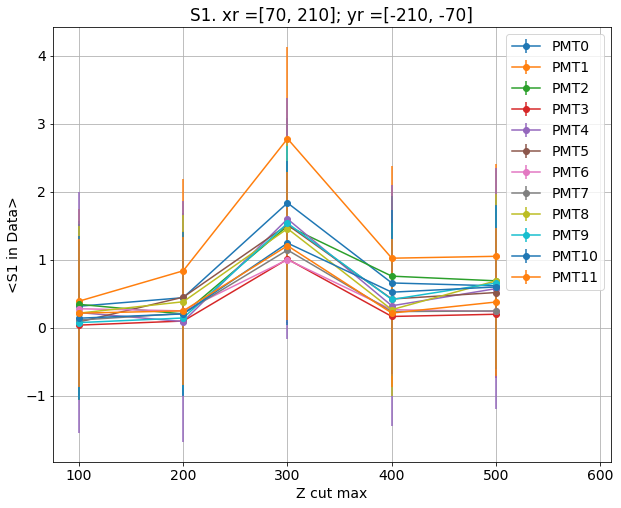

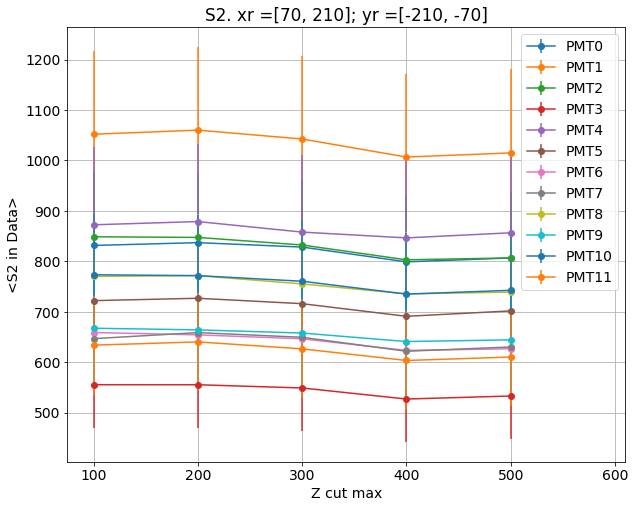

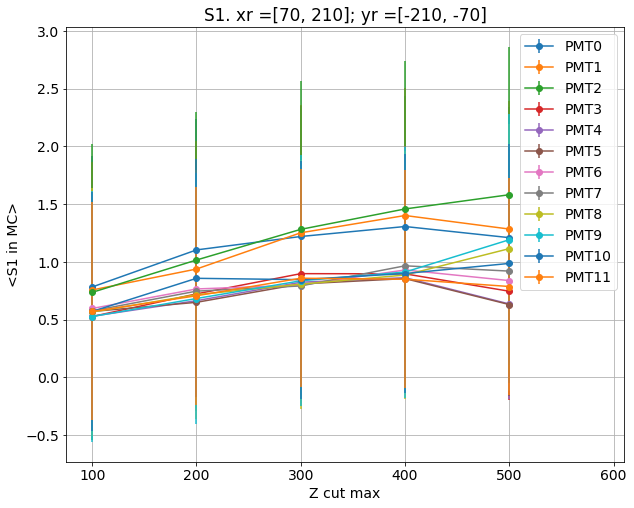

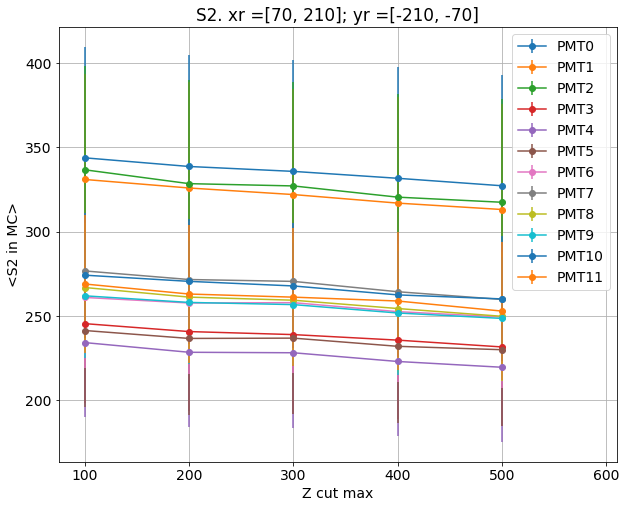

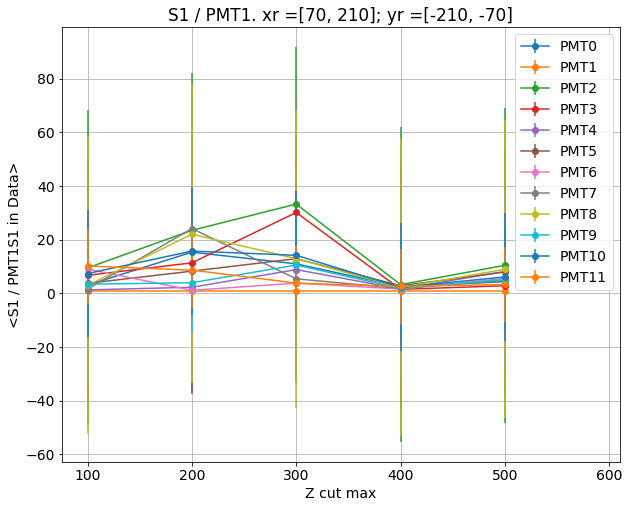

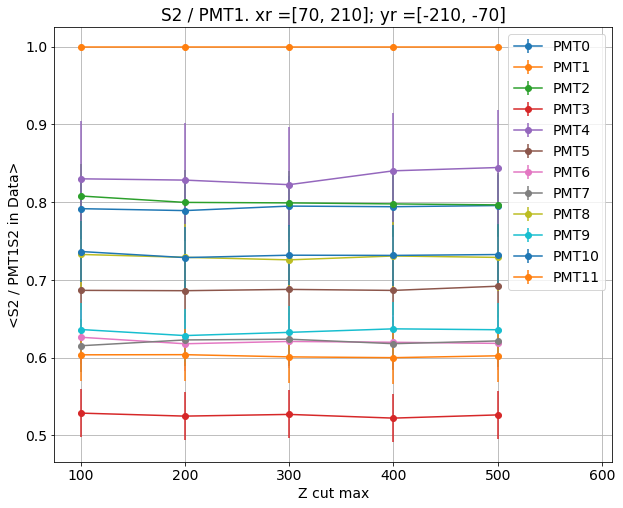

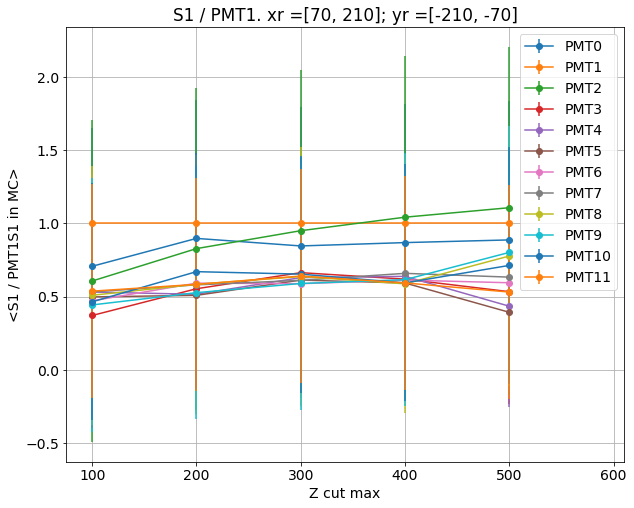

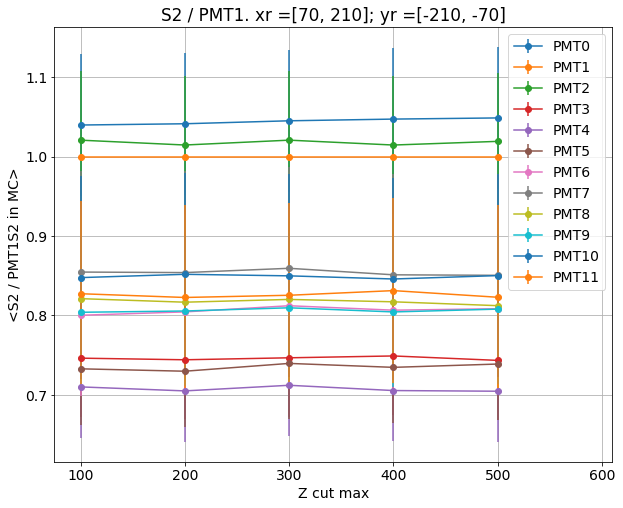

Dividing S2s
Dividing S1s


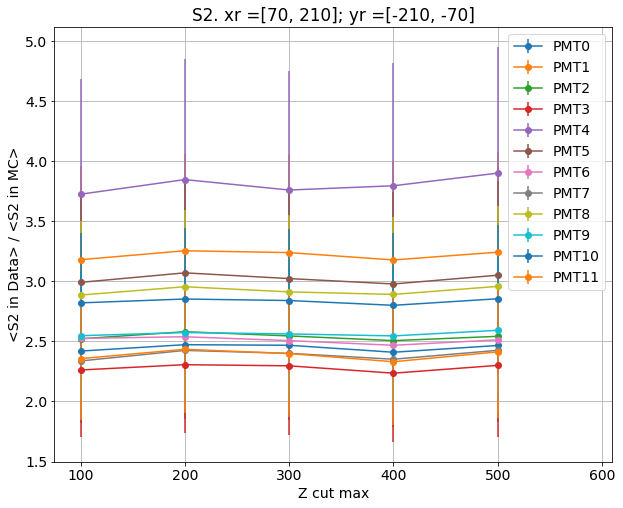

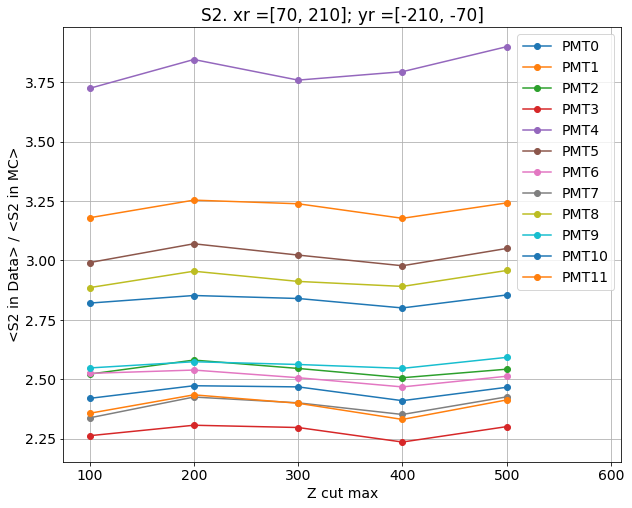

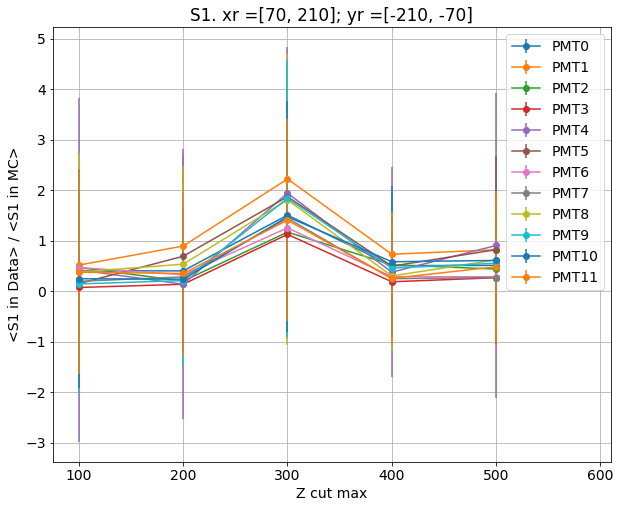

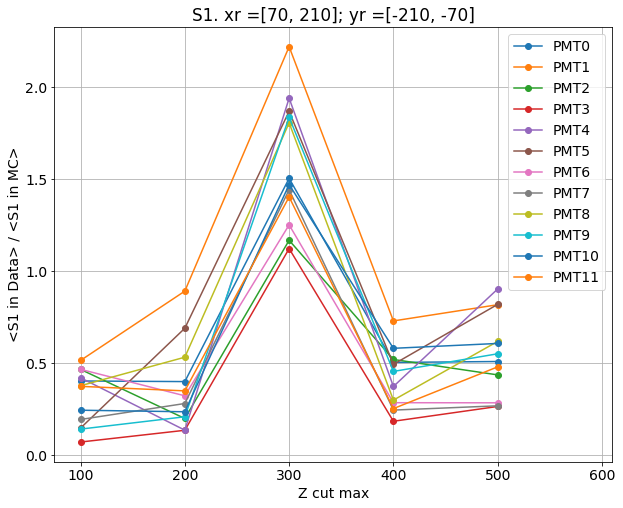

xr = [70, 210] ; yr = [-70, 70]
calculating data...


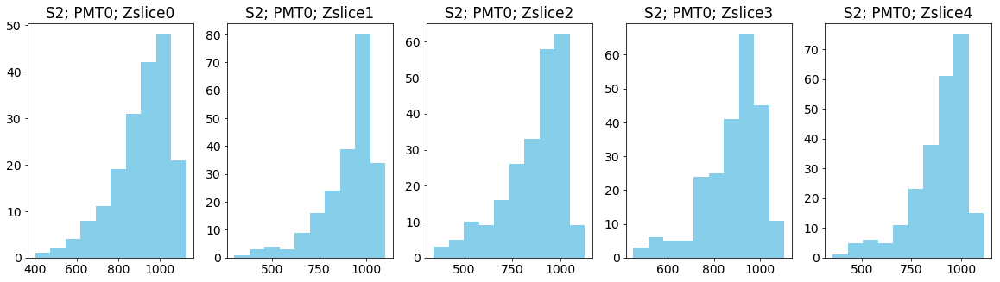

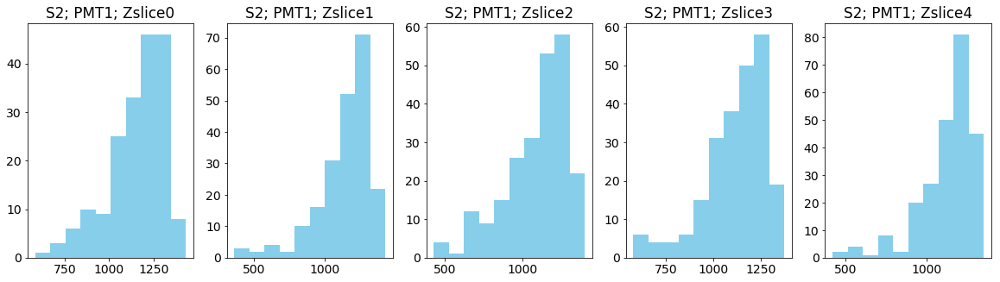

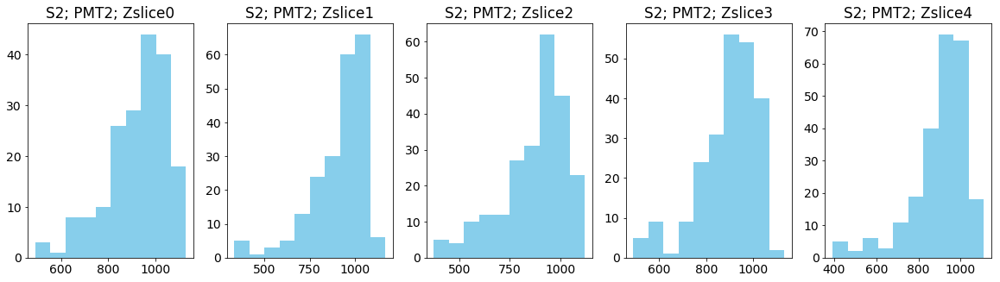

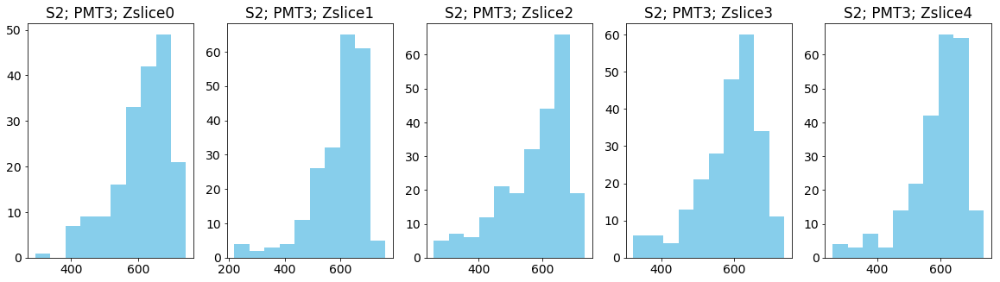

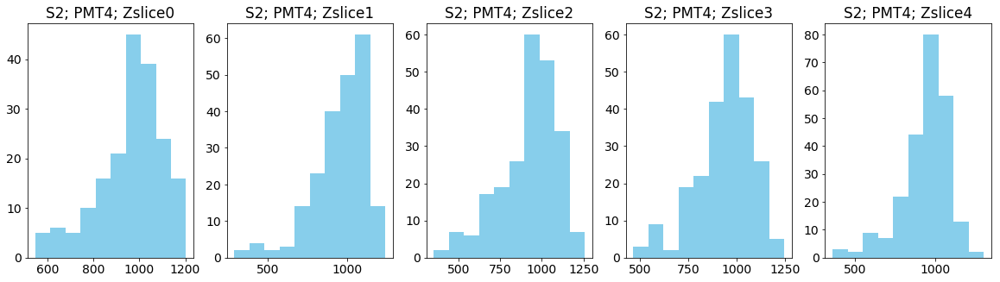

...

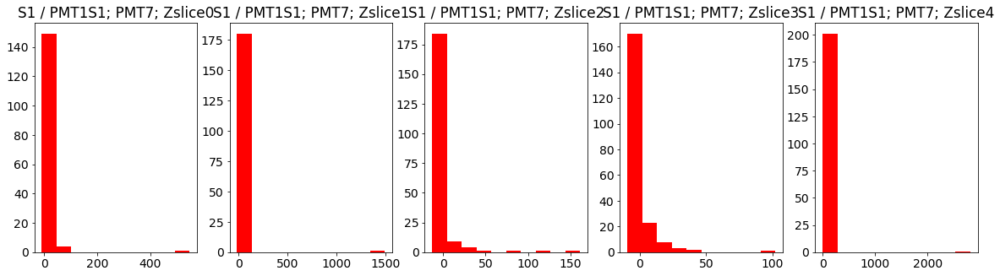

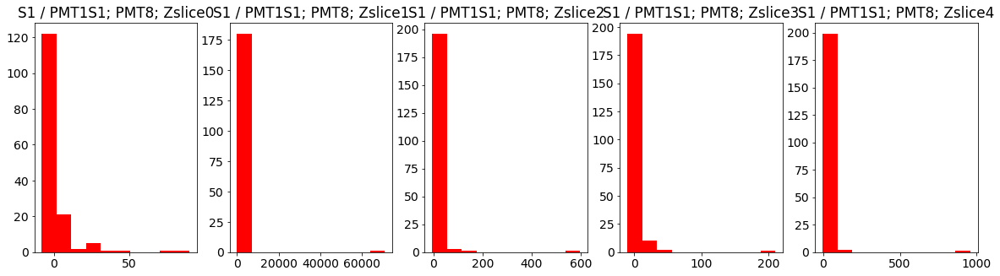

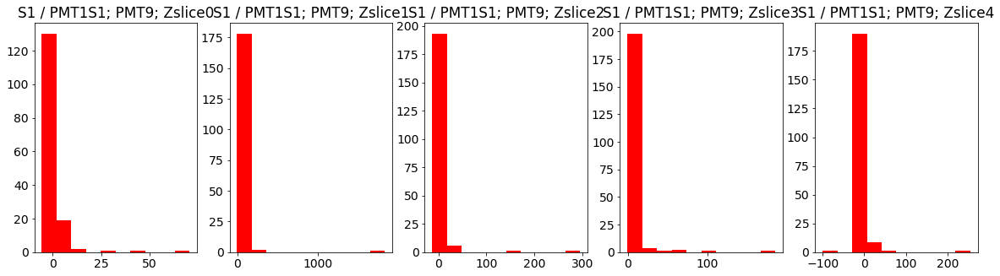

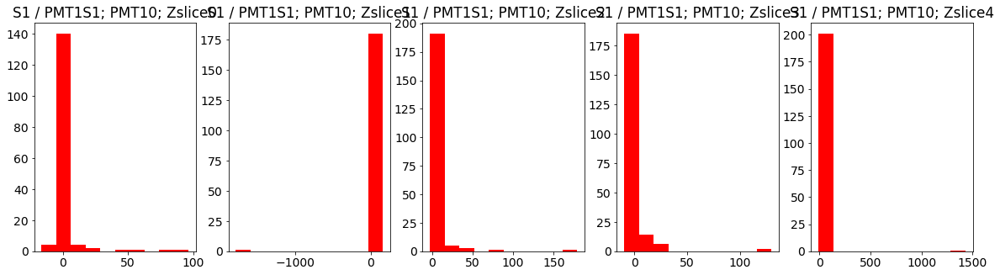

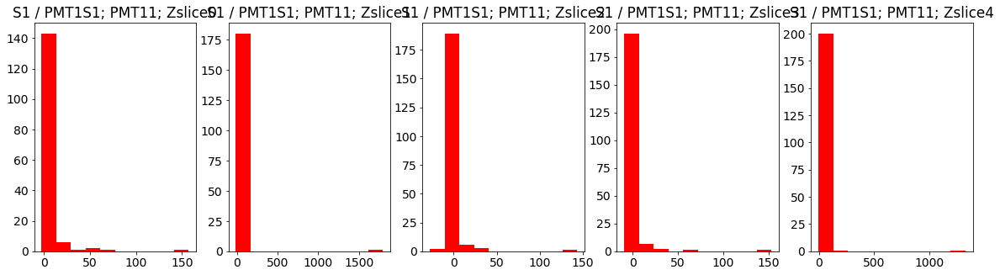

Calculated S2 matrix =
[[0.787386, 0.7947248, 0.79419184, 0.795119, 0.7921165], [1.0, 1.0, 1.0, 1.0, 1.0], [0.79881114, 0.8024948, 0.8015061, 0.8014647, 0.80182457], [0.5279379, 0.52429634, 0.52932674, 0.5261831, 0.52512807], [0.8332039, 0.840764, 0.84592205, 0.83877635, 0.83792293], [0.68659735, 0.6886002, 0.6907587, 0.6903314, 0.68928283], [0.61485255, 0.61740243, 0.6162977, 0.6176379, 0.61895066], [0.6170185, 0.6134079, 0.61868644, 0.6173364, 0.6171912], [0.7290576, 0.7262624, 0.73080575, 0.72952944, 0.7324315], [0.63032216, 0.6305671, 0.632105, 0.6334045, 0.6274842], [0.72819984, 0.730279, 0.73110604, 0.7292903, 0.7280208], [0.6028151, 0.6005659, 0.60524535, 0.60338575, 0.60386574]]
calculating mc...


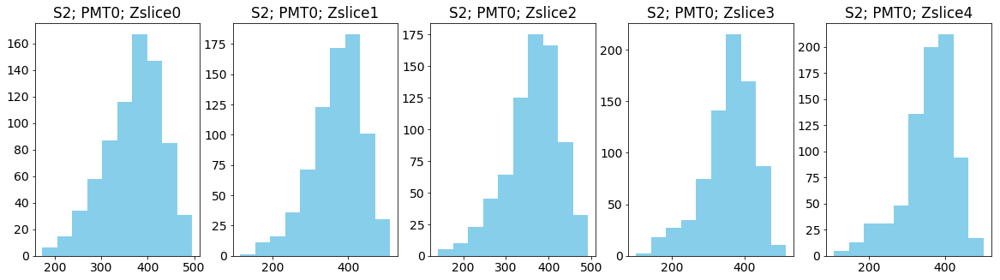

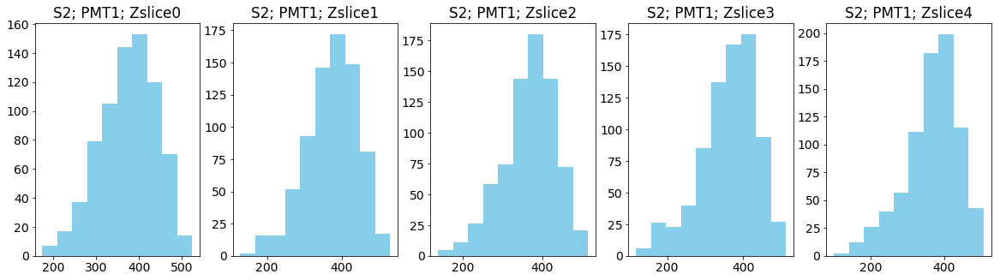

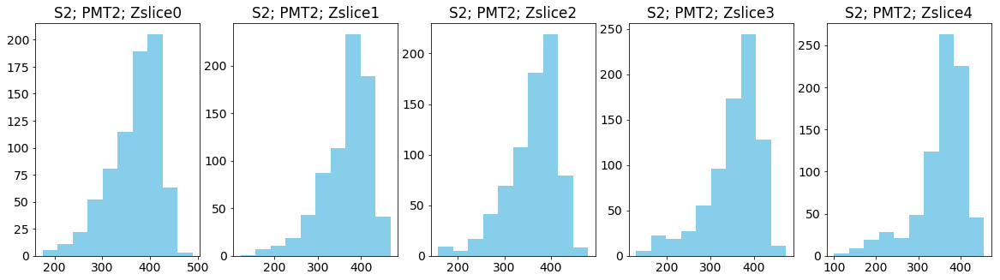

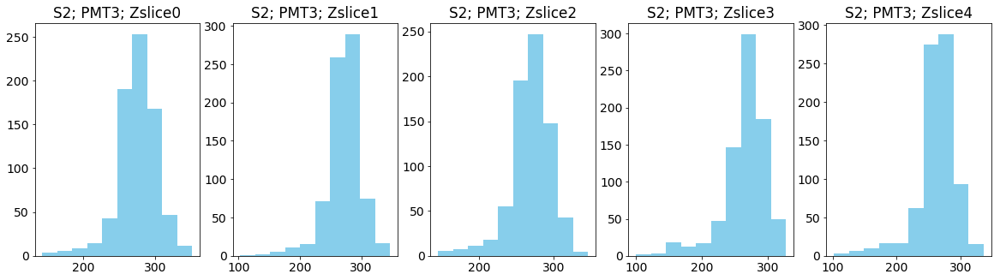

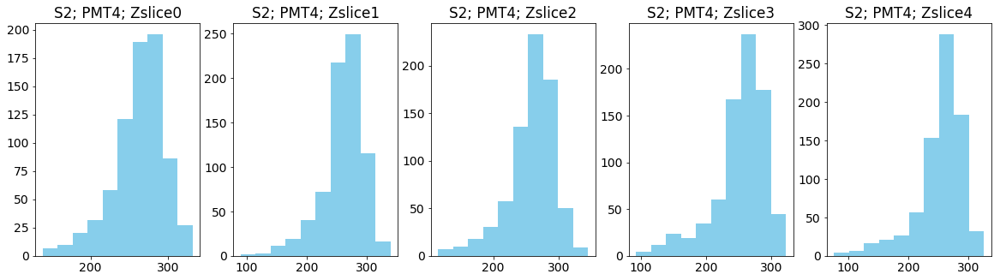

...

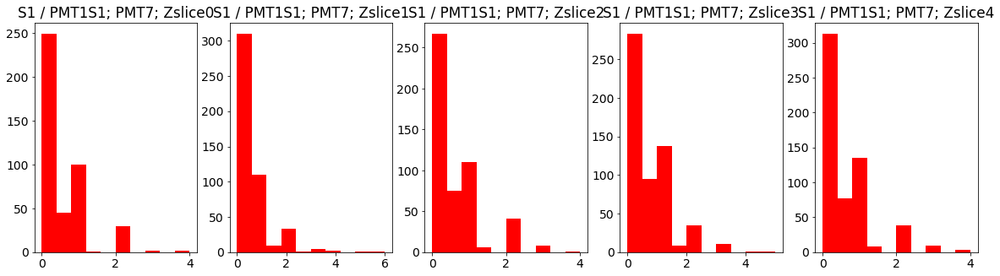

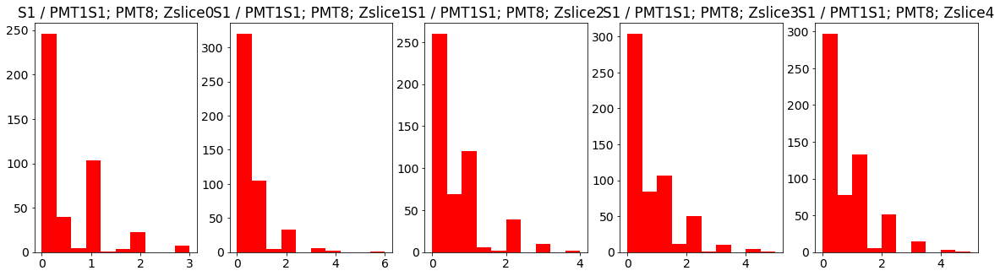

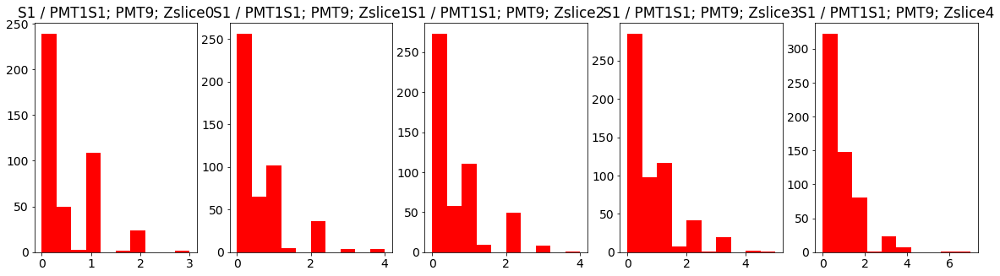

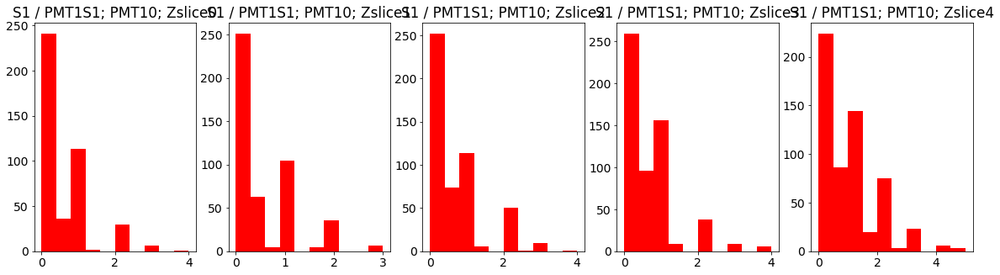

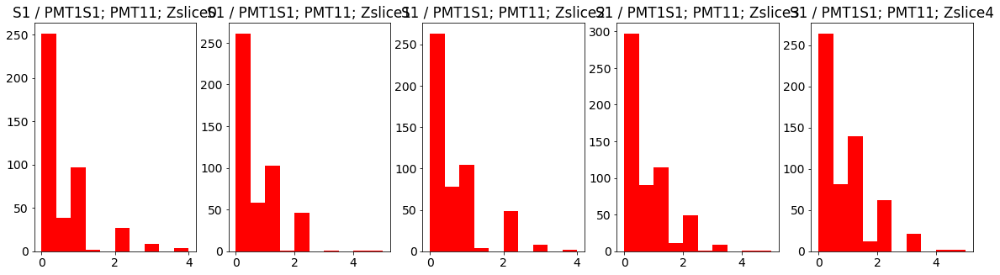

Data S2
[[ 912.37433155  904.3943662   865.91341991  888.31601732  891.82916667]
 [1158.22994652 1140.63849765 1090.88744589 1118.98701299 1127.125     ]
 [ 923.71122995  914.22535211  873.04761905  894.98701299  902.1625    ]
 [ 609.89839572  596.58685446  575.78354978  587.29437229  590.49583333]
 [ 964.28877005  959.06103286  921.26406926  937.38961039  943.48333333]
 [ 794.48128342  783.84976526  752.23376623  770.82251082  775.43333333]
 [ 712.07486631  703.12676056  671.07359307  689.0952381   696.80416667]
 [ 713.35828877  698.37558685  672.86580087  689.48917749  694.47083333]
 [ 843.67914439  826.83568075  794.34199134  814.8008658   824.12083333]
 [ 728.39037433  717.11737089  686.68831169  706.93506494  705.7625    ]
 [ 841.78074866  831.29577465  794.26406926  813.67965368  818.70833333]
 [ 697.2513369   683.56807512  658.14718615  673.72294372  679.0625    ]]
Data S1
[[0.25668449 0.27230047 0.69264069 0.66233766 0.55      ]
 [0.63636364 0.70422535 0.9004329  1.         0.8

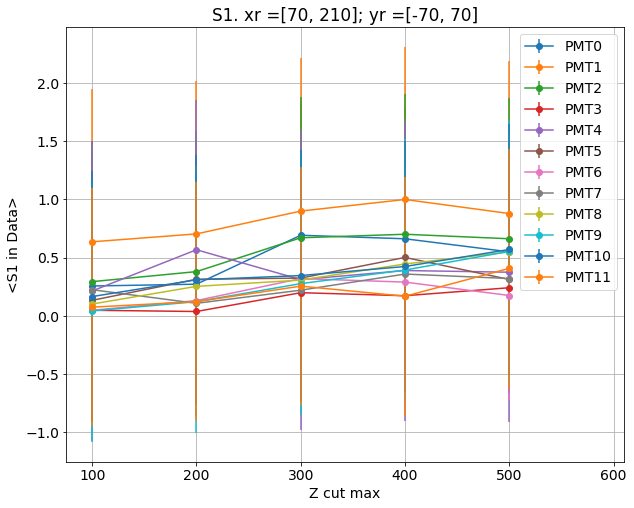

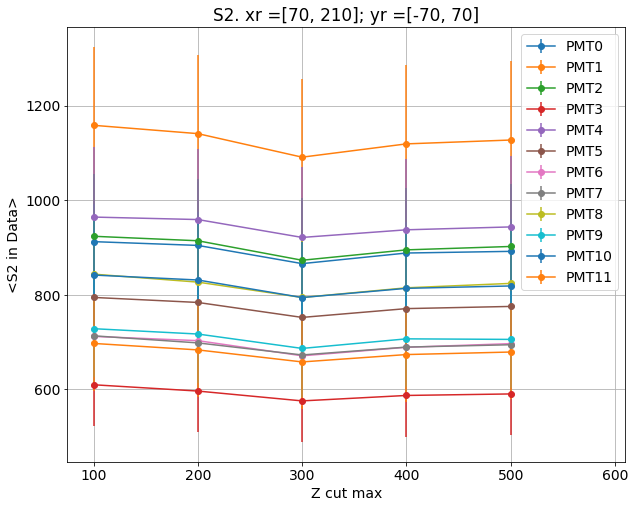

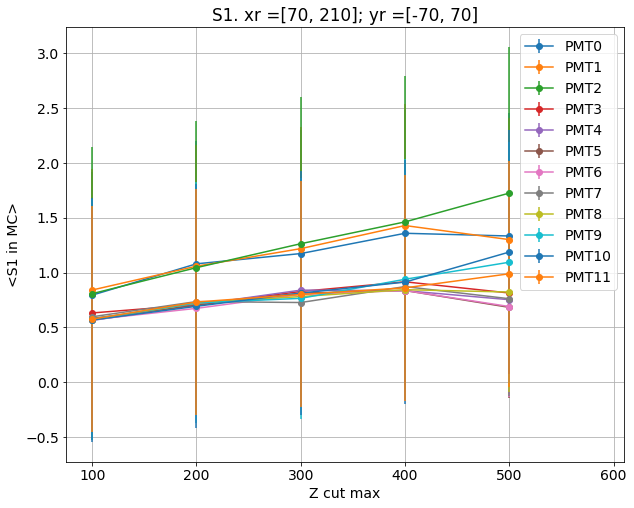

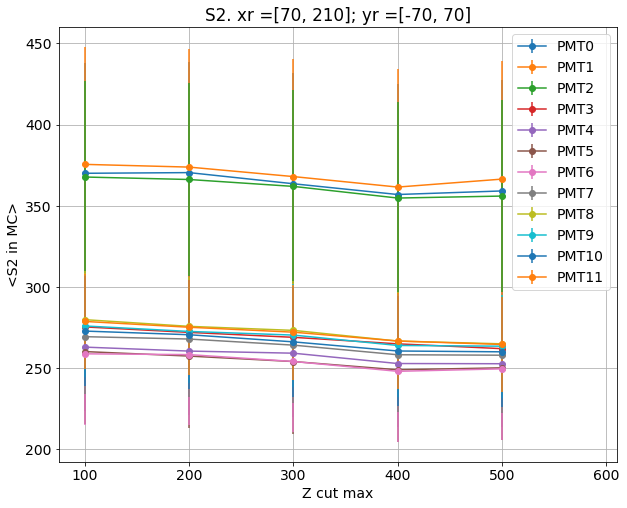

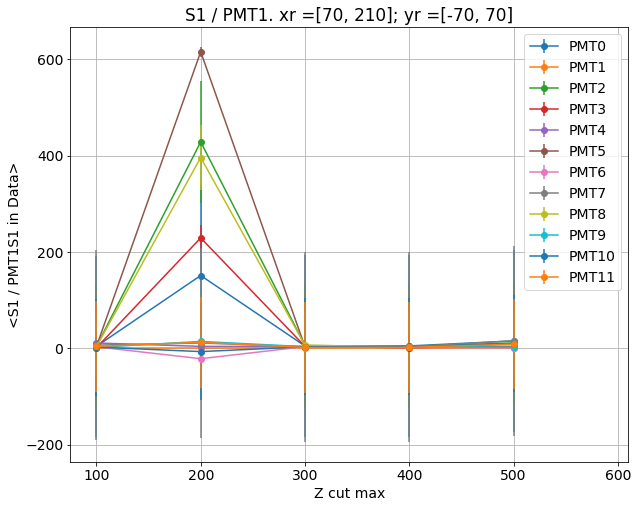

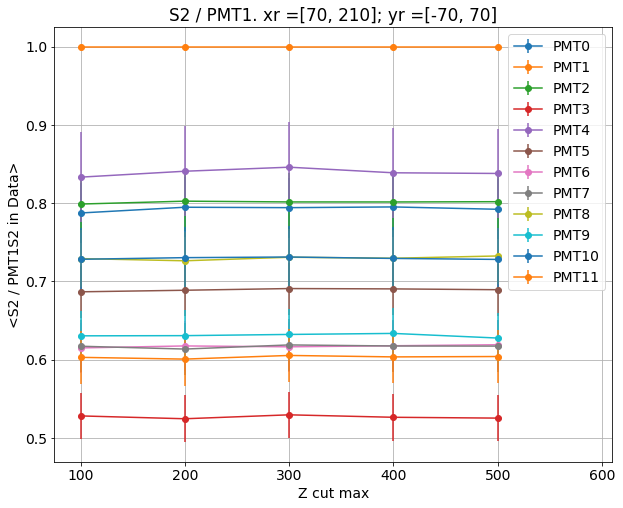

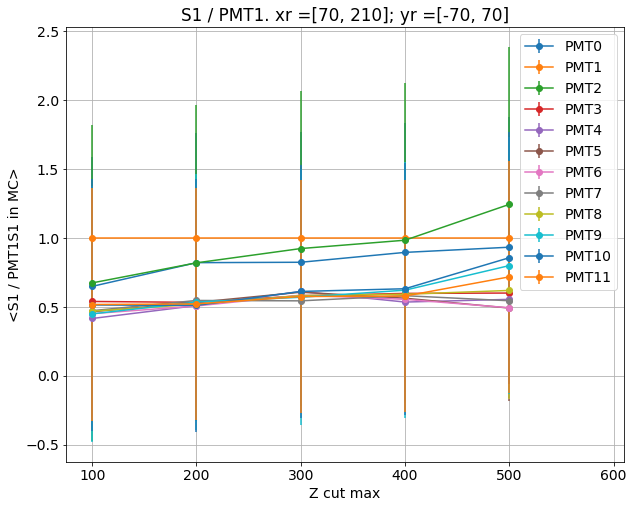

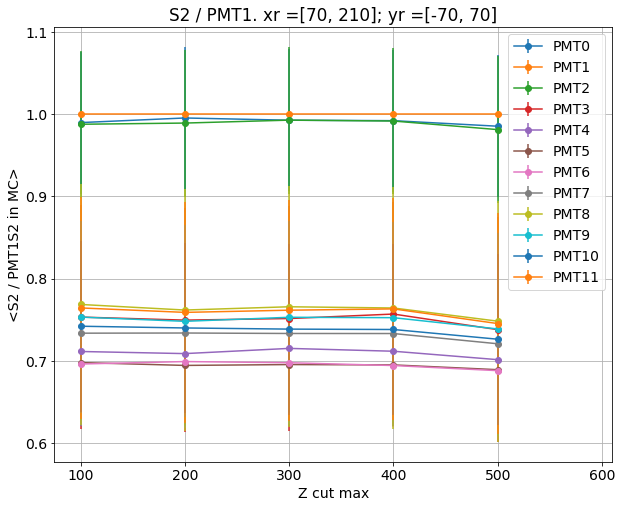

Dividing S2s
Dividing S1s


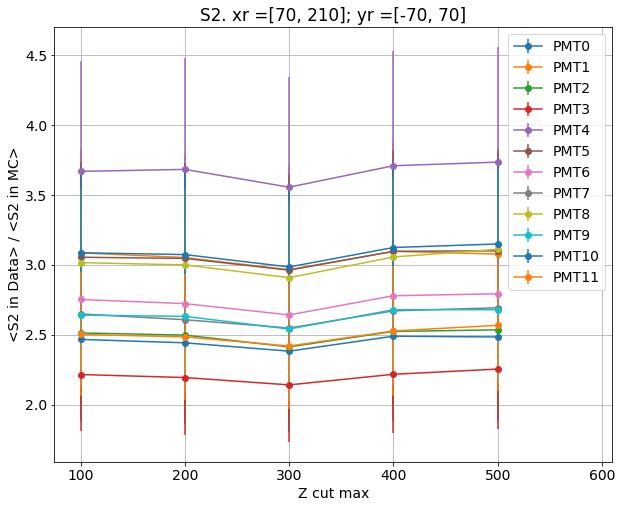

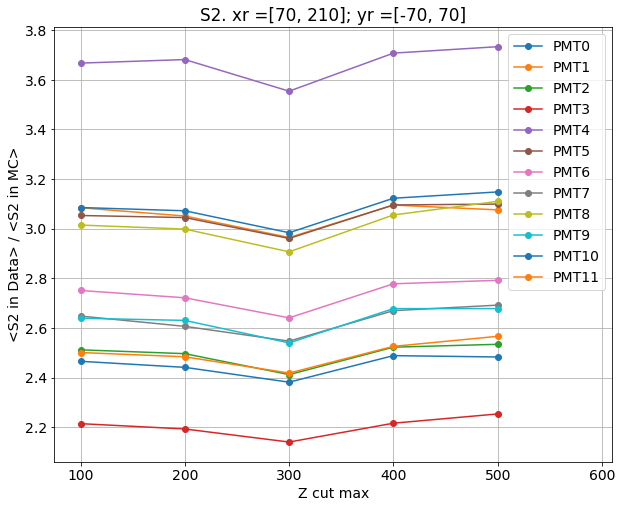

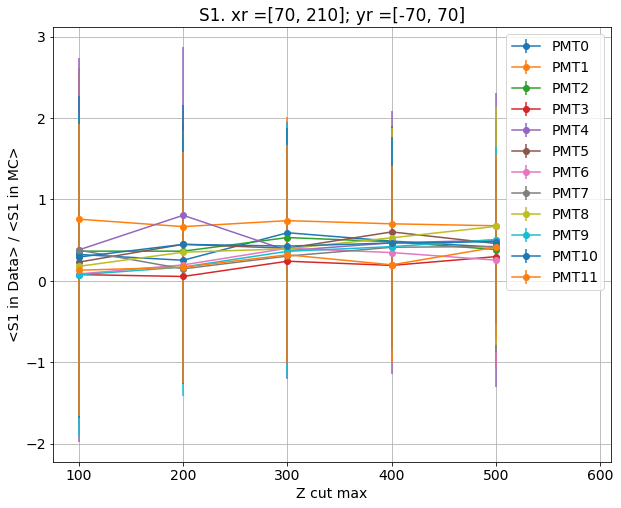

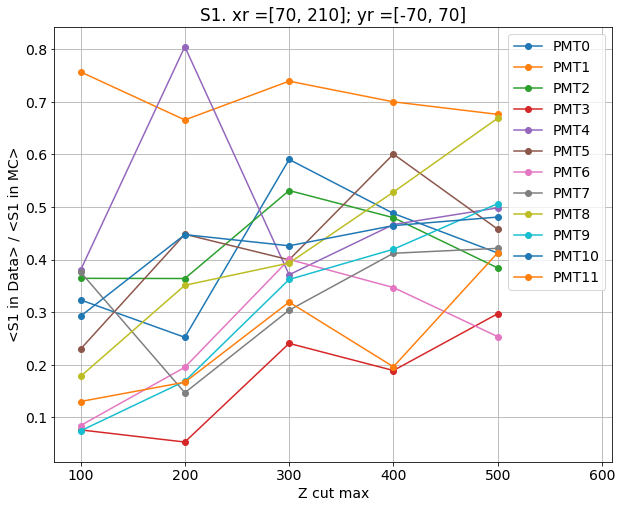

xr = [70, 210] ; yr = [70, 210]
calculating data...


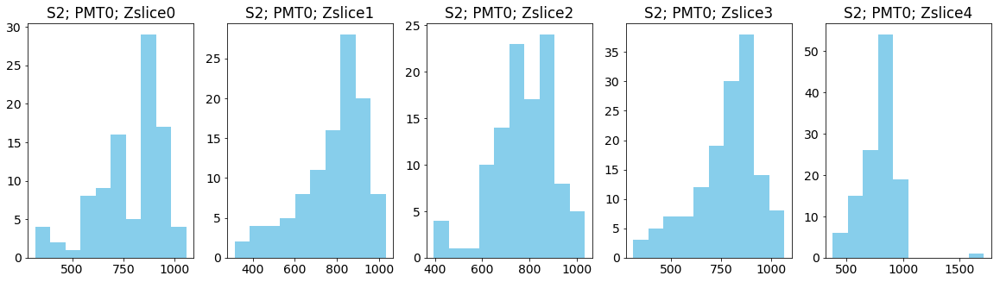

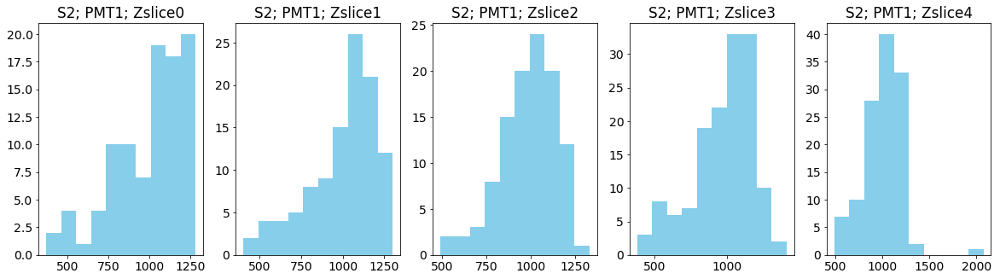

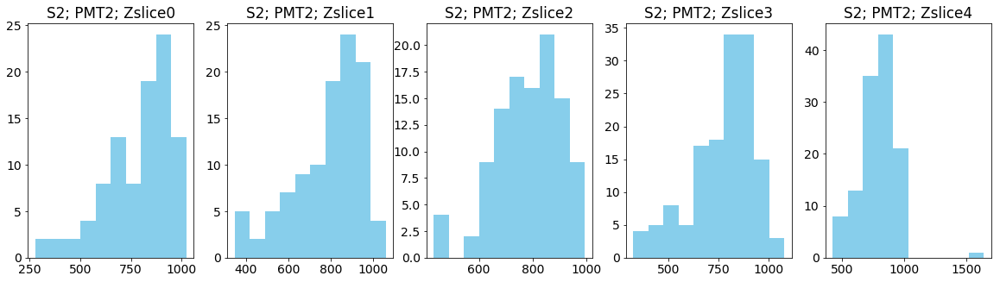

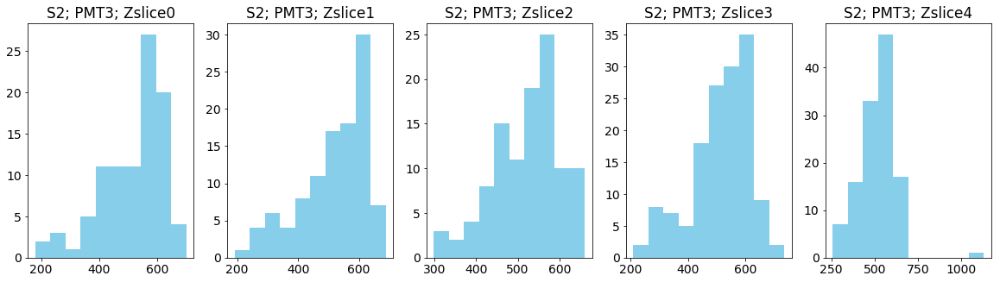

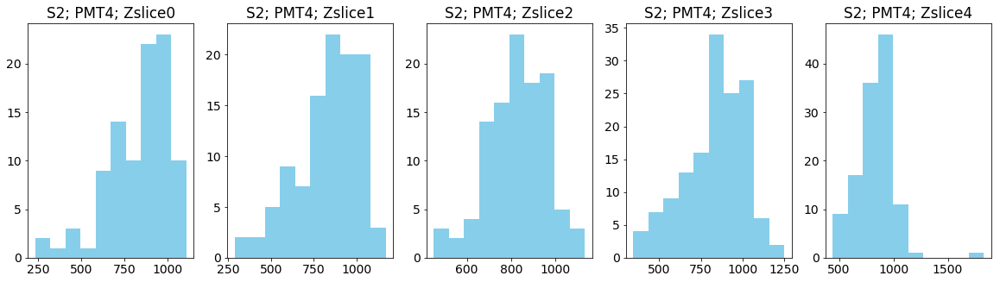

...

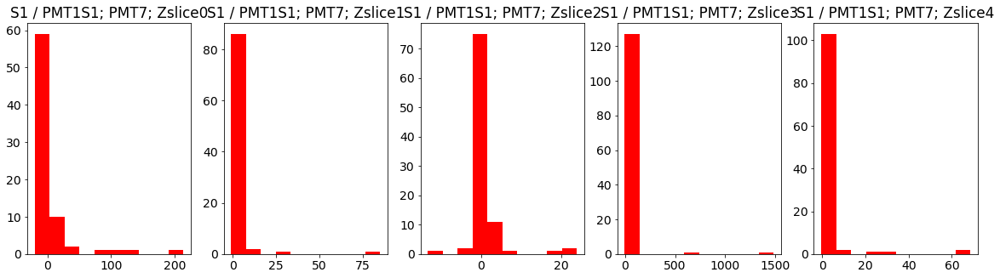

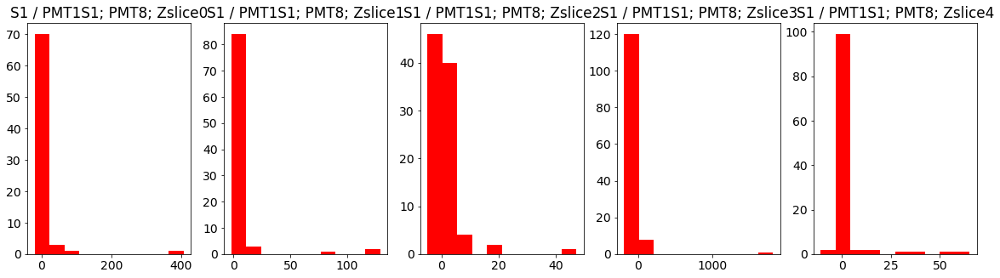

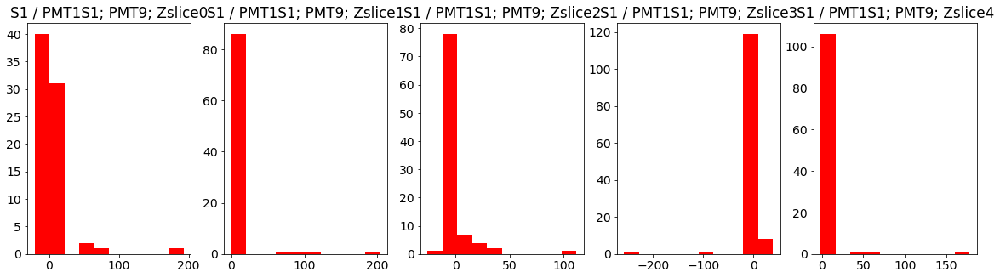

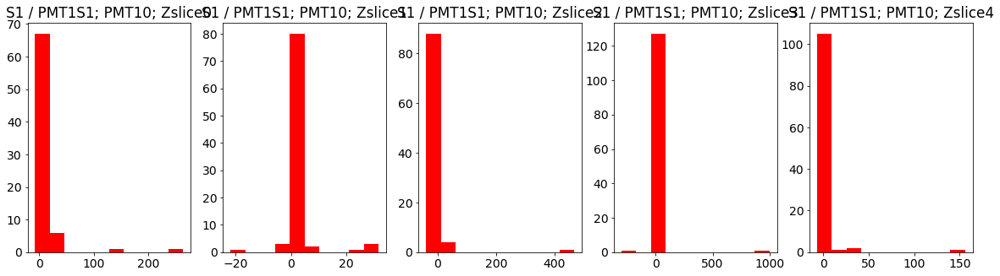

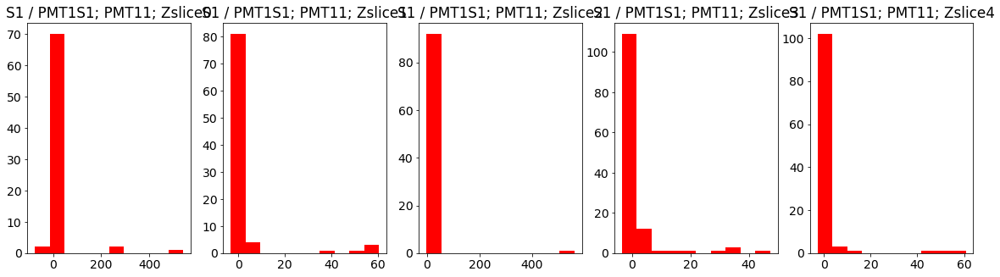

Calculated S2 matrix =
[[0.785624, 0.78822875, 0.78469896, 0.796303, 0.7891525], [1.0, 1.0, 1.0, 1.0, 1.0], [0.79443157, 0.7928817, 0.7923589, 0.79243255, 0.78811455], [0.521965, 0.520435, 0.5292392, 0.5258635, 0.51720905], [0.83561176, 0.83791816, 0.8397801, 0.85277146, 0.835973], [0.6825051, 0.68776625, 0.6857663, 0.6888736, 0.68202114], [0.60723305, 0.60681856, 0.61403084, 0.61409104, 0.60466236], [0.6009427, 0.60845363, 0.61089754, 0.61250126, 0.6071526], [0.7206104, 0.7192845, 0.72533995, 0.7248561, 0.7198043], [0.6230177, 0.62190104, 0.62734795, 0.6308459, 0.62312996], [0.7264941, 0.72991157, 0.7298787, 0.7301201, 0.7246021], [0.594698, 0.59519815, 0.60008425, 0.59968555, 0.59764117]]
calculating mc...


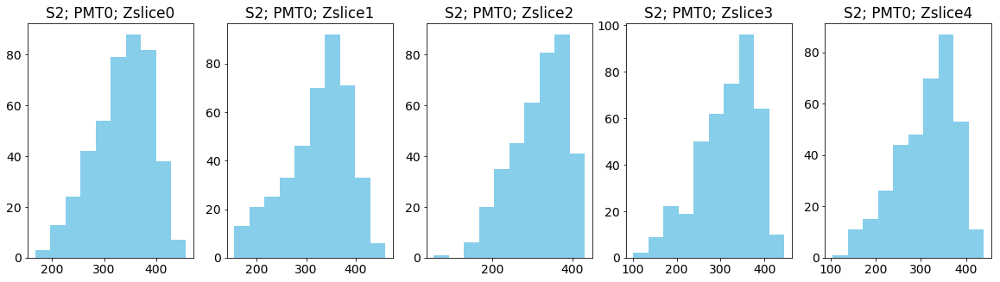

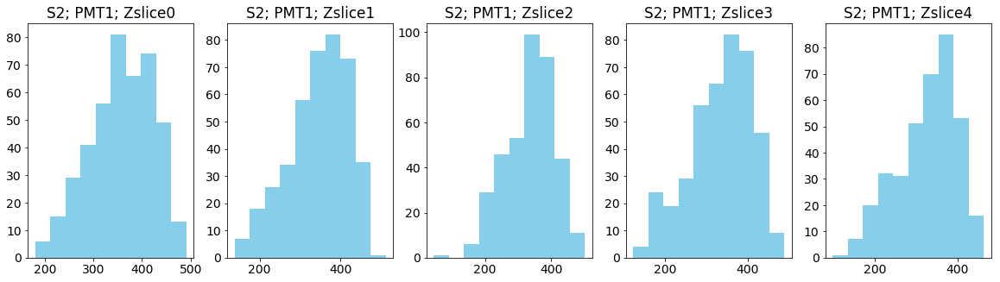

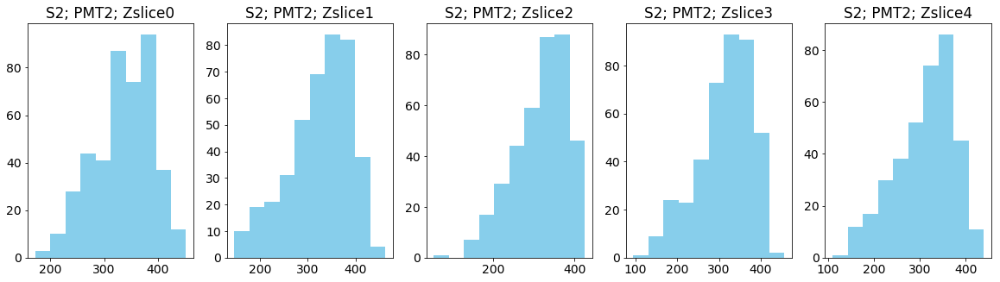

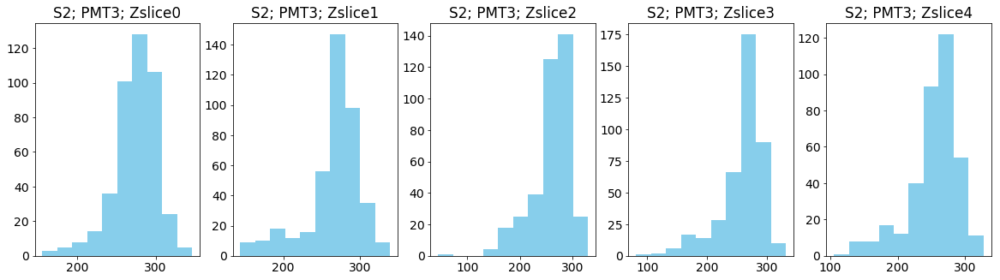

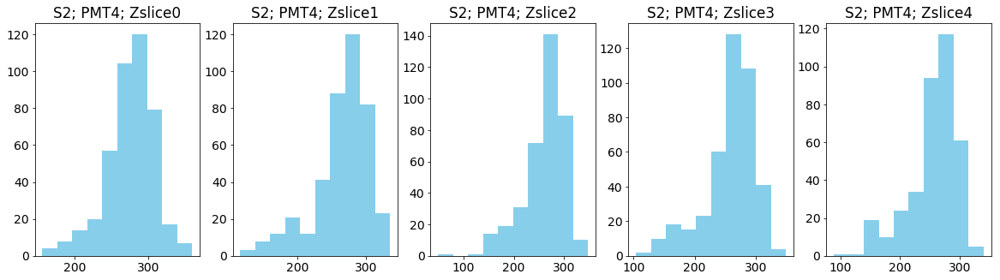

...

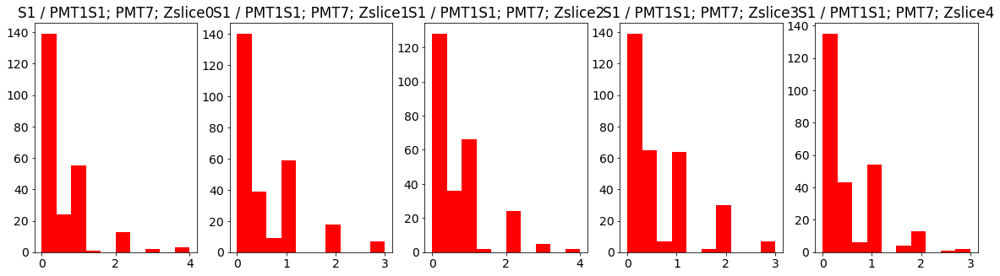

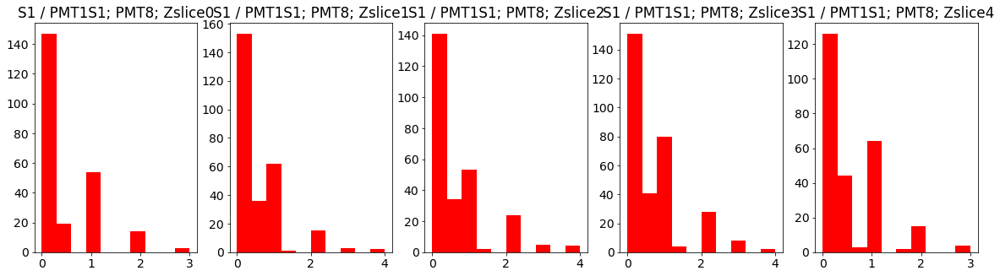

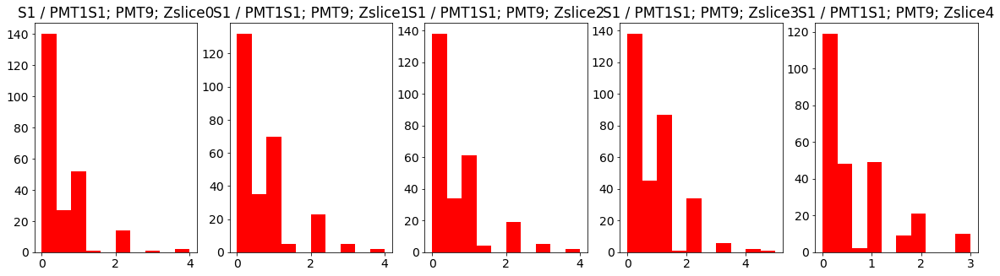

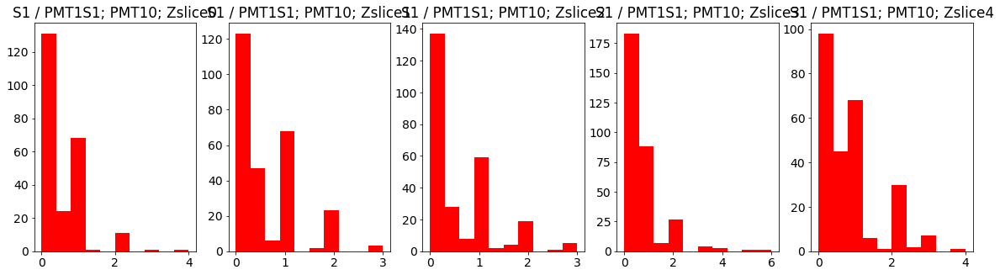

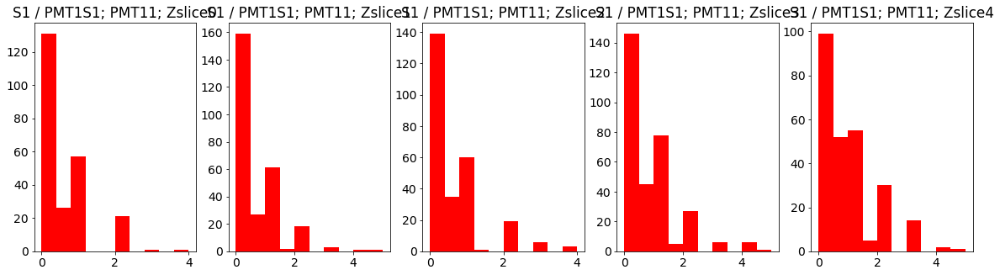

Data S2
[[ 779.97894737  783.55660377  775.34579439  778.09090909  793.56198347]
 [ 995.24210526  995.75471698  988.1588785   979.55244755 1006.38842975]
 [ 789.48421053  788.31132075  781.8411215   773.74125874  791.54545455]
 [ 518.23157895  517.6509434   521.45794393  513.5034965   519.56198347]
 [ 830.87368421  834.89622642  827.29906542  833.47552448  839.26446281]
 [ 678.55789474  684.75471698  677.17757009  673.73426573  684.59504132]
 [ 603.05263158  603.95283019  605.64485981  600.48951049  608.1322314 ]
 [ 598.10526316  605.27358491  602.40186916  598.66433566  610.94214876]
 [ 715.56842105  716.13207547  714.97196262  710.37762238  722.0661157 ]
 [ 617.56842105  617.94339623  618.59813084  616.02097902  625.73553719]
 [ 721.51578947  726.16037736  719.35514019  712.62237762  727.2892562 ]
 [ 590.37894737  592.23584906  591.93457944  585.58741259  601.10743802]]
Data S1
[[1.65263158 0.36792453 0.54205607 1.84615385 0.85950413]
 [2.09473684 0.79245283 0.79439252 2.82517483 1.1

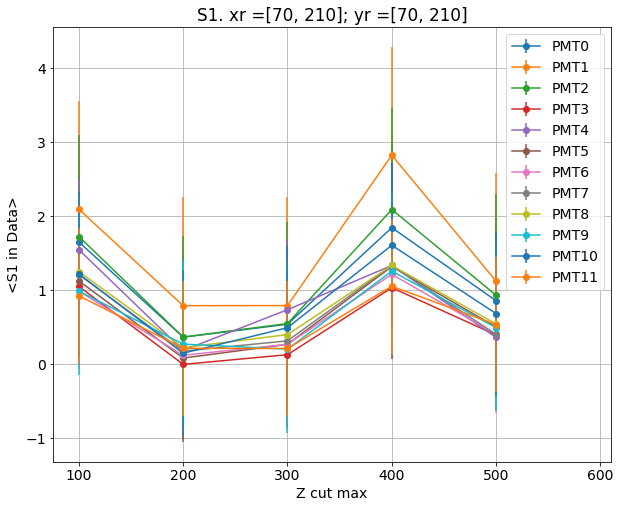

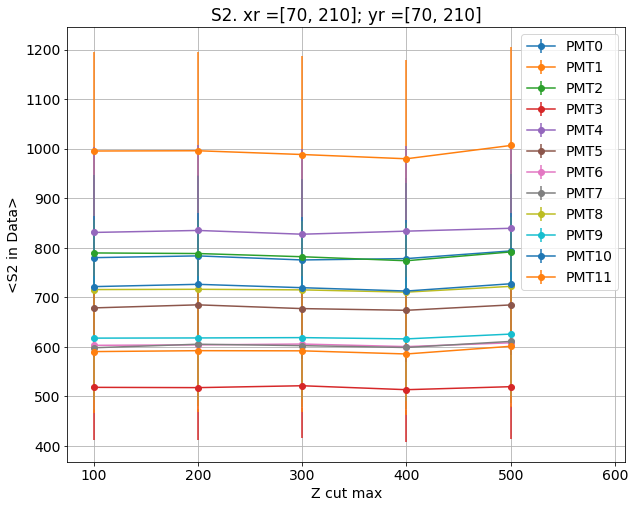

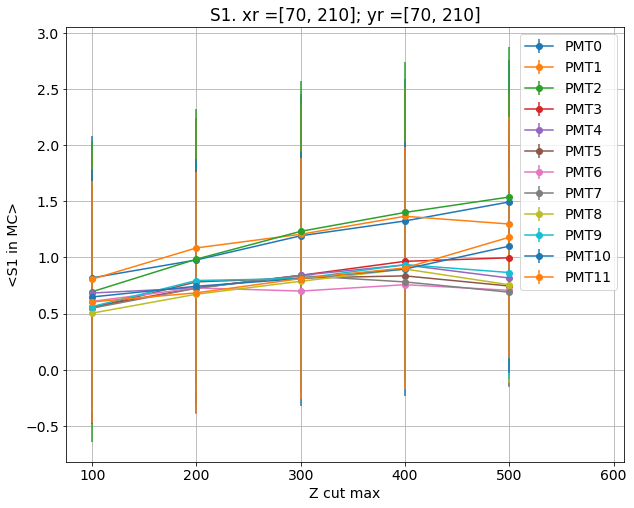

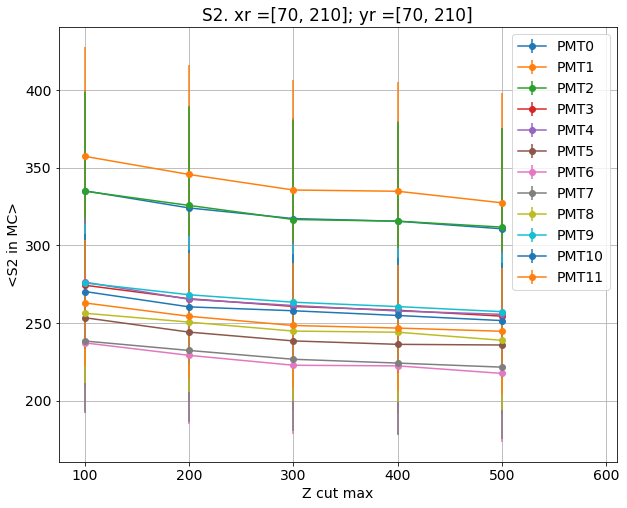

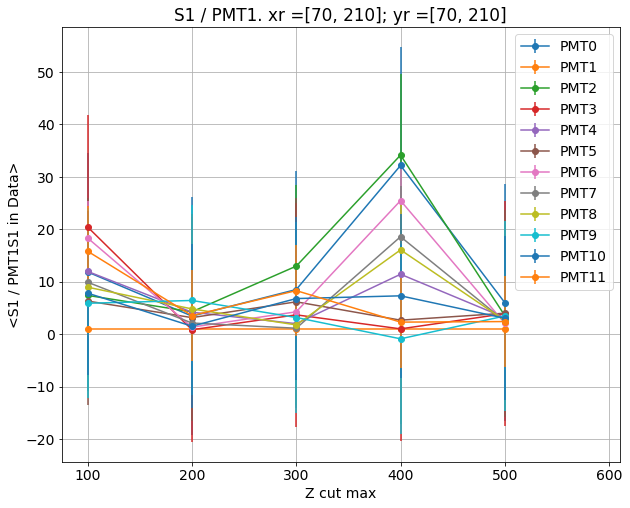

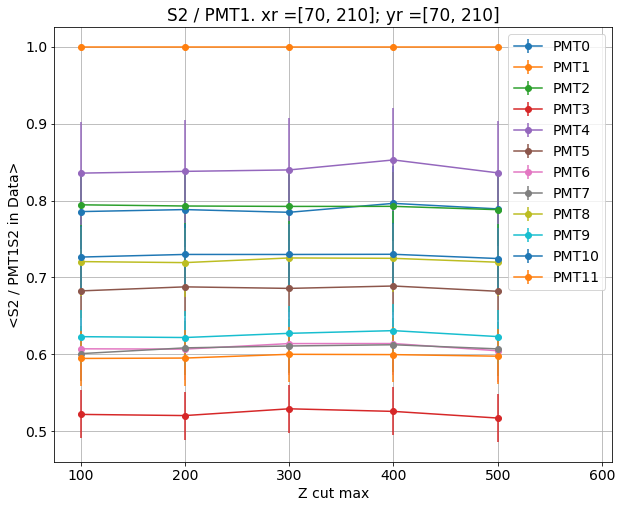

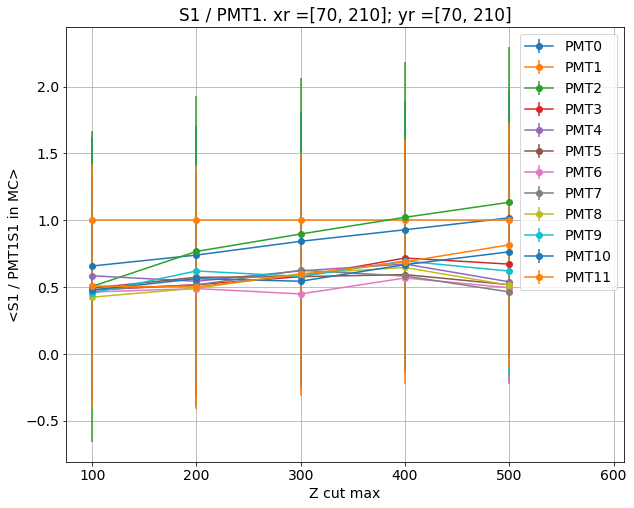

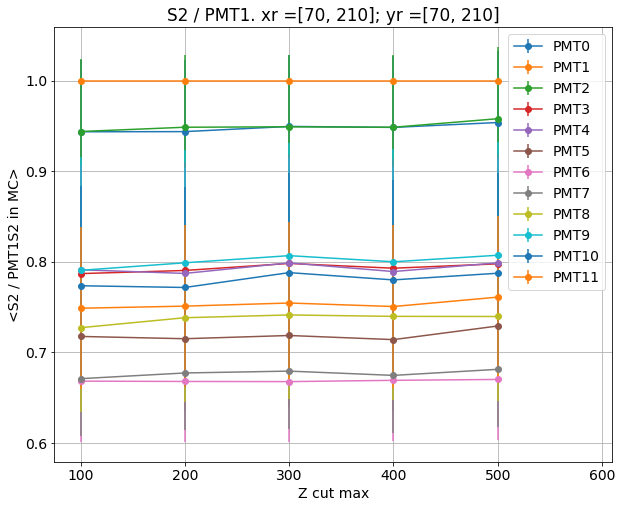

Dividing S2s
Dividing S1s


/Users/jmhaefner/miniconda/envs/IC-3.7-2018-11-14/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/Users/jmhaefner/miniconda/envs/IC-3.7-2018-11-14/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in multiply
  after removing the cwd from sys.path.


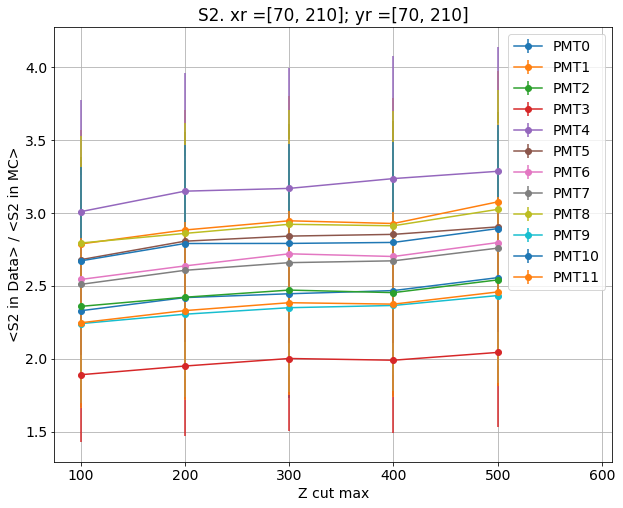

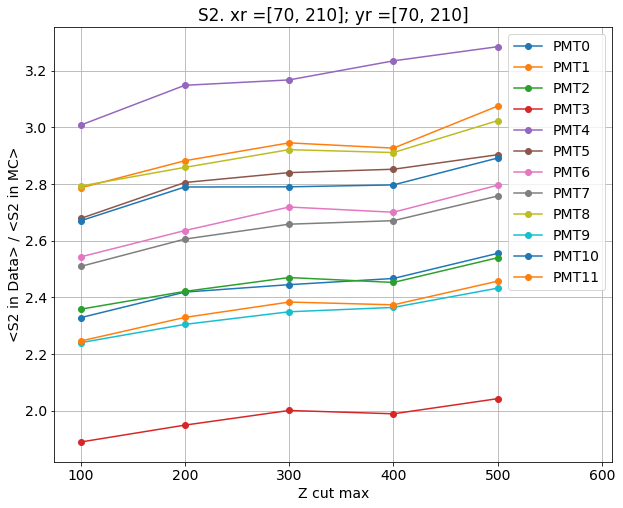

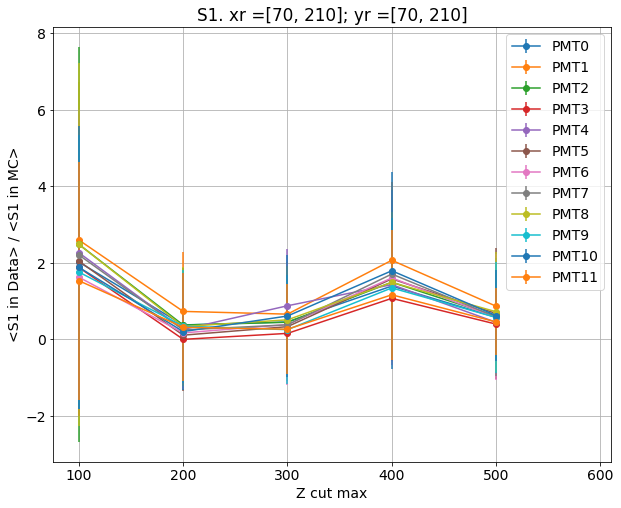

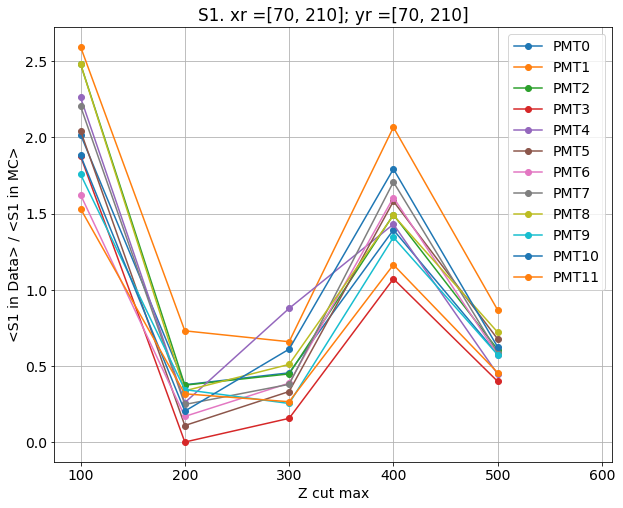

In [28]:
#xedges = [-210, -70]
xedges = [-210, -70, 70, 210]
xranges = [[xedges[i], xedges[i+1]] for i in range(len(xedges)-1)]

#yedges = [-70, 70]
yedges = [-210, -70, 70, 210]
yranges = [[yedges[i], yedges[i+1]] for i in range(len(yedges)-1)]

zcuts = [2, 100, 200, 300, 400, 500]
zranges = [[zcuts[i], zcuts[i+1]] for i in range(len(zcuts)-1)]

for xr, yr in itertools.product(xranges, yranges):
    print('xr =', xr, '; yr =', yr)

    print('calculating data...')
    data_s1avgs_ZPMT, data_s2avgs_ZPMT, data_s1vars, data_s2vars, data_s1avgs_ZPMT_vPMT1, data_s2avgs_ZPMT_vPMT1, data_s1vars_vPMT1, data_s2vars_vPMT1 = mean_signal_vsPMTZ(good_data_pmaps, xr, yr, zranges)
    print('Calculated S2 matrix =')
    print(data_s2avgs_ZPMT_vPMT1)
    print('calculating mc...')
    mc_s1avgs_ZPMT, mc_s2avgs_ZPMT, mc_s1vars, mc_s2vars, mc_s1avgs_ZPMT_vPMT1, mc_s2avgs_ZPMT_vPMT1, mc_s1vars_vPMT1, mc_s2vars_vPMT1 = mean_signal_vsPMTZ(good_mc_pmaps, xr, yr, zranges)

    print('Data S2')
    print(data_s2avgs_ZPMT)
    print('Data S1')
    print(data_s1avgs_ZPMT)
    print('MC S2')
    print(mc_s2avgs_ZPMT)
    print('MC S1')
    print(mc_s1avgs_ZPMT)
    
    ###########################################
    ### PLOTS BEFORE DIVISION, UNNORMALIZED ###
    ###########################################

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], data_s1avgs_ZPMT[pid], yerr = np.array(data_s1vars[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 in Data>')
    plt.xlim(75, 610)
    plt.title('S1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], data_s2avgs_ZPMT[pid], yerr = np.array(data_s2vars[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 in Data>')
    plt.xlim(75, 610)
    plt.title('S2. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], mc_s1avgs_ZPMT[pid], yerr = np.array(mc_s1vars[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 in MC>')
    plt.xlim(75, 610)
    plt.title('S1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], mc_s2avgs_ZPMT[pid], yerr = np.array(mc_s2vars[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 in MC>')
    plt.xlim(75, 610)
    plt.title('S2. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    ##############################################
    ### PLOTS BEFORE DIVISION, PMT1 NORMALIZED ###
    ##############################################

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], data_s1avgs_ZPMT_vPMT1[pid], yerr = np.array(data_s1vars_vPMT1[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 / PMT1S1 in Data>')
    plt.xlim(75, 610)
    plt.title('S1 / PMT1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], data_s2avgs_ZPMT_vPMT1[pid], yerr = np.array(data_s2vars_vPMT1[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 / PMT1S2 in Data>')
    plt.xlim(75, 610)
    plt.title('S2 / PMT1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], mc_s1avgs_ZPMT_vPMT1[pid], yerr = np.array(mc_s1vars_vPMT1[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 / PMT1S1 in MC>')
    plt.xlim(75, 610)
    plt.title('S1 / PMT1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], mc_s2avgs_ZPMT_vPMT1[pid], yerr = np.array(mc_s2vars_vPMT1[pid])**0.5, fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 / PMT1S2 in MC>')
    plt.xlim(75, 610)
    plt.title('S2 / PMT1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()
    
    # print('Data ZPMTs =', data_s2avgs_ZPMT)
    # print('MC ZPMTS   =', mc_s2avgs_ZPMT)
    
    ### DIVIDED PLOTS ###
    
    print('Dividing S2s')
    pmt_ratios_s2 = data_s2avgs_ZPMT / mc_s2avgs_ZPMT
    pmt_ratios_s2[pmt_ratios_s2 == np.inf] = 0

    print('Dividing S1s')                
    pmt_ratios_s1 = data_s1avgs_ZPMT / mc_s1avgs_ZPMT
    pmt_ratios_s1[pmt_ratios_s1 == np.inf] = 0
    
    pmt_ratios_s1_err = varfrac(data_s1avgs_ZPMT, mc_s1avgs_ZPMT, data_s1vars, mc_s1vars)**0.5
    pmt_ratios_s2_err = varfrac(data_s2avgs_ZPMT, mc_s2avgs_ZPMT, data_s2vars, mc_s2vars)**0.5
    
    ## PLOT WITH ERROR BARS ###
    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], pmt_ratios_s2[pid], yerr = pmt_ratios_s2_err[pid], fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 in Data> / <S2 in MC>')
    plt.xlim(75, 610)
    plt.title('S2. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()
    
    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], pmt_ratios_s2[pid], fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S2 in Data> / <S2 in MC>')
    plt.xlim(75, 610)
    plt.title('S2. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()

    ### PLOT WITHOUT ERROR BARS ###
    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], pmt_ratios_s1[pid], yerr = pmt_ratios_s1_err[pid], fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 in Data> / <S1 in MC>')
    plt.xlim(75, 610)
    plt.title('S1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()
    
    for pid in pmt_ids:
        plt.errorbar(zcuts[1:], pmt_ratios_s1[pid], fmt = 'o-', label = 'PMT'+str(pid))
    plt.grid()
    plt.xlabel('Z cut max')
    plt.ylabel('<S1 in Data> / <S1 in MC>')
    plt.xlim(75, 610)
    plt.title('S1. xr ='+str(xr)+'; yr ='+str(yr))
    plt.legend(loc = 'upper right')
    plt.show()